# Afriat

In [1]:
import warnings
import os
import sys
import gc
import warnings

In [2]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [3]:
torch.cuda.is_available()

False

In [4]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [5]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [6]:
asdp_1 = adata.X.sum()

In [7]:
ratio_true=0.93

from tardis._utils.functions import create_random_mask
mask = create_random_mask(adata.shape[1], ratio_true=ratio_true, seed=2024)
adata.X[:, mask] = 0.0

In [8]:
asdp_2 = adata.X.sum()

In [9]:
mask.sum()/adata.shape[1],  1-asdp_2/asdp_1

(0.9278, 0.9256399422883987)

In [10]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [11]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [12]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_ablation_{ratio_true}"
)

vae.save(
    dir_path,
    overwrite=True,
)

W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_figures
ID: mhjihbc6
Name: lucky-yogurt-133
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_figures/runs/mhjihbc6
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240503_120427-mhjihbc6/files



GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "
SLURM auto-requeueing enabled. Setting signal handlers.


Training:   0%|                                                                                                                                                                                                                                 | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|                                                                                                                                                                                                                              | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2555,3259,9429
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2555,2540,1681,3435,1638,3394
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4488,10755
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 650,850,2310
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 650,662,427,855,411,805
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1096,2714
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|▎                                                                                                                                                                                                                   | 1/600 [00:13<2:10:44, 13.10s/it]

Epoch 1/600:   0%|▎                                                                                                                                                            | 1/600 [00:13<2:10:44, 13.10s/it, v_num=c6_1, total_loss_train=432, kl_local_train=33.6]

Epoch 2/600:   0%|▎                                                                                                                                                            | 1/600 [00:13<2:10:44, 13.10s/it, v_num=c6_1, total_loss_train=432, kl_local_train=33.6]

Epoch 2/600:   0%|▌                                                                                                                                                            | 2/600 [00:25<2:04:19, 12.47s/it, v_num=c6_1, total_loss_train=432, kl_local_train=33.6]

Epoch 2/600:   0%|▌                                                                                                                                                            | 2/600 [00:25<2:04:19, 12.47s/it, v_num=c6_1, total_loss_train=261, kl_local_train=48.6]

Epoch 3/600:   0%|▌                                                                                                                                                            | 2/600 [00:25<2:04:19, 12.47s/it, v_num=c6_1, total_loss_train=261, kl_local_train=48.6]

Epoch 3/600:   0%|▊                                                                                                                                                            | 3/600 [00:36<2:00:43, 12.13s/it, v_num=c6_1, total_loss_train=261, kl_local_train=48.6]

Epoch 3/600:   0%|▊                                                                                                                                                            | 3/600 [00:36<2:00:43, 12.13s/it, v_num=c6_1, total_loss_train=247, kl_local_train=46.1]

Epoch 4/600:   0%|▊                                                                                                                                                            | 3/600 [00:36<2:00:43, 12.13s/it, v_num=c6_1, total_loss_train=247, kl_local_train=46.1]

Epoch 4/600:   1%|█                                                                                                                                                            | 4/600 [00:48<1:59:45, 12.06s/it, v_num=c6_1, total_loss_train=247, kl_local_train=46.1]

Epoch 4/600:   1%|█                                                                                                                                                            | 4/600 [00:48<1:59:45, 12.06s/it, v_num=c6_1, total_loss_train=243, kl_local_train=38.9]

Epoch 5/600:   1%|█                                                                                                                                                            | 4/600 [00:48<1:59:45, 12.06s/it, v_num=c6_1, total_loss_train=243, kl_local_train=38.9]

Epoch 5/600:   1%|█▎                                                                                                                                                           | 5/600 [01:01<2:00:14, 12.13s/it, v_num=c6_1, total_loss_train=243, kl_local_train=38.9]

Epoch 5/600:   1%|█▎                                                                                                                                                           | 5/600 [01:01<2:00:14, 12.13s/it, v_num=c6_1, total_loss_train=241, kl_local_train=30.3]

Epoch 6/600:   1%|█▎                                                                                                                                                           | 5/600 [01:02<2:00:14, 12.13s/it, v_num=c6_1, total_loss_train=241, kl_local_train=30.3]

Epoch 6/600:   1%|█▌                                                                                                                                                           | 6/600 [01:13<2:02:35, 12.38s/it, v_num=c6_1, total_loss_train=241, kl_local_train=30.3]

Epoch 6/600:   1%|▎                        | 6/600 [01:13<2:02:35, 12.38s/it, v_num=c6_1, total_loss_train=240, kl_local_train=21.8, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00726, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0353]

Epoch 7/600:   1%|▎                        | 6/600 [01:13<2:02:35, 12.38s/it, v_num=c6_1, total_loss_train=240, kl_local_train=21.8, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00726, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0353]

Epoch 7/600:   1%|▎                        | 7/600 [01:25<2:00:16, 12.17s/it, v_num=c6_1, total_loss_train=240, kl_local_train=21.8, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00726, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0353]

Epoch 7/600:   1%|▎                        | 7/600 [01:25<2:00:16, 12.17s/it, v_num=c6_1, total_loss_train=240, kl_local_train=15.6, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00726, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0353]

Epoch 8/600:   1%|▎                        | 7/600 [01:25<2:00:16, 12.17s/it, v_num=c6_1, total_loss_train=240, kl_local_train=15.6, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00726, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0353]

Epoch 8/600:   1%|▎                        | 8/600 [01:37<1:57:46, 11.94s/it, v_num=c6_1, total_loss_train=240, kl_local_train=15.6, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00726, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0353]

Epoch 8/600:   1%|▎                        | 8/600 [01:37<1:57:46, 11.94s/it, v_num=c6_1, total_loss_train=247, kl_local_train=11.1, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00726, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0353]

Epoch 9/600:   1%|▎                        | 8/600 [01:37<1:57:46, 11.94s/it, v_num=c6_1, total_loss_train=247, kl_local_train=11.1, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00726, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0353]

Epoch 9/600:   2%|▍                        | 9/600 [01:48<1:56:39, 11.84s/it, v_num=c6_1, total_loss_train=247, kl_local_train=11.1, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00726, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0353]

Epoch 9/600:   2%|▍                        | 9/600 [01:48<1:56:39, 11.84s/it, v_num=c6_1, total_loss_train=254, kl_local_train=10.3, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00726, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0353]

Epoch 10/600:   2%|▎                       | 9/600 [01:48<1:56:39, 11.84s/it, v_num=c6_1, total_loss_train=254, kl_local_train=10.3, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00726, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0353]

Epoch 10/600:   2%|▍                      | 10/600 [02:00<1:56:02, 11.80s/it, v_num=c6_1, total_loss_train=254, kl_local_train=10.3, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00726, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0353]

Epoch 10/600:   2%|▍                      | 10/600 [02:00<1:56:02, 11.80s/it, v_num=c6_1, total_loss_train=262, kl_local_train=12.3, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00726, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0353]

Epoch 11/600:   2%|▍                      | 10/600 [02:01<1:56:02, 11.80s/it, v_num=c6_1, total_loss_train=262, kl_local_train=12.3, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00726, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0353]

Epoch 11/600:   2%|▍                      | 11/600 [02:13<1:59:08, 12.14s/it, v_num=c6_1, total_loss_train=262, kl_local_train=12.3, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00726, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0353]

Epoch 11/600:   2%|▍                        | 11/600 [02:13<1:59:08, 12.14s/it, v_num=c6_1, total_loss_train=268, kl_local_train=42, metric_mi|status_control_train=0.0204, metric_mi|zone_train=0.00813, metric_mi|time_cat_train=0.0139, metric_mi|mouse_train=0.0362]

Epoch 12/600:   2%|▍                        | 11/600 [02:13<1:59:08, 12.14s/it, v_num=c6_1, total_loss_train=268, kl_local_train=42, metric_mi|status_control_train=0.0204, metric_mi|zone_train=0.00813, metric_mi|time_cat_train=0.0139, metric_mi|mouse_train=0.0362]

Epoch 12/600:   2%|▌                        | 12/600 [02:24<1:57:12, 11.96s/it, v_num=c6_1, total_loss_train=268, kl_local_train=42, metric_mi|status_control_train=0.0204, metric_mi|zone_train=0.00813, metric_mi|time_cat_train=0.0139, metric_mi|mouse_train=0.0362]

Epoch 12/600:   2%|▍                      | 12/600 [02:24<1:57:12, 11.96s/it, v_num=c6_1, total_loss_train=270, kl_local_train=98.1, metric_mi|status_control_train=0.0204, metric_mi|zone_train=0.00813, metric_mi|time_cat_train=0.0139, metric_mi|mouse_train=0.0362]

Epoch 13/600:   2%|▍                      | 12/600 [02:24<1:57:12, 11.96s/it, v_num=c6_1, total_loss_train=270, kl_local_train=98.1, metric_mi|status_control_train=0.0204, metric_mi|zone_train=0.00813, metric_mi|time_cat_train=0.0139, metric_mi|mouse_train=0.0362]

Epoch 13/600:   2%|▍                      | 13/600 [02:36<1:55:50, 11.84s/it, v_num=c6_1, total_loss_train=270, kl_local_train=98.1, metric_mi|status_control_train=0.0204, metric_mi|zone_train=0.00813, metric_mi|time_cat_train=0.0139, metric_mi|mouse_train=0.0362]

Epoch 13/600:   2%|▌                       | 13/600 [02:36<1:55:50, 11.84s/it, v_num=c6_1, total_loss_train=272, kl_local_train=109, metric_mi|status_control_train=0.0204, metric_mi|zone_train=0.00813, metric_mi|time_cat_train=0.0139, metric_mi|mouse_train=0.0362]

Epoch 14/600:   2%|▌                       | 13/600 [02:36<1:55:50, 11.84s/it, v_num=c6_1, total_loss_train=272, kl_local_train=109, metric_mi|status_control_train=0.0204, metric_mi|zone_train=0.00813, metric_mi|time_cat_train=0.0139, metric_mi|mouse_train=0.0362]

Epoch 14/600:   2%|▌                       | 14/600 [02:47<1:54:17, 11.70s/it, v_num=c6_1, total_loss_train=272, kl_local_train=109, metric_mi|status_control_train=0.0204, metric_mi|zone_train=0.00813, metric_mi|time_cat_train=0.0139, metric_mi|mouse_train=0.0362]

Epoch 14/600:   2%|▌                       | 14/600 [02:47<1:54:17, 11.70s/it, v_num=c6_1, total_loss_train=276, kl_local_train=103, metric_mi|status_control_train=0.0204, metric_mi|zone_train=0.00813, metric_mi|time_cat_train=0.0139, metric_mi|mouse_train=0.0362]

Epoch 15/600:   2%|▌                       | 14/600 [02:47<1:54:17, 11.70s/it, v_num=c6_1, total_loss_train=276, kl_local_train=103, metric_mi|status_control_train=0.0204, metric_mi|zone_train=0.00813, metric_mi|time_cat_train=0.0139, metric_mi|mouse_train=0.0362]

Epoch 15/600:   2%|▌                       | 15/600 [02:59<1:53:42, 11.66s/it, v_num=c6_1, total_loss_train=276, kl_local_train=103, metric_mi|status_control_train=0.0204, metric_mi|zone_train=0.00813, metric_mi|time_cat_train=0.0139, metric_mi|mouse_train=0.0362]

Epoch 15/600:   2%|▌                       | 15/600 [02:59<1:53:42, 11.66s/it, v_num=c6_1, total_loss_train=280, kl_local_train=104, metric_mi|status_control_train=0.0204, metric_mi|zone_train=0.00813, metric_mi|time_cat_train=0.0139, metric_mi|mouse_train=0.0362]

Epoch 16/600:   2%|▌                       | 15/600 [03:00<1:53:42, 11.66s/it, v_num=c6_1, total_loss_train=280, kl_local_train=104, metric_mi|status_control_train=0.0204, metric_mi|zone_train=0.00813, metric_mi|time_cat_train=0.0139, metric_mi|mouse_train=0.0362]

Epoch 16/600:   3%|▋                       | 16/600 [03:12<1:56:27, 11.96s/it, v_num=c6_1, total_loss_train=280, kl_local_train=104, metric_mi|status_control_train=0.0204, metric_mi|zone_train=0.00813, metric_mi|time_cat_train=0.0139, metric_mi|mouse_train=0.0362]

Epoch 16/600:   3%|▋                          | 16/600 [03:12<1:56:27, 11.96s/it, v_num=c6_1, total_loss_train=284, kl_local_train=109, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.0926, metric_mi|mouse_train=0.0845]

Epoch 17/600:   3%|▋                          | 16/600 [03:12<1:56:27, 11.96s/it, v_num=c6_1, total_loss_train=284, kl_local_train=109, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.0926, metric_mi|mouse_train=0.0845]

Epoch 17/600:   3%|▊                          | 17/600 [03:23<1:54:32, 11.79s/it, v_num=c6_1, total_loss_train=284, kl_local_train=109, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.0926, metric_mi|mouse_train=0.0845]

Epoch 17/600:   3%|▊                          | 17/600 [03:23<1:54:32, 11.79s/it, v_num=c6_1, total_loss_train=287, kl_local_train=123, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.0926, metric_mi|mouse_train=0.0845]

Epoch 18/600:   3%|▊                          | 17/600 [03:23<1:54:32, 11.79s/it, v_num=c6_1, total_loss_train=287, kl_local_train=123, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.0926, metric_mi|mouse_train=0.0845]

Epoch 18/600:   3%|▊                          | 18/600 [03:34<1:52:48, 11.63s/it, v_num=c6_1, total_loss_train=287, kl_local_train=123, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.0926, metric_mi|mouse_train=0.0845]

Epoch 18/600:   3%|▊                          | 18/600 [03:34<1:52:48, 11.63s/it, v_num=c6_1, total_loss_train=290, kl_local_train=139, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.0926, metric_mi|mouse_train=0.0845]

Epoch 19/600:   3%|▊                          | 18/600 [03:34<1:52:48, 11.63s/it, v_num=c6_1, total_loss_train=290, kl_local_train=139, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.0926, metric_mi|mouse_train=0.0845]

Epoch 19/600:   3%|▊                          | 19/600 [03:45<1:51:30, 11.52s/it, v_num=c6_1, total_loss_train=290, kl_local_train=139, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.0926, metric_mi|mouse_train=0.0845]

Epoch 19/600:   3%|▊                          | 19/600 [03:45<1:51:30, 11.52s/it, v_num=c6_1, total_loss_train=293, kl_local_train=145, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.0926, metric_mi|mouse_train=0.0845]

Epoch 20/600:   3%|▊                          | 19/600 [03:45<1:51:30, 11.52s/it, v_num=c6_1, total_loss_train=293, kl_local_train=145, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.0926, metric_mi|mouse_train=0.0845]

Epoch 20/600:   3%|▉                          | 20/600 [03:57<1:50:50, 11.47s/it, v_num=c6_1, total_loss_train=293, kl_local_train=145, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.0926, metric_mi|mouse_train=0.0845]

Epoch 20/600:   3%|▉                          | 20/600 [03:57<1:50:50, 11.47s/it, v_num=c6_1, total_loss_train=297, kl_local_train=147, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.0926, metric_mi|mouse_train=0.0845]

Epoch 21/600:   3%|▉                          | 20/600 [03:58<1:50:50, 11.47s/it, v_num=c6_1, total_loss_train=297, kl_local_train=147, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.0926, metric_mi|mouse_train=0.0845]

Epoch 21/600:   4%|▉                          | 21/600 [04:09<1:53:57, 11.81s/it, v_num=c6_1, total_loss_train=297, kl_local_train=147, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.0926, metric_mi|mouse_train=0.0845]

Epoch 21/600:   4%|█                            | 21/600 [04:09<1:53:57, 11.81s/it, v_num=c6_1, total_loss_train=300, kl_local_train=145, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.133]

Epoch 22/600:   4%|█                            | 21/600 [04:09<1:53:57, 11.81s/it, v_num=c6_1, total_loss_train=300, kl_local_train=145, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.133]

Epoch 22/600:   4%|█                            | 22/600 [04:21<1:52:30, 11.68s/it, v_num=c6_1, total_loss_train=300, kl_local_train=145, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.133]

Epoch 22/600:   4%|█                            | 22/600 [04:21<1:52:30, 11.68s/it, v_num=c6_1, total_loss_train=304, kl_local_train=144, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.133]

Epoch 23/600:   4%|█                            | 22/600 [04:21<1:52:30, 11.68s/it, v_num=c6_1, total_loss_train=304, kl_local_train=144, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.133]

Epoch 23/600:   4%|█                            | 23/600 [04:32<1:51:24, 11.59s/it, v_num=c6_1, total_loss_train=304, kl_local_train=144, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.133]

Epoch 23/600:   4%|█                            | 23/600 [04:32<1:51:24, 11.59s/it, v_num=c6_1, total_loss_train=308, kl_local_train=144, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.133]

Epoch 24/600:   4%|█                            | 23/600 [04:32<1:51:24, 11.59s/it, v_num=c6_1, total_loss_train=308, kl_local_train=144, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.133]

Epoch 24/600:   4%|█▏                           | 24/600 [04:44<1:51:37, 11.63s/it, v_num=c6_1, total_loss_train=308, kl_local_train=144, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.133]

Epoch 24/600:   4%|█▏                           | 24/600 [04:44<1:51:37, 11.63s/it, v_num=c6_1, total_loss_train=312, kl_local_train=147, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.133]

Epoch 25/600:   4%|█▏                           | 24/600 [04:44<1:51:37, 11.63s/it, v_num=c6_1, total_loss_train=312, kl_local_train=147, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.133]

Epoch 25/600:   4%|█▏                           | 25/600 [04:56<1:51:53, 11.68s/it, v_num=c6_1, total_loss_train=312, kl_local_train=147, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.133]

Epoch 25/600:   4%|█▏                           | 25/600 [04:56<1:51:53, 11.68s/it, v_num=c6_1, total_loss_train=316, kl_local_train=148, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.133]

Epoch 26/600:   4%|█▏                           | 25/600 [04:57<1:51:53, 11.68s/it, v_num=c6_1, total_loss_train=316, kl_local_train=148, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.133]

Epoch 26/600:   4%|█▎                           | 26/600 [05:09<1:55:40, 12.09s/it, v_num=c6_1, total_loss_train=316, kl_local_train=148, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.133]

Epoch 26/600:   4%|█▎                           | 26/600 [05:09<1:55:40, 12.09s/it, v_num=c6_1, total_loss_train=320, kl_local_train=147, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 27/600:   4%|█▎                           | 26/600 [05:09<1:55:40, 12.09s/it, v_num=c6_1, total_loss_train=320, kl_local_train=147, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 27/600:   4%|█▎                           | 27/600 [05:20<1:54:00, 11.94s/it, v_num=c6_1, total_loss_train=320, kl_local_train=147, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 27/600:   4%|█▎                           | 27/600 [05:20<1:54:00, 11.94s/it, v_num=c6_1, total_loss_train=324, kl_local_train=148, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 28/600:   4%|█▎                           | 27/600 [05:20<1:54:00, 11.94s/it, v_num=c6_1, total_loss_train=324, kl_local_train=148, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 28/600:   5%|█▎                           | 28/600 [05:32<1:52:41, 11.82s/it, v_num=c6_1, total_loss_train=324, kl_local_train=148, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 28/600:   5%|█▎                           | 28/600 [05:32<1:52:41, 11.82s/it, v_num=c6_1, total_loss_train=328, kl_local_train=149, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 29/600:   5%|█▎                           | 28/600 [05:32<1:52:41, 11.82s/it, v_num=c6_1, total_loss_train=328, kl_local_train=149, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 29/600:   5%|█▍                           | 29/600 [05:43<1:51:26, 11.71s/it, v_num=c6_1, total_loss_train=328, kl_local_train=149, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 29/600:   5%|█▍                           | 29/600 [05:43<1:51:26, 11.71s/it, v_num=c6_1, total_loss_train=332, kl_local_train=153, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 30/600:   5%|█▍                           | 29/600 [05:43<1:51:26, 11.71s/it, v_num=c6_1, total_loss_train=332, kl_local_train=153, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 30/600:   5%|█▍                           | 30/600 [05:55<1:50:53, 11.67s/it, v_num=c6_1, total_loss_train=332, kl_local_train=153, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 30/600:   5%|█▍                           | 30/600 [05:55<1:50:53, 11.67s/it, v_num=c6_1, total_loss_train=336, kl_local_train=153, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 31/600:   5%|█▍                           | 30/600 [05:56<1:50:53, 11.67s/it, v_num=c6_1, total_loss_train=336, kl_local_train=153, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 31/600:   5%|█▍                           | 31/600 [06:08<1:54:01, 12.02s/it, v_num=c6_1, total_loss_train=336, kl_local_train=153, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 31/600:   5%|█▌                            | 31/600 [06:08<1:54:01, 12.02s/it, v_num=c6_1, total_loss_train=341, kl_local_train=154, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 32/600:   5%|█▌                            | 31/600 [06:08<1:54:01, 12.02s/it, v_num=c6_1, total_loss_train=341, kl_local_train=154, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 32/600:   5%|█▌                            | 32/600 [06:19<1:52:32, 11.89s/it, v_num=c6_1, total_loss_train=341, kl_local_train=154, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 32/600:   5%|█▌                            | 32/600 [06:19<1:52:32, 11.89s/it, v_num=c6_1, total_loss_train=345, kl_local_train=153, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 33/600:   5%|█▌                            | 32/600 [06:19<1:52:32, 11.89s/it, v_num=c6_1, total_loss_train=345, kl_local_train=153, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 33/600:   6%|█▋                            | 33/600 [06:31<1:51:36, 11.81s/it, v_num=c6_1, total_loss_train=345, kl_local_train=153, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 33/600:   6%|█▋                            | 33/600 [06:31<1:51:36, 11.81s/it, v_num=c6_1, total_loss_train=349, kl_local_train=156, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 34/600:   6%|█▋                            | 33/600 [06:31<1:51:36, 11.81s/it, v_num=c6_1, total_loss_train=349, kl_local_train=156, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 34/600:   6%|█▋                            | 34/600 [06:43<1:51:03, 11.77s/it, v_num=c6_1, total_loss_train=349, kl_local_train=156, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 34/600:   6%|█▋                            | 34/600 [06:43<1:51:03, 11.77s/it, v_num=c6_1, total_loss_train=353, kl_local_train=158, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 35/600:   6%|█▋                            | 34/600 [06:43<1:51:03, 11.77s/it, v_num=c6_1, total_loss_train=353, kl_local_train=158, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 35/600:   6%|█▊                            | 35/600 [06:54<1:50:36, 11.75s/it, v_num=c6_1, total_loss_train=353, kl_local_train=158, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 35/600:   6%|█▊                            | 35/600 [06:54<1:50:36, 11.75s/it, v_num=c6_1, total_loss_train=357, kl_local_train=155, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 36/600:   6%|█▊                            | 35/600 [06:56<1:50:36, 11.75s/it, v_num=c6_1, total_loss_train=357, kl_local_train=155, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 36/600:   6%|█▊                            | 36/600 [07:07<1:53:48, 12.11s/it, v_num=c6_1, total_loss_train=357, kl_local_train=155, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 36/600:   6%|█▊                            | 36/600 [07:07<1:53:48, 12.11s/it, v_num=c6_1, total_loss_train=361, kl_local_train=155, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.142]

Epoch 37/600:   6%|█▊                            | 36/600 [07:07<1:53:48, 12.11s/it, v_num=c6_1, total_loss_train=361, kl_local_train=155, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.142]

Epoch 37/600:   6%|█▊                            | 37/600 [07:19<1:51:41, 11.90s/it, v_num=c6_1, total_loss_train=361, kl_local_train=155, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.142]

Epoch 37/600:   6%|█▊                            | 37/600 [07:19<1:51:41, 11.90s/it, v_num=c6_1, total_loss_train=365, kl_local_train=155, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.142]

Epoch 38/600:   6%|█▊                            | 37/600 [07:19<1:51:41, 11.90s/it, v_num=c6_1, total_loss_train=365, kl_local_train=155, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.142]

Epoch 38/600:   6%|█▉                            | 38/600 [07:30<1:49:58, 11.74s/it, v_num=c6_1, total_loss_train=365, kl_local_train=155, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.142]

Epoch 38/600:   6%|█▉                            | 38/600 [07:30<1:49:58, 11.74s/it, v_num=c6_1, total_loss_train=369, kl_local_train=156, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.142]

Epoch 39/600:   6%|█▉                            | 38/600 [07:30<1:49:58, 11.74s/it, v_num=c6_1, total_loss_train=369, kl_local_train=156, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.142]

Epoch 39/600:   6%|█▉                            | 39/600 [07:42<1:48:58, 11.66s/it, v_num=c6_1, total_loss_train=369, kl_local_train=156, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.142]

Epoch 39/600:   6%|█▉                            | 39/600 [07:42<1:48:58, 11.66s/it, v_num=c6_1, total_loss_train=373, kl_local_train=155, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.142]

Epoch 40/600:   6%|█▉                            | 39/600 [07:42<1:48:58, 11.66s/it, v_num=c6_1, total_loss_train=373, kl_local_train=155, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.142]

Epoch 40/600:   7%|██                            | 40/600 [07:53<1:48:07, 11.59s/it, v_num=c6_1, total_loss_train=373, kl_local_train=155, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.142]

Epoch 40/600:   7%|██                            | 40/600 [07:53<1:48:07, 11.59s/it, v_num=c6_1, total_loss_train=377, kl_local_train=156, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.142]

Epoch 41/600:   7%|██                            | 40/600 [07:54<1:48:07, 11.59s/it, v_num=c6_1, total_loss_train=377, kl_local_train=156, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.142]

Epoch 41/600:   7%|██                            | 41/600 [08:06<1:50:55, 11.91s/it, v_num=c6_1, total_loss_train=377, kl_local_train=156, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.142]

Epoch 41/600:   7%|██                             | 41/600 [08:06<1:50:55, 11.91s/it, v_num=c6_1, total_loss_train=381, kl_local_train=159, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 42/600:   7%|██                             | 41/600 [08:06<1:50:55, 11.91s/it, v_num=c6_1, total_loss_train=381, kl_local_train=159, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 42/600:   7%|██▏                            | 42/600 [08:17<1:49:20, 11.76s/it, v_num=c6_1, total_loss_train=381, kl_local_train=159, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 42/600:   7%|██▏                            | 42/600 [08:17<1:49:20, 11.76s/it, v_num=c6_1, total_loss_train=386, kl_local_train=160, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 43/600:   7%|██▏                            | 42/600 [08:17<1:49:20, 11.76s/it, v_num=c6_1, total_loss_train=386, kl_local_train=160, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 43/600:   7%|██▏                            | 43/600 [08:28<1:48:04, 11.64s/it, v_num=c6_1, total_loss_train=386, kl_local_train=160, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 43/600:   7%|██▏                            | 43/600 [08:28<1:48:04, 11.64s/it, v_num=c6_1, total_loss_train=390, kl_local_train=159, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 44/600:   7%|██▏                            | 43/600 [08:28<1:48:04, 11.64s/it, v_num=c6_1, total_loss_train=390, kl_local_train=159, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 44/600:   7%|██▎                            | 44/600 [08:40<1:47:06, 11.56s/it, v_num=c6_1, total_loss_train=390, kl_local_train=159, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 44/600:   7%|██▎                            | 44/600 [08:40<1:47:06, 11.56s/it, v_num=c6_1, total_loss_train=394, kl_local_train=159, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 45/600:   7%|██▎                            | 44/600 [08:40<1:47:06, 11.56s/it, v_num=c6_1, total_loss_train=394, kl_local_train=159, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 45/600:   8%|██▎                            | 45/600 [08:51<1:46:50, 11.55s/it, v_num=c6_1, total_loss_train=394, kl_local_train=159, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 45/600:   8%|██▎                            | 45/600 [08:51<1:46:50, 11.55s/it, v_num=c6_1, total_loss_train=398, kl_local_train=162, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 46/600:   8%|██▎                            | 45/600 [08:53<1:46:50, 11.55s/it, v_num=c6_1, total_loss_train=398, kl_local_train=162, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 46/600:   8%|██▍                            | 46/600 [09:04<1:49:44, 11.89s/it, v_num=c6_1, total_loss_train=398, kl_local_train=162, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 46/600:   8%|██▏                          | 46/600 [09:04<1:49:44, 11.89s/it, v_num=c6_1, total_loss_train=402, kl_local_train=162, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 47/600:   8%|██▏                          | 46/600 [09:04<1:49:44, 11.89s/it, v_num=c6_1, total_loss_train=402, kl_local_train=162, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 47/600:   8%|██▎                          | 47/600 [09:15<1:48:11, 11.74s/it, v_num=c6_1, total_loss_train=402, kl_local_train=162, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 47/600:   8%|██▎                          | 47/600 [09:15<1:48:11, 11.74s/it, v_num=c6_1, total_loss_train=406, kl_local_train=165, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 48/600:   8%|██▎                          | 47/600 [09:15<1:48:11, 11.74s/it, v_num=c6_1, total_loss_train=406, kl_local_train=165, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 48/600:   8%|██▎                          | 48/600 [09:27<1:47:05, 11.64s/it, v_num=c6_1, total_loss_train=406, kl_local_train=165, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 48/600:   8%|██▎                          | 48/600 [09:27<1:47:05, 11.64s/it, v_num=c6_1, total_loss_train=410, kl_local_train=162, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 49/600:   8%|██▎                          | 48/600 [09:27<1:47:05, 11.64s/it, v_num=c6_1, total_loss_train=410, kl_local_train=162, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 49/600:   8%|██▎                          | 49/600 [09:38<1:46:11, 11.56s/it, v_num=c6_1, total_loss_train=410, kl_local_train=162, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 49/600:   8%|██▎                          | 49/600 [09:38<1:46:11, 11.56s/it, v_num=c6_1, total_loss_train=415, kl_local_train=163, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 50/600:   8%|██▎                          | 49/600 [09:38<1:46:11, 11.56s/it, v_num=c6_1, total_loss_train=415, kl_local_train=163, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 50/600:   8%|██▍                          | 50/600 [09:50<1:45:47, 11.54s/it, v_num=c6_1, total_loss_train=415, kl_local_train=163, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 50/600:   8%|██▍                          | 50/600 [09:50<1:45:47, 11.54s/it, v_num=c6_1, total_loss_train=419, kl_local_train=163, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 51/600:   8%|██▍                          | 50/600 [09:51<1:45:47, 11.54s/it, v_num=c6_1, total_loss_train=419, kl_local_train=163, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 51/600:   8%|██▍                          | 51/600 [10:02<1:48:37, 11.87s/it, v_num=c6_1, total_loss_train=419, kl_local_train=163, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 51/600:   8%|██▍                          | 51/600 [10:02<1:48:37, 11.87s/it, v_num=c6_1, total_loss_train=419, kl_local_train=162, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.144]

Epoch 52/600:   8%|██▍                          | 51/600 [10:02<1:48:37, 11.87s/it, v_num=c6_1, total_loss_train=419, kl_local_train=162, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.144]

Epoch 52/600:   9%|██▌                          | 52/600 [10:14<1:47:09, 11.73s/it, v_num=c6_1, total_loss_train=419, kl_local_train=162, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.144]

Epoch 52/600:   9%|██▌                          | 52/600 [10:14<1:47:09, 11.73s/it, v_num=c6_1, total_loss_train=419, kl_local_train=160, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.144]

Epoch 53/600:   9%|██▌                          | 52/600 [10:14<1:47:09, 11.73s/it, v_num=c6_1, total_loss_train=419, kl_local_train=160, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.144]

Epoch 53/600:   9%|██▌                          | 53/600 [10:25<1:46:03, 11.63s/it, v_num=c6_1, total_loss_train=419, kl_local_train=160, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.144]

Epoch 53/600:   9%|██▌                          | 53/600 [10:25<1:46:03, 11.63s/it, v_num=c6_1, total_loss_train=419, kl_local_train=158, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.144]

Epoch 54/600:   9%|██▌                          | 53/600 [10:25<1:46:03, 11.63s/it, v_num=c6_1, total_loss_train=419, kl_local_train=158, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.144]

Epoch 54/600:   9%|██▌                          | 54/600 [10:37<1:45:21, 11.58s/it, v_num=c6_1, total_loss_train=419, kl_local_train=158, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.144]

Epoch 54/600:   9%|██▌                          | 54/600 [10:37<1:45:21, 11.58s/it, v_num=c6_1, total_loss_train=419, kl_local_train=159, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.144]

Epoch 55/600:   9%|██▌                          | 54/600 [10:37<1:45:21, 11.58s/it, v_num=c6_1, total_loss_train=419, kl_local_train=159, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.144]

Epoch 55/600:   9%|██▋                          | 55/600 [10:48<1:44:53, 11.55s/it, v_num=c6_1, total_loss_train=419, kl_local_train=159, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.144]

Epoch 55/600:   9%|██▋                          | 55/600 [10:48<1:44:53, 11.55s/it, v_num=c6_1, total_loss_train=418, kl_local_train=156, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.144]

Epoch 56/600:   9%|██▋                          | 55/600 [10:49<1:44:53, 11.55s/it, v_num=c6_1, total_loss_train=418, kl_local_train=156, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.144]

Epoch 56/600:   9%|██▋                          | 56/600 [11:01<1:47:44, 11.88s/it, v_num=c6_1, total_loss_train=418, kl_local_train=156, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.144]

Epoch 56/600:   9%|██▋                          | 56/600 [11:01<1:47:44, 11.88s/it, v_num=c6_1, total_loss_train=419, kl_local_train=151, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 57/600:   9%|██▋                          | 56/600 [11:01<1:47:44, 11.88s/it, v_num=c6_1, total_loss_train=419, kl_local_train=151, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 57/600:  10%|██▊                          | 57/600 [11:12<1:46:24, 11.76s/it, v_num=c6_1, total_loss_train=419, kl_local_train=151, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 57/600:  10%|██▊                          | 57/600 [11:12<1:46:24, 11.76s/it, v_num=c6_1, total_loss_train=419, kl_local_train=148, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 58/600:  10%|██▊                          | 57/600 [11:12<1:46:24, 11.76s/it, v_num=c6_1, total_loss_train=419, kl_local_train=148, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 58/600:  10%|██▊                          | 58/600 [11:24<1:45:18, 11.66s/it, v_num=c6_1, total_loss_train=419, kl_local_train=148, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 58/600:  10%|██▊                          | 58/600 [11:24<1:45:18, 11.66s/it, v_num=c6_1, total_loss_train=418, kl_local_train=148, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 59/600:  10%|██▊                          | 58/600 [11:24<1:45:18, 11.66s/it, v_num=c6_1, total_loss_train=418, kl_local_train=148, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 59/600:  10%|██▊                          | 59/600 [11:35<1:44:24, 11.58s/it, v_num=c6_1, total_loss_train=418, kl_local_train=148, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 59/600:  10%|██▊                          | 59/600 [11:35<1:44:24, 11.58s/it, v_num=c6_1, total_loss_train=418, kl_local_train=145, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 60/600:  10%|██▊                          | 59/600 [11:35<1:44:24, 11.58s/it, v_num=c6_1, total_loss_train=418, kl_local_train=145, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 60/600:  10%|██▉                          | 60/600 [11:46<1:43:59, 11.55s/it, v_num=c6_1, total_loss_train=418, kl_local_train=145, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 60/600:  10%|██▉                          | 60/600 [11:46<1:43:59, 11.55s/it, v_num=c6_1, total_loss_train=418, kl_local_train=145, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 61/600:  10%|██▉                          | 60/600 [11:48<1:43:59, 11.55s/it, v_num=c6_1, total_loss_train=418, kl_local_train=145, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 61/600:  10%|██▉                          | 61/600 [11:59<1:46:48, 11.89s/it, v_num=c6_1, total_loss_train=418, kl_local_train=145, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 61/600:  10%|██▉                          | 61/600 [11:59<1:46:48, 11.89s/it, v_num=c6_1, total_loss_train=418, kl_local_train=141, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 62/600:  10%|██▉                          | 61/600 [11:59<1:46:48, 11.89s/it, v_num=c6_1, total_loss_train=418, kl_local_train=141, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 62/600:  10%|██▉                          | 62/600 [12:11<1:45:35, 11.78s/it, v_num=c6_1, total_loss_train=418, kl_local_train=141, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 62/600:  10%|██▉                          | 62/600 [12:11<1:45:35, 11.78s/it, v_num=c6_1, total_loss_train=418, kl_local_train=141, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 63/600:  10%|██▉                          | 62/600 [12:11<1:45:35, 11.78s/it, v_num=c6_1, total_loss_train=418, kl_local_train=141, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 63/600:  10%|███                          | 63/600 [12:22<1:44:27, 11.67s/it, v_num=c6_1, total_loss_train=418, kl_local_train=141, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 63/600:  10%|███                          | 63/600 [12:22<1:44:27, 11.67s/it, v_num=c6_1, total_loss_train=419, kl_local_train=142, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 64/600:  10%|███                          | 63/600 [12:22<1:44:27, 11.67s/it, v_num=c6_1, total_loss_train=419, kl_local_train=142, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 64/600:  11%|███                          | 64/600 [12:33<1:43:33, 11.59s/it, v_num=c6_1, total_loss_train=419, kl_local_train=142, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 64/600:  11%|███                          | 64/600 [12:33<1:43:33, 11.59s/it, v_num=c6_1, total_loss_train=419, kl_local_train=142, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 65/600:  11%|███                          | 64/600 [12:33<1:43:33, 11.59s/it, v_num=c6_1, total_loss_train=419, kl_local_train=142, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 65/600:  11%|███▏                         | 65/600 [12:45<1:44:00, 11.66s/it, v_num=c6_1, total_loss_train=419, kl_local_train=142, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 65/600:  11%|███▏                         | 65/600 [12:45<1:44:00, 11.66s/it, v_num=c6_1, total_loss_train=419, kl_local_train=143, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 66/600:  11%|███▏                         | 65/600 [12:47<1:44:00, 11.66s/it, v_num=c6_1, total_loss_train=419, kl_local_train=143, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 66/600:  11%|███▏                         | 66/600 [12:58<1:46:49, 12.00s/it, v_num=c6_1, total_loss_train=419, kl_local_train=143, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.147]

Epoch 66/600:  11%|███▎                          | 66/600 [12:58<1:46:49, 12.00s/it, v_num=c6_1, total_loss_train=418, kl_local_train=141, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.148]

Epoch 67/600:  11%|███▎                          | 66/600 [12:58<1:46:49, 12.00s/it, v_num=c6_1, total_loss_train=418, kl_local_train=141, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.148]

Epoch 67/600:  11%|███▎                          | 67/600 [13:10<1:45:11, 11.84s/it, v_num=c6_1, total_loss_train=418, kl_local_train=141, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.148]

Epoch 67/600:  11%|███▎                          | 67/600 [13:10<1:45:11, 11.84s/it, v_num=c6_1, total_loss_train=418, kl_local_train=139, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.148]

Epoch 68/600:  11%|███▎                          | 67/600 [13:10<1:45:11, 11.84s/it, v_num=c6_1, total_loss_train=418, kl_local_train=139, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.148]

Epoch 68/600:  11%|███▍                          | 68/600 [13:21<1:44:05, 11.74s/it, v_num=c6_1, total_loss_train=418, kl_local_train=139, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.148]

Epoch 68/600:  11%|███▍                          | 68/600 [13:21<1:44:05, 11.74s/it, v_num=c6_1, total_loss_train=419, kl_local_train=139, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.148]

Epoch 69/600:  11%|███▍                          | 68/600 [13:21<1:44:05, 11.74s/it, v_num=c6_1, total_loss_train=419, kl_local_train=139, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.148]

Epoch 69/600:  12%|███▍                          | 69/600 [13:32<1:43:01, 11.64s/it, v_num=c6_1, total_loss_train=419, kl_local_train=139, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.148]

Epoch 69/600:  12%|███▍                          | 69/600 [13:32<1:43:01, 11.64s/it, v_num=c6_1, total_loss_train=419, kl_local_train=137, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.148]

Epoch 70/600:  12%|███▍                          | 69/600 [13:32<1:43:01, 11.64s/it, v_num=c6_1, total_loss_train=419, kl_local_train=137, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.148]

Epoch 70/600:  12%|███▌                          | 70/600 [13:44<1:42:10, 11.57s/it, v_num=c6_1, total_loss_train=419, kl_local_train=137, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.148]

Epoch 70/600:  12%|███▌                          | 70/600 [13:44<1:42:10, 11.57s/it, v_num=c6_1, total_loss_train=419, kl_local_train=135, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.148]

Epoch 71/600:  12%|███▌                          | 70/600 [13:45<1:42:10, 11.57s/it, v_num=c6_1, total_loss_train=419, kl_local_train=135, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.148]

Epoch 71/600:  12%|███▌                          | 71/600 [13:57<1:44:51, 11.89s/it, v_num=c6_1, total_loss_train=419, kl_local_train=135, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.148]

Epoch 71/600:  12%|███▌                          | 71/600 [13:57<1:44:51, 11.89s/it, v_num=c6_1, total_loss_train=419, kl_local_train=135, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.145]

Epoch 72/600:  12%|███▌                          | 71/600 [13:57<1:44:51, 11.89s/it, v_num=c6_1, total_loss_train=419, kl_local_train=135, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.145]

Epoch 72/600:  12%|███▌                          | 72/600 [14:08<1:44:12, 11.84s/it, v_num=c6_1, total_loss_train=419, kl_local_train=135, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.145]

Epoch 72/600:  12%|███▌                          | 72/600 [14:08<1:44:12, 11.84s/it, v_num=c6_1, total_loss_train=419, kl_local_train=132, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.145]

Epoch 73/600:  12%|███▌                          | 72/600 [14:08<1:44:12, 11.84s/it, v_num=c6_1, total_loss_train=419, kl_local_train=132, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.145]

Epoch 73/600:  12%|███▋                          | 73/600 [14:20<1:43:39, 11.80s/it, v_num=c6_1, total_loss_train=419, kl_local_train=132, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.145]

Epoch 73/600:  12%|███▋                          | 73/600 [14:20<1:43:39, 11.80s/it, v_num=c6_1, total_loss_train=419, kl_local_train=132, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.145]

Epoch 74/600:  12%|███▋                          | 73/600 [14:20<1:43:39, 11.80s/it, v_num=c6_1, total_loss_train=419, kl_local_train=132, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.145]

Epoch 74/600:  12%|███▋                          | 74/600 [14:31<1:42:40, 11.71s/it, v_num=c6_1, total_loss_train=419, kl_local_train=132, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.145]

Epoch 74/600:  12%|███▋                          | 74/600 [14:31<1:42:40, 11.71s/it, v_num=c6_1, total_loss_train=419, kl_local_train=131, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.145]

Epoch 75/600:  12%|███▋                          | 74/600 [14:31<1:42:40, 11.71s/it, v_num=c6_1, total_loss_train=419, kl_local_train=131, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.145]

Epoch 75/600:  12%|███▊                          | 75/600 [14:43<1:42:16, 11.69s/it, v_num=c6_1, total_loss_train=419, kl_local_train=131, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.145]

Epoch 75/600:  12%|███▊                          | 75/600 [14:43<1:42:16, 11.69s/it, v_num=c6_1, total_loss_train=419, kl_local_train=131, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.145]

Epoch 76/600:  12%|███▊                          | 75/600 [14:44<1:42:16, 11.69s/it, v_num=c6_1, total_loss_train=419, kl_local_train=131, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.145]

Epoch 76/600:  13%|███▊                          | 76/600 [14:56<1:45:46, 12.11s/it, v_num=c6_1, total_loss_train=419, kl_local_train=131, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.145]

Epoch 76/600:  13%|███▋                         | 76/600 [14:56<1:45:46, 12.11s/it, v_num=c6_1, total_loss_train=419, kl_local_train=131, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 77/600:  13%|███▋                         | 76/600 [14:56<1:45:46, 12.11s/it, v_num=c6_1, total_loss_train=419, kl_local_train=131, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 77/600:  13%|███▋                         | 77/600 [15:08<1:44:43, 12.02s/it, v_num=c6_1, total_loss_train=419, kl_local_train=131, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 77/600:  13%|███▋                         | 77/600 [15:08<1:44:43, 12.02s/it, v_num=c6_1, total_loss_train=419, kl_local_train=130, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 78/600:  13%|███▋                         | 77/600 [15:08<1:44:43, 12.02s/it, v_num=c6_1, total_loss_train=419, kl_local_train=130, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 78/600:  13%|███▊                         | 78/600 [15:20<1:43:58, 11.95s/it, v_num=c6_1, total_loss_train=419, kl_local_train=130, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 78/600:  13%|███▊                         | 78/600 [15:20<1:43:58, 11.95s/it, v_num=c6_1, total_loss_train=419, kl_local_train=130, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 79/600:  13%|███▊                         | 78/600 [15:20<1:43:58, 11.95s/it, v_num=c6_1, total_loss_train=419, kl_local_train=130, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 79/600:  13%|███▊                         | 79/600 [15:32<1:43:26, 11.91s/it, v_num=c6_1, total_loss_train=419, kl_local_train=130, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 79/600:  13%|███▊                         | 79/600 [15:32<1:43:26, 11.91s/it, v_num=c6_1, total_loss_train=419, kl_local_train=129, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 80/600:  13%|███▊                         | 79/600 [15:32<1:43:26, 11.91s/it, v_num=c6_1, total_loss_train=419, kl_local_train=129, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 80/600:  13%|███▊                         | 80/600 [15:43<1:42:58, 11.88s/it, v_num=c6_1, total_loss_train=419, kl_local_train=129, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 80/600:  13%|███▊                         | 80/600 [15:43<1:42:58, 11.88s/it, v_num=c6_1, total_loss_train=419, kl_local_train=128, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 81/600:  13%|███▊                         | 80/600 [15:45<1:42:58, 11.88s/it, v_num=c6_1, total_loss_train=419, kl_local_train=128, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 81/600:  14%|███▉                         | 81/600 [15:56<1:45:47, 12.23s/it, v_num=c6_1, total_loss_train=419, kl_local_train=128, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 81/600:  14%|███▉                         | 81/600 [15:56<1:45:47, 12.23s/it, v_num=c6_1, total_loss_train=419, kl_local_train=125, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 82/600:  14%|███▉                         | 81/600 [15:56<1:45:47, 12.23s/it, v_num=c6_1, total_loss_train=419, kl_local_train=125, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 82/600:  14%|███▉                         | 82/600 [16:08<1:44:27, 12.10s/it, v_num=c6_1, total_loss_train=419, kl_local_train=125, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 82/600:  14%|███▉                         | 82/600 [16:08<1:44:27, 12.10s/it, v_num=c6_1, total_loss_train=419, kl_local_train=125, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 83/600:  14%|███▉                         | 82/600 [16:08<1:44:27, 12.10s/it, v_num=c6_1, total_loss_train=419, kl_local_train=125, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 83/600:  14%|████                         | 83/600 [16:20<1:43:46, 12.04s/it, v_num=c6_1, total_loss_train=419, kl_local_train=125, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 83/600:  14%|████                         | 83/600 [16:20<1:43:46, 12.04s/it, v_num=c6_1, total_loss_train=419, kl_local_train=122, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 84/600:  14%|████                         | 83/600 [16:20<1:43:46, 12.04s/it, v_num=c6_1, total_loss_train=419, kl_local_train=122, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 84/600:  14%|████                         | 84/600 [16:32<1:42:54, 11.97s/it, v_num=c6_1, total_loss_train=419, kl_local_train=122, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 84/600:  14%|████                         | 84/600 [16:32<1:42:54, 11.97s/it, v_num=c6_1, total_loss_train=419, kl_local_train=124, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 85/600:  14%|████                         | 84/600 [16:32<1:42:54, 11.97s/it, v_num=c6_1, total_loss_train=419, kl_local_train=124, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 85/600:  14%|████                         | 85/600 [16:44<1:42:08, 11.90s/it, v_num=c6_1, total_loss_train=419, kl_local_train=124, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 85/600:  14%|████                         | 85/600 [16:44<1:42:08, 11.90s/it, v_num=c6_1, total_loss_train=419, kl_local_train=125, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 86/600:  14%|████                         | 85/600 [16:45<1:42:08, 11.90s/it, v_num=c6_1, total_loss_train=419, kl_local_train=125, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 86/600:  14%|████▏                        | 86/600 [16:57<1:44:55, 12.25s/it, v_num=c6_1, total_loss_train=419, kl_local_train=125, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 86/600:  14%|████▏                        | 86/600 [16:57<1:44:55, 12.25s/it, v_num=c6_1, total_loss_train=419, kl_local_train=122, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 87/600:  14%|████▏                        | 86/600 [16:57<1:44:55, 12.25s/it, v_num=c6_1, total_loss_train=419, kl_local_train=122, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 87/600:  14%|████▏                        | 87/600 [17:09<1:43:36, 12.12s/it, v_num=c6_1, total_loss_train=419, kl_local_train=122, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 87/600:  14%|████▏                        | 87/600 [17:09<1:43:36, 12.12s/it, v_num=c6_1, total_loss_train=419, kl_local_train=121, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 88/600:  14%|████▏                        | 87/600 [17:09<1:43:36, 12.12s/it, v_num=c6_1, total_loss_train=419, kl_local_train=121, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 88/600:  15%|████▎                        | 88/600 [17:20<1:42:38, 12.03s/it, v_num=c6_1, total_loss_train=419, kl_local_train=121, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 88/600:  15%|████▎                        | 88/600 [17:20<1:42:38, 12.03s/it, v_num=c6_1, total_loss_train=419, kl_local_train=122, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 89/600:  15%|████▎                        | 88/600 [17:20<1:42:38, 12.03s/it, v_num=c6_1, total_loss_train=419, kl_local_train=122, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 89/600:  15%|████▎                        | 89/600 [17:32<1:42:02, 11.98s/it, v_num=c6_1, total_loss_train=419, kl_local_train=122, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 89/600:  15%|████▎                        | 89/600 [17:32<1:42:02, 11.98s/it, v_num=c6_1, total_loss_train=419, kl_local_train=121, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 90/600:  15%|████▎                        | 89/600 [17:32<1:42:02, 11.98s/it, v_num=c6_1, total_loss_train=419, kl_local_train=121, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 90/600:  15%|████▎                        | 90/600 [17:44<1:41:30, 11.94s/it, v_num=c6_1, total_loss_train=419, kl_local_train=121, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 90/600:  15%|████▎                        | 90/600 [17:44<1:41:30, 11.94s/it, v_num=c6_1, total_loss_train=419, kl_local_train=120, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 91/600:  15%|████▎                        | 90/600 [17:45<1:41:30, 11.94s/it, v_num=c6_1, total_loss_train=419, kl_local_train=120, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 91/600:  15%|████▍                        | 91/600 [17:57<1:44:39, 12.34s/it, v_num=c6_1, total_loss_train=419, kl_local_train=120, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 91/600:  15%|████▋                          | 91/600 [17:57<1:44:39, 12.34s/it, v_num=c6_1, total_loss_train=419, kl_local_train=118, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.148]

Epoch 92/600:  15%|████▋                          | 91/600 [17:57<1:44:39, 12.34s/it, v_num=c6_1, total_loss_train=419, kl_local_train=118, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.148]

Epoch 92/600:  15%|████▊                          | 92/600 [18:09<1:43:15, 12.20s/it, v_num=c6_1, total_loss_train=419, kl_local_train=118, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.148]

Epoch 92/600:  15%|████▊                          | 92/600 [18:09<1:43:15, 12.20s/it, v_num=c6_1, total_loss_train=419, kl_local_train=119, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.148]

Epoch 93/600:  15%|████▊                          | 92/600 [18:09<1:43:15, 12.20s/it, v_num=c6_1, total_loss_train=419, kl_local_train=119, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.148]

Epoch 93/600:  16%|████▊                          | 93/600 [18:21<1:42:07, 12.09s/it, v_num=c6_1, total_loss_train=419, kl_local_train=119, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.148]

Epoch 93/600:  16%|████▊                          | 93/600 [18:21<1:42:07, 12.09s/it, v_num=c6_1, total_loss_train=420, kl_local_train=118, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.148]

Epoch 94/600:  16%|████▊                          | 93/600 [18:21<1:42:07, 12.09s/it, v_num=c6_1, total_loss_train=420, kl_local_train=118, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.148]

Epoch 94/600:  16%|████▊                          | 94/600 [18:33<1:41:15, 12.01s/it, v_num=c6_1, total_loss_train=420, kl_local_train=118, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.148]

Epoch 94/600:  16%|████▊                          | 94/600 [18:33<1:41:15, 12.01s/it, v_num=c6_1, total_loss_train=420, kl_local_train=118, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.148]

Epoch 95/600:  16%|████▊                          | 94/600 [18:33<1:41:15, 12.01s/it, v_num=c6_1, total_loss_train=420, kl_local_train=118, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.148]

Epoch 95/600:  16%|████▉                          | 95/600 [18:45<1:40:31, 11.94s/it, v_num=c6_1, total_loss_train=420, kl_local_train=118, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.148]

Epoch 95/600:  16%|████▉                          | 95/600 [18:45<1:40:31, 11.94s/it, v_num=c6_1, total_loss_train=420, kl_local_train=117, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.148]

Epoch 96/600:  16%|████▉                          | 95/600 [18:46<1:40:31, 11.94s/it, v_num=c6_1, total_loss_train=420, kl_local_train=117, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.148]

Epoch 96/600:  16%|████▉                          | 96/600 [18:58<1:43:13, 12.29s/it, v_num=c6_1, total_loss_train=420, kl_local_train=117, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.148]

Epoch 96/600:  16%|████▊                         | 96/600 [18:58<1:43:13, 12.29s/it, v_num=c6_1, total_loss_train=420, kl_local_train=116, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 97/600:  16%|████▊                         | 96/600 [18:58<1:43:13, 12.29s/it, v_num=c6_1, total_loss_train=420, kl_local_train=116, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 97/600:  16%|████▊                         | 97/600 [19:10<1:42:11, 12.19s/it, v_num=c6_1, total_loss_train=420, kl_local_train=116, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 97/600:  16%|████▊                         | 97/600 [19:10<1:42:11, 12.19s/it, v_num=c6_1, total_loss_train=420, kl_local_train=115, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 98/600:  16%|████▊                         | 97/600 [19:10<1:42:11, 12.19s/it, v_num=c6_1, total_loss_train=420, kl_local_train=115, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 98/600:  16%|████▉                         | 98/600 [19:22<1:41:06, 12.08s/it, v_num=c6_1, total_loss_train=420, kl_local_train=115, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 98/600:  16%|████▉                         | 98/600 [19:22<1:41:06, 12.08s/it, v_num=c6_1, total_loss_train=420, kl_local_train=116, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 99/600:  16%|████▉                         | 98/600 [19:22<1:41:06, 12.08s/it, v_num=c6_1, total_loss_train=420, kl_local_train=116, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 99/600:  16%|████▉                         | 99/600 [19:33<1:40:13, 12.00s/it, v_num=c6_1, total_loss_train=420, kl_local_train=116, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 99/600:  16%|████▉                         | 99/600 [19:33<1:40:13, 12.00s/it, v_num=c6_1, total_loss_train=420, kl_local_train=118, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 100/600:  16%|████▊                        | 99/600 [19:33<1:40:13, 12.00s/it, v_num=c6_1, total_loss_train=420, kl_local_train=118, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 100/600:  17%|████▋                       | 100/600 [19:45<1:39:40, 11.96s/it, v_num=c6_1, total_loss_train=420, kl_local_train=118, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 100/600:  17%|████▋                       | 100/600 [19:45<1:39:40, 11.96s/it, v_num=c6_1, total_loss_train=420, kl_local_train=115, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 101/600:  17%|████▋                       | 100/600 [19:47<1:39:40, 11.96s/it, v_num=c6_1, total_loss_train=420, kl_local_train=115, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 101/600:  17%|████▋                       | 101/600 [19:59<1:42:42, 12.35s/it, v_num=c6_1, total_loss_train=420, kl_local_train=115, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 101/600:  17%|████▋                       | 101/600 [19:59<1:42:42, 12.35s/it, v_num=c6_1, total_loss_train=420, kl_local_train=113, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.14]

Epoch 102/600:  17%|████▋                       | 101/600 [19:59<1:42:42, 12.35s/it, v_num=c6_1, total_loss_train=420, kl_local_train=113, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.14]

Epoch 102/600:  17%|████▊                       | 102/600 [20:10<1:41:02, 12.17s/it, v_num=c6_1, total_loss_train=420, kl_local_train=113, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.14]

Epoch 102/600:  17%|████▊                       | 102/600 [20:10<1:41:02, 12.17s/it, v_num=c6_1, total_loss_train=420, kl_local_train=112, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.14]

Epoch 103/600:  17%|████▊                       | 102/600 [20:10<1:41:02, 12.17s/it, v_num=c6_1, total_loss_train=420, kl_local_train=112, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.14]

Epoch 103/600:  17%|████▊                       | 103/600 [20:22<1:39:48, 12.05s/it, v_num=c6_1, total_loss_train=420, kl_local_train=112, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.14]

Epoch 103/600:  17%|████▊                       | 103/600 [20:22<1:39:48, 12.05s/it, v_num=c6_1, total_loss_train=420, kl_local_train=112, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.14]

Epoch 104/600:  17%|████▊                       | 103/600 [20:22<1:39:48, 12.05s/it, v_num=c6_1, total_loss_train=420, kl_local_train=112, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.14]

Epoch 104/600:  17%|████▊                       | 104/600 [20:34<1:38:50, 11.96s/it, v_num=c6_1, total_loss_train=420, kl_local_train=112, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.14]

Epoch 104/600:  17%|████▊                       | 104/600 [20:34<1:38:50, 11.96s/it, v_num=c6_1, total_loss_train=420, kl_local_train=111, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.14]

Epoch 105/600:  17%|████▊                       | 104/600 [20:34<1:38:50, 11.96s/it, v_num=c6_1, total_loss_train=420, kl_local_train=111, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.14]

Epoch 105/600:  18%|████▉                       | 105/600 [20:45<1:37:58, 11.88s/it, v_num=c6_1, total_loss_train=420, kl_local_train=111, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.14]

Epoch 105/600:  18%|████▉                       | 105/600 [20:45<1:37:58, 11.88s/it, v_num=c6_1, total_loss_train=420, kl_local_train=112, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.14]

Epoch 106/600:  18%|████▉                       | 105/600 [20:47<1:37:58, 11.88s/it, v_num=c6_1, total_loss_train=420, kl_local_train=112, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.14]

Epoch 106/600:  18%|████▉                       | 106/600 [20:59<1:40:41, 12.23s/it, v_num=c6_1, total_loss_train=420, kl_local_train=112, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.14]

Epoch 106/600:  18%|████▊                      | 106/600 [20:59<1:40:41, 12.23s/it, v_num=c6_1, total_loss_train=420, kl_local_train=111, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 107/600:  18%|████▊                      | 106/600 [20:59<1:40:41, 12.23s/it, v_num=c6_1, total_loss_train=420, kl_local_train=111, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 107/600:  18%|████▊                      | 107/600 [21:10<1:39:24, 12.10s/it, v_num=c6_1, total_loss_train=420, kl_local_train=111, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 107/600:  18%|████▊                      | 107/600 [21:10<1:39:24, 12.10s/it, v_num=c6_1, total_loss_train=421, kl_local_train=110, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 108/600:  18%|████▊                      | 107/600 [21:10<1:39:24, 12.10s/it, v_num=c6_1, total_loss_train=421, kl_local_train=110, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 108/600:  18%|████▊                      | 108/600 [21:22<1:38:22, 12.00s/it, v_num=c6_1, total_loss_train=421, kl_local_train=110, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 108/600:  18%|████▊                      | 108/600 [21:22<1:38:22, 12.00s/it, v_num=c6_1, total_loss_train=420, kl_local_train=109, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 109/600:  18%|████▊                      | 108/600 [21:22<1:38:22, 12.00s/it, v_num=c6_1, total_loss_train=420, kl_local_train=109, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 109/600:  18%|████▉                      | 109/600 [21:34<1:37:40, 11.94s/it, v_num=c6_1, total_loss_train=420, kl_local_train=109, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 109/600:  18%|████▉                      | 109/600 [21:34<1:37:40, 11.94s/it, v_num=c6_1, total_loss_train=420, kl_local_train=109, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 110/600:  18%|████▉                      | 109/600 [21:34<1:37:40, 11.94s/it, v_num=c6_1, total_loss_train=420, kl_local_train=109, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 110/600:  18%|████▉                      | 110/600 [21:46<1:37:12, 11.90s/it, v_num=c6_1, total_loss_train=420, kl_local_train=109, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 110/600:  18%|████▉                      | 110/600 [21:46<1:37:12, 11.90s/it, v_num=c6_1, total_loss_train=421, kl_local_train=109, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 111/600:  18%|████▉                      | 110/600 [21:47<1:37:12, 11.90s/it, v_num=c6_1, total_loss_train=421, kl_local_train=109, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 111/600:  18%|████▉                      | 111/600 [21:59<1:39:41, 12.23s/it, v_num=c6_1, total_loss_train=421, kl_local_train=109, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 111/600:  18%|█████▏                      | 111/600 [21:59<1:39:41, 12.23s/it, v_num=c6_1, total_loss_train=421, kl_local_train=109, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.135]

Epoch 112/600:  18%|█████▏                      | 111/600 [21:59<1:39:41, 12.23s/it, v_num=c6_1, total_loss_train=421, kl_local_train=109, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.135]

Epoch 112/600:  19%|█████▏                      | 112/600 [22:10<1:38:24, 12.10s/it, v_num=c6_1, total_loss_train=421, kl_local_train=109, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.135]

Epoch 112/600:  19%|█████▏                      | 112/600 [22:10<1:38:24, 12.10s/it, v_num=c6_1, total_loss_train=420, kl_local_train=109, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.135]

Epoch 113/600:  19%|█████▏                      | 112/600 [22:10<1:38:24, 12.10s/it, v_num=c6_1, total_loss_train=420, kl_local_train=109, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.135]

Epoch 113/600:  19%|█████▎                      | 113/600 [22:22<1:37:30, 12.01s/it, v_num=c6_1, total_loss_train=420, kl_local_train=109, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.135]

Epoch 113/600:  19%|█████▎                      | 113/600 [22:22<1:37:30, 12.01s/it, v_num=c6_1, total_loss_train=421, kl_local_train=108, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.135]

Epoch 114/600:  19%|█████▎                      | 113/600 [22:22<1:37:30, 12.01s/it, v_num=c6_1, total_loss_train=421, kl_local_train=108, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.135]

Epoch 114/600:  19%|█████▎                      | 114/600 [22:34<1:36:40, 11.94s/it, v_num=c6_1, total_loss_train=421, kl_local_train=108, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.135]

Epoch 114/600:  19%|█████▎                      | 114/600 [22:34<1:36:40, 11.94s/it, v_num=c6_1, total_loss_train=421, kl_local_train=107, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.135]

Epoch 115/600:  19%|█████▎                      | 114/600 [22:34<1:36:40, 11.94s/it, v_num=c6_1, total_loss_train=421, kl_local_train=107, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.135]

Epoch 115/600:  19%|█████▎                      | 115/600 [22:46<1:36:10, 11.90s/it, v_num=c6_1, total_loss_train=421, kl_local_train=107, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.135]

Epoch 115/600:  19%|█████▎                      | 115/600 [22:46<1:36:10, 11.90s/it, v_num=c6_1, total_loss_train=421, kl_local_train=107, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.135]

Epoch 116/600:  19%|█████▎                      | 115/600 [22:47<1:36:10, 11.90s/it, v_num=c6_1, total_loss_train=421, kl_local_train=107, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.135]

Epoch 116/600:  19%|█████▍                      | 116/600 [22:59<1:38:48, 12.25s/it, v_num=c6_1, total_loss_train=421, kl_local_train=107, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.135]

Epoch 116/600:  19%|█████▏                     | 116/600 [22:59<1:38:48, 12.25s/it, v_num=c6_1, total_loss_train=421, kl_local_train=106, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 117/600:  19%|█████▏                     | 116/600 [22:59<1:38:48, 12.25s/it, v_num=c6_1, total_loss_train=421, kl_local_train=106, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 117/600:  20%|█████▎                     | 117/600 [23:11<1:37:32, 12.12s/it, v_num=c6_1, total_loss_train=421, kl_local_train=106, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 117/600:  20%|█████▎                     | 117/600 [23:11<1:37:32, 12.12s/it, v_num=c6_1, total_loss_train=421, kl_local_train=106, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 118/600:  20%|█████▎                     | 117/600 [23:11<1:37:32, 12.12s/it, v_num=c6_1, total_loss_train=421, kl_local_train=106, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 118/600:  20%|█████▎                     | 118/600 [23:22<1:36:10, 11.97s/it, v_num=c6_1, total_loss_train=421, kl_local_train=106, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 118/600:  20%|█████▎                     | 118/600 [23:22<1:36:10, 11.97s/it, v_num=c6_1, total_loss_train=421, kl_local_train=106, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 119/600:  20%|█████▎                     | 118/600 [23:22<1:36:10, 11.97s/it, v_num=c6_1, total_loss_train=421, kl_local_train=106, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 119/600:  20%|█████▎                     | 119/600 [23:34<1:34:46, 11.82s/it, v_num=c6_1, total_loss_train=421, kl_local_train=106, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 119/600:  20%|█████▎                     | 119/600 [23:34<1:34:46, 11.82s/it, v_num=c6_1, total_loss_train=421, kl_local_train=105, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 120/600:  20%|█████▎                     | 119/600 [23:34<1:34:46, 11.82s/it, v_num=c6_1, total_loss_train=421, kl_local_train=105, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 120/600:  20%|█████▍                     | 120/600 [23:46<1:34:39, 11.83s/it, v_num=c6_1, total_loss_train=421, kl_local_train=105, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 120/600:  20%|█████▍                     | 120/600 [23:46<1:34:39, 11.83s/it, v_num=c6_1, total_loss_train=421, kl_local_train=104, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 121/600:  20%|█████▍                     | 120/600 [23:47<1:34:39, 11.83s/it, v_num=c6_1, total_loss_train=421, kl_local_train=104, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 121/600:  20%|█████▍                     | 121/600 [23:59<1:37:19, 12.19s/it, v_num=c6_1, total_loss_train=421, kl_local_train=104, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 121/600:  20%|█████▋                      | 121/600 [23:59<1:37:19, 12.19s/it, v_num=c6_1, total_loss_train=421, kl_local_train=104, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.14]

Epoch 122/600:  20%|█████▋                      | 121/600 [23:59<1:37:19, 12.19s/it, v_num=c6_1, total_loss_train=421, kl_local_train=104, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.14]

Epoch 122/600:  20%|█████▋                      | 122/600 [24:11<1:36:28, 12.11s/it, v_num=c6_1, total_loss_train=421, kl_local_train=104, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.14]

Epoch 122/600:  20%|█████▋                      | 122/600 [24:11<1:36:28, 12.11s/it, v_num=c6_1, total_loss_train=421, kl_local_train=104, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.14]

Epoch 123/600:  20%|█████▋                      | 122/600 [24:11<1:36:28, 12.11s/it, v_num=c6_1, total_loss_train=421, kl_local_train=104, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.14]

Epoch 123/600:  20%|█████▋                      | 123/600 [24:22<1:35:33, 12.02s/it, v_num=c6_1, total_loss_train=421, kl_local_train=104, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.14]

Epoch 123/600:  20%|█████▋                      | 123/600 [24:22<1:35:33, 12.02s/it, v_num=c6_1, total_loss_train=422, kl_local_train=103, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.14]

Epoch 124/600:  20%|█████▋                      | 123/600 [24:22<1:35:33, 12.02s/it, v_num=c6_1, total_loss_train=422, kl_local_train=103, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.14]

Epoch 124/600:  21%|█████▊                      | 124/600 [24:34<1:34:56, 11.97s/it, v_num=c6_1, total_loss_train=422, kl_local_train=103, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.14]

Epoch 124/600:  21%|█████▊                      | 124/600 [24:34<1:34:56, 11.97s/it, v_num=c6_1, total_loss_train=421, kl_local_train=102, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.14]

Epoch 125/600:  21%|█████▊                      | 124/600 [24:34<1:34:56, 11.97s/it, v_num=c6_1, total_loss_train=421, kl_local_train=102, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.14]

Epoch 125/600:  21%|█████▊                      | 125/600 [24:46<1:34:16, 11.91s/it, v_num=c6_1, total_loss_train=421, kl_local_train=102, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.14]

Epoch 125/600:  21%|█████▊                      | 125/600 [24:46<1:34:16, 11.91s/it, v_num=c6_1, total_loss_train=422, kl_local_train=102, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.14]

Epoch 126/600:  21%|█████▊                      | 125/600 [24:47<1:34:16, 11.91s/it, v_num=c6_1, total_loss_train=422, kl_local_train=102, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.14]

Epoch 126/600:  21%|█████▉                      | 126/600 [24:59<1:37:12, 12.30s/it, v_num=c6_1, total_loss_train=422, kl_local_train=102, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.14]

Epoch 126/600:  21%|█████▋                     | 126/600 [24:59<1:37:12, 12.30s/it, v_num=c6_1, total_loss_train=422, kl_local_train=102, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.139]

Epoch 127/600:  21%|█████▋                     | 126/600 [24:59<1:37:12, 12.30s/it, v_num=c6_1, total_loss_train=422, kl_local_train=102, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.139]

Epoch 127/600:  21%|█████▋                     | 127/600 [25:11<1:35:37, 12.13s/it, v_num=c6_1, total_loss_train=422, kl_local_train=102, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.139]

Epoch 127/600:  21%|█████▋                     | 127/600 [25:11<1:35:37, 12.13s/it, v_num=c6_1, total_loss_train=422, kl_local_train=102, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.139]

Epoch 128/600:  21%|█████▋                     | 127/600 [25:11<1:35:37, 12.13s/it, v_num=c6_1, total_loss_train=422, kl_local_train=102, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.139]

Epoch 128/600:  21%|█████▊                     | 128/600 [25:23<1:34:25, 12.00s/it, v_num=c6_1, total_loss_train=422, kl_local_train=102, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.139]

Epoch 128/600:  21%|█████▊                     | 128/600 [25:23<1:34:25, 12.00s/it, v_num=c6_1, total_loss_train=422, kl_local_train=102, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.139]

Epoch 129/600:  21%|█████▊                     | 128/600 [25:23<1:34:25, 12.00s/it, v_num=c6_1, total_loss_train=422, kl_local_train=102, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.139]

Epoch 129/600:  22%|█████▊                     | 129/600 [25:34<1:33:29, 11.91s/it, v_num=c6_1, total_loss_train=422, kl_local_train=102, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.139]

Epoch 129/600:  22%|█████▊                     | 129/600 [25:34<1:33:29, 11.91s/it, v_num=c6_1, total_loss_train=422, kl_local_train=102, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.139]

Epoch 130/600:  22%|█████▊                     | 129/600 [25:34<1:33:29, 11.91s/it, v_num=c6_1, total_loss_train=422, kl_local_train=102, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.139]

Epoch 130/600:  22%|█████▊                     | 130/600 [25:46<1:32:37, 11.82s/it, v_num=c6_1, total_loss_train=422, kl_local_train=102, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.139]

Epoch 130/600:  22%|█████▊                     | 130/600 [25:46<1:32:37, 11.82s/it, v_num=c6_1, total_loss_train=422, kl_local_train=101, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.139]

Epoch 131/600:  22%|█████▊                     | 130/600 [25:47<1:32:37, 11.82s/it, v_num=c6_1, total_loss_train=422, kl_local_train=101, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.139]

Epoch 131/600:  22%|█████▉                     | 131/600 [25:59<1:35:00, 12.15s/it, v_num=c6_1, total_loss_train=422, kl_local_train=101, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.139]

Epoch 131/600:  22%|█████▉                     | 131/600 [25:59<1:35:00, 12.15s/it, v_num=c6_1, total_loss_train=422, kl_local_train=101, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 132/600:  22%|█████▉                     | 131/600 [25:59<1:35:00, 12.15s/it, v_num=c6_1, total_loss_train=422, kl_local_train=101, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 132/600:  22%|█████▉                     | 132/600 [26:11<1:33:43, 12.02s/it, v_num=c6_1, total_loss_train=422, kl_local_train=101, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 132/600:  22%|█████▋                    | 132/600 [26:11<1:33:43, 12.02s/it, v_num=c6_1, total_loss_train=422, kl_local_train=99.8, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 133/600:  22%|█████▋                    | 132/600 [26:11<1:33:43, 12.02s/it, v_num=c6_1, total_loss_train=422, kl_local_train=99.8, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 133/600:  22%|█████▊                    | 133/600 [26:22<1:32:50, 11.93s/it, v_num=c6_1, total_loss_train=422, kl_local_train=99.8, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 133/600:  22%|█████▊                    | 133/600 [26:22<1:32:50, 11.93s/it, v_num=c6_1, total_loss_train=422, kl_local_train=99.6, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 134/600:  22%|█████▊                    | 133/600 [26:22<1:32:50, 11.93s/it, v_num=c6_1, total_loss_train=422, kl_local_train=99.6, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 134/600:  22%|█████▊                    | 134/600 [26:34<1:32:11, 11.87s/it, v_num=c6_1, total_loss_train=422, kl_local_train=99.6, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 134/600:  22%|█████▊                    | 134/600 [26:34<1:32:11, 11.87s/it, v_num=c6_1, total_loss_train=422, kl_local_train=99.2, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 135/600:  22%|█████▊                    | 134/600 [26:34<1:32:11, 11.87s/it, v_num=c6_1, total_loss_train=422, kl_local_train=99.2, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 135/600:  22%|█████▊                    | 135/600 [26:46<1:31:24, 11.80s/it, v_num=c6_1, total_loss_train=422, kl_local_train=99.2, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 135/600:  22%|██████▎                     | 135/600 [26:46<1:31:24, 11.80s/it, v_num=c6_1, total_loss_train=422, kl_local_train=98, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 136/600:  22%|██████▎                     | 135/600 [26:47<1:31:24, 11.80s/it, v_num=c6_1, total_loss_train=422, kl_local_train=98, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 136/600:  23%|██████▎                     | 136/600 [26:59<1:33:49, 12.13s/it, v_num=c6_1, total_loss_train=422, kl_local_train=98, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.141]

Epoch 136/600:  23%|█████▉                    | 136/600 [26:59<1:33:49, 12.13s/it, v_num=c6_1, total_loss_train=422, kl_local_train=98.8, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 137/600:  23%|█████▉                    | 136/600 [26:59<1:33:49, 12.13s/it, v_num=c6_1, total_loss_train=422, kl_local_train=98.8, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 137/600:  23%|█████▉                    | 137/600 [27:10<1:32:34, 12.00s/it, v_num=c6_1, total_loss_train=422, kl_local_train=98.8, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 137/600:  23%|█████▉                    | 137/600 [27:10<1:32:34, 12.00s/it, v_num=c6_1, total_loss_train=423, kl_local_train=98.7, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 138/600:  23%|█████▉                    | 137/600 [27:10<1:32:34, 12.00s/it, v_num=c6_1, total_loss_train=423, kl_local_train=98.7, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 138/600:  23%|█████▉                    | 138/600 [27:22<1:31:52, 11.93s/it, v_num=c6_1, total_loss_train=423, kl_local_train=98.7, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 138/600:  23%|█████▉                    | 138/600 [27:22<1:31:52, 11.93s/it, v_num=c6_1, total_loss_train=423, kl_local_train=97.8, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 139/600:  23%|█████▉                    | 138/600 [27:22<1:31:52, 11.93s/it, v_num=c6_1, total_loss_train=423, kl_local_train=97.8, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 139/600:  23%|██████                    | 139/600 [27:34<1:31:04, 11.85s/it, v_num=c6_1, total_loss_train=423, kl_local_train=97.8, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 139/600:  23%|██████                    | 139/600 [27:34<1:31:04, 11.85s/it, v_num=c6_1, total_loss_train=423, kl_local_train=98.1, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 140/600:  23%|██████                    | 139/600 [27:34<1:31:04, 11.85s/it, v_num=c6_1, total_loss_train=423, kl_local_train=98.1, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 140/600:  23%|██████                    | 140/600 [27:45<1:30:21, 11.79s/it, v_num=c6_1, total_loss_train=423, kl_local_train=98.1, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 140/600:  23%|██████                    | 140/600 [27:45<1:30:21, 11.79s/it, v_num=c6_1, total_loss_train=423, kl_local_train=97.3, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 141/600:  23%|██████                    | 140/600 [27:47<1:30:21, 11.79s/it, v_num=c6_1, total_loss_train=423, kl_local_train=97.3, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 141/600:  24%|██████                    | 141/600 [27:59<1:33:13, 12.19s/it, v_num=c6_1, total_loss_train=423, kl_local_train=97.3, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 141/600:  24%|██████                    | 141/600 [27:59<1:33:13, 12.19s/it, v_num=c6_1, total_loss_train=423, kl_local_train=96.6, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 142/600:  24%|██████                    | 141/600 [27:59<1:33:13, 12.19s/it, v_num=c6_1, total_loss_train=423, kl_local_train=96.6, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 142/600:  24%|██████▏                   | 142/600 [28:10<1:32:04, 12.06s/it, v_num=c6_1, total_loss_train=423, kl_local_train=96.6, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 142/600:  24%|██████▋                     | 142/600 [28:10<1:32:04, 12.06s/it, v_num=c6_1, total_loss_train=423, kl_local_train=96, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 143/600:  24%|██████▋                     | 142/600 [28:10<1:32:04, 12.06s/it, v_num=c6_1, total_loss_train=423, kl_local_train=96, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 143/600:  24%|██████▋                     | 143/600 [28:22<1:31:09, 11.97s/it, v_num=c6_1, total_loss_train=423, kl_local_train=96, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 143/600:  24%|██████▋                     | 143/600 [28:22<1:31:09, 11.97s/it, v_num=c6_1, total_loss_train=423, kl_local_train=96, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 144/600:  24%|██████▋                     | 143/600 [28:22<1:31:09, 11.97s/it, v_num=c6_1, total_loss_train=423, kl_local_train=96, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 144/600:  24%|██████▋                     | 144/600 [28:34<1:30:21, 11.89s/it, v_num=c6_1, total_loss_train=423, kl_local_train=96, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 144/600:  24%|██████▏                   | 144/600 [28:34<1:30:21, 11.89s/it, v_num=c6_1, total_loss_train=423, kl_local_train=95.7, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 145/600:  24%|██████▏                   | 144/600 [28:34<1:30:21, 11.89s/it, v_num=c6_1, total_loss_train=423, kl_local_train=95.7, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 145/600:  24%|██████▎                   | 145/600 [28:45<1:29:39, 11.82s/it, v_num=c6_1, total_loss_train=423, kl_local_train=95.7, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 145/600:  24%|██████▎                   | 145/600 [28:45<1:29:39, 11.82s/it, v_num=c6_1, total_loss_train=423, kl_local_train=95.5, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 146/600:  24%|██████▎                   | 145/600 [28:47<1:29:39, 11.82s/it, v_num=c6_1, total_loss_train=423, kl_local_train=95.5, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 146/600:  24%|██████▎                   | 146/600 [28:58<1:32:09, 12.18s/it, v_num=c6_1, total_loss_train=423, kl_local_train=95.5, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 146/600:  24%|██████▎                   | 146/600 [28:58<1:32:09, 12.18s/it, v_num=c6_1, total_loss_train=423, kl_local_train=95.1, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.143]

Epoch 147/600:  24%|██████▎                   | 146/600 [28:58<1:32:09, 12.18s/it, v_num=c6_1, total_loss_train=423, kl_local_train=95.1, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.143]

Epoch 147/600:  24%|██████▎                   | 147/600 [29:12<1:35:13, 12.61s/it, v_num=c6_1, total_loss_train=423, kl_local_train=95.1, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.143]

Epoch 147/600:  24%|██████▎                   | 147/600 [29:12<1:35:13, 12.61s/it, v_num=c6_1, total_loss_train=423, kl_local_train=94.5, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.143]

Epoch 148/600:  24%|██████▎                   | 147/600 [29:12<1:35:13, 12.61s/it, v_num=c6_1, total_loss_train=423, kl_local_train=94.5, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.143]

Epoch 148/600:  25%|██████▍                   | 148/600 [29:26<1:37:49, 12.99s/it, v_num=c6_1, total_loss_train=423, kl_local_train=94.5, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.143]

Epoch 148/600:  25%|██████▉                     | 148/600 [29:26<1:37:49, 12.99s/it, v_num=c6_1, total_loss_train=424, kl_local_train=94, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.143]

Epoch 149/600:  25%|██████▉                     | 148/600 [29:26<1:37:49, 12.99s/it, v_num=c6_1, total_loss_train=424, kl_local_train=94, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.143]

Epoch 149/600:  25%|██████▉                     | 149/600 [29:40<1:39:29, 13.24s/it, v_num=c6_1, total_loss_train=424, kl_local_train=94, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.143]

Epoch 149/600:  25%|██████▉                     | 149/600 [29:40<1:39:29, 13.24s/it, v_num=c6_1, total_loss_train=423, kl_local_train=94, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.143]

Epoch 150/600:  25%|██████▉                     | 149/600 [29:40<1:39:29, 13.24s/it, v_num=c6_1, total_loss_train=423, kl_local_train=94, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.143]

Epoch 150/600:  25%|███████                     | 150/600 [29:54<1:40:54, 13.45s/it, v_num=c6_1, total_loss_train=423, kl_local_train=94, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.143]

Epoch 150/600:  25%|██████▌                   | 150/600 [29:54<1:40:54, 13.45s/it, v_num=c6_1, total_loss_train=424, kl_local_train=93.4, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.143]

Epoch 151/600:  25%|██████▌                   | 150/600 [29:55<1:40:54, 13.45s/it, v_num=c6_1, total_loss_train=424, kl_local_train=93.4, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.143]

Epoch 151/600:  25%|██████▌                   | 151/600 [30:09<1:44:19, 13.94s/it, v_num=c6_1, total_loss_train=424, kl_local_train=93.4, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.143]

Epoch 151/600:  25%|██████▌                   | 151/600 [30:09<1:44:19, 13.94s/it, v_num=c6_1, total_loss_train=424, kl_local_train=93.6, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.141]

Epoch 152/600:  25%|██████▌                   | 151/600 [30:09<1:44:19, 13.94s/it, v_num=c6_1, total_loss_train=424, kl_local_train=93.6, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.141]

Epoch 152/600:  25%|██████▌                   | 152/600 [30:23<1:43:55, 13.92s/it, v_num=c6_1, total_loss_train=424, kl_local_train=93.6, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.141]

Epoch 152/600:  25%|██████▌                   | 152/600 [30:23<1:43:55, 13.92s/it, v_num=c6_1, total_loss_train=424, kl_local_train=93.7, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.141]

Epoch 153/600:  25%|██████▌                   | 152/600 [30:23<1:43:55, 13.92s/it, v_num=c6_1, total_loss_train=424, kl_local_train=93.7, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.141]

Epoch 153/600:  26%|██████▋                   | 153/600 [30:36<1:43:25, 13.88s/it, v_num=c6_1, total_loss_train=424, kl_local_train=93.7, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.141]

Epoch 153/600:  26%|███████▏                    | 153/600 [30:36<1:43:25, 13.88s/it, v_num=c6_1, total_loss_train=424, kl_local_train=93, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.141]

Epoch 154/600:  26%|███████▏                    | 153/600 [30:36<1:43:25, 13.88s/it, v_num=c6_1, total_loss_train=424, kl_local_train=93, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.141]

Epoch 154/600:  26%|███████▏                    | 154/600 [30:50<1:43:08, 13.88s/it, v_num=c6_1, total_loss_train=424, kl_local_train=93, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.141]

Epoch 154/600:  26%|██████▋                   | 154/600 [30:50<1:43:08, 13.88s/it, v_num=c6_1, total_loss_train=424, kl_local_train=92.9, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.141]

Epoch 155/600:  26%|██████▋                   | 154/600 [30:50<1:43:08, 13.88s/it, v_num=c6_1, total_loss_train=424, kl_local_train=92.9, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.141]

Epoch 155/600:  26%|██████▋                   | 155/600 [31:04<1:42:36, 13.84s/it, v_num=c6_1, total_loss_train=424, kl_local_train=92.9, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.141]

Epoch 155/600:  26%|██████▋                   | 155/600 [31:04<1:42:36, 13.84s/it, v_num=c6_1, total_loss_train=424, kl_local_train=92.3, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.141]

Epoch 156/600:  26%|██████▋                   | 155/600 [31:05<1:42:36, 13.84s/it, v_num=c6_1, total_loss_train=424, kl_local_train=92.3, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.141]

Epoch 156/600:  26%|██████▊                   | 156/600 [31:19<1:45:07, 14.21s/it, v_num=c6_1, total_loss_train=424, kl_local_train=92.3, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.141]

Epoch 156/600:  26%|███████▎                    | 156/600 [31:19<1:45:07, 14.21s/it, v_num=c6_1, total_loss_train=424, kl_local_train=92, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.139]

Epoch 157/600:  26%|███████▎                    | 156/600 [31:19<1:45:07, 14.21s/it, v_num=c6_1, total_loss_train=424, kl_local_train=92, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.139]

Epoch 157/600:  26%|███████▎                    | 157/600 [31:33<1:43:52, 14.07s/it, v_num=c6_1, total_loss_train=424, kl_local_train=92, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.139]

Epoch 157/600:  26%|██████▊                   | 157/600 [31:33<1:43:52, 14.07s/it, v_num=c6_1, total_loss_train=424, kl_local_train=91.6, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.139]

Epoch 158/600:  26%|██████▊                   | 157/600 [31:33<1:43:52, 14.07s/it, v_num=c6_1, total_loss_train=424, kl_local_train=91.6, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.139]

Epoch 158/600:  26%|██████▊                   | 158/600 [31:47<1:42:58, 13.98s/it, v_num=c6_1, total_loss_train=424, kl_local_train=91.6, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.139]

Epoch 158/600:  26%|███████▎                    | 158/600 [31:47<1:42:58, 13.98s/it, v_num=c6_1, total_loss_train=425, kl_local_train=92, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.139]

Epoch 159/600:  26%|███████▎                    | 158/600 [31:47<1:42:58, 13.98s/it, v_num=c6_1, total_loss_train=425, kl_local_train=92, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.139]

Epoch 159/600:  26%|███████▍                    | 159/600 [32:00<1:42:12, 13.91s/it, v_num=c6_1, total_loss_train=425, kl_local_train=92, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.139]

Epoch 159/600:  26%|██████▉                   | 159/600 [32:00<1:42:12, 13.91s/it, v_num=c6_1, total_loss_train=425, kl_local_train=91.6, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.139]

Epoch 160/600:  26%|██████▉                   | 159/600 [32:00<1:42:12, 13.91s/it, v_num=c6_1, total_loss_train=425, kl_local_train=91.6, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.139]

Epoch 160/600:  27%|██████▉                   | 160/600 [32:14<1:41:08, 13.79s/it, v_num=c6_1, total_loss_train=425, kl_local_train=91.6, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.139]

Epoch 160/600:  27%|██████▉                   | 160/600 [32:14<1:41:08, 13.79s/it, v_num=c6_1, total_loss_train=425, kl_local_train=90.8, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.139]

Epoch 161/600:  27%|██████▉                   | 160/600 [32:15<1:41:08, 13.79s/it, v_num=c6_1, total_loss_train=425, kl_local_train=90.8, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.139]

Epoch 161/600:  27%|██████▉                   | 161/600 [32:29<1:43:49, 14.19s/it, v_num=c6_1, total_loss_train=425, kl_local_train=90.8, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.139]

Epoch 161/600:  27%|██████▉                   | 161/600 [32:29<1:43:49, 14.19s/it, v_num=c6_1, total_loss_train=425, kl_local_train=91.2, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 162/600:  27%|██████▉                   | 161/600 [32:29<1:43:49, 14.19s/it, v_num=c6_1, total_loss_train=425, kl_local_train=91.2, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 162/600:  27%|███████                   | 162/600 [32:43<1:42:40, 14.06s/it, v_num=c6_1, total_loss_train=425, kl_local_train=91.2, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 162/600:  27%|███████                   | 162/600 [32:43<1:42:40, 14.06s/it, v_num=c6_1, total_loss_train=425, kl_local_train=90.4, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 163/600:  27%|███████                   | 162/600 [32:43<1:42:40, 14.06s/it, v_num=c6_1, total_loss_train=425, kl_local_train=90.4, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 163/600:  27%|███████                   | 163/600 [32:57<1:41:59, 14.00s/it, v_num=c6_1, total_loss_train=425, kl_local_train=90.4, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 163/600:  27%|███████                   | 163/600 [32:57<1:41:59, 14.00s/it, v_num=c6_1, total_loss_train=425, kl_local_train=89.3, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 164/600:  27%|███████                   | 163/600 [32:57<1:41:59, 14.00s/it, v_num=c6_1, total_loss_train=425, kl_local_train=89.3, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 164/600:  27%|███████                   | 164/600 [33:10<1:41:14, 13.93s/it, v_num=c6_1, total_loss_train=425, kl_local_train=89.3, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 164/600:  27%|███████                   | 164/600 [33:10<1:41:14, 13.93s/it, v_num=c6_1, total_loss_train=425, kl_local_train=89.5, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 165/600:  27%|███████                   | 164/600 [33:10<1:41:14, 13.93s/it, v_num=c6_1, total_loss_train=425, kl_local_train=89.5, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 165/600:  28%|███████▏                  | 165/600 [33:24<1:40:30, 13.86s/it, v_num=c6_1, total_loss_train=425, kl_local_train=89.5, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 165/600:  28%|███████▏                  | 165/600 [33:24<1:40:30, 13.86s/it, v_num=c6_1, total_loss_train=425, kl_local_train=88.8, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 166/600:  28%|███████▏                  | 165/600 [33:25<1:40:30, 13.86s/it, v_num=c6_1, total_loss_train=425, kl_local_train=88.8, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 166/600:  28%|███████▏                  | 166/600 [33:39<1:42:49, 14.22s/it, v_num=c6_1, total_loss_train=425, kl_local_train=88.8, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 166/600:  28%|███████▏                  | 166/600 [33:39<1:42:49, 14.22s/it, v_num=c6_1, total_loss_train=425, kl_local_train=88.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 167/600:  28%|███████▏                  | 166/600 [33:39<1:42:49, 14.22s/it, v_num=c6_1, total_loss_train=425, kl_local_train=88.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 167/600:  28%|███████▏                  | 167/600 [33:53<1:41:38, 14.09s/it, v_num=c6_1, total_loss_train=425, kl_local_train=88.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 167/600:  28%|███████▏                  | 167/600 [33:53<1:41:38, 14.09s/it, v_num=c6_1, total_loss_train=425, kl_local_train=87.6, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 168/600:  28%|███████▏                  | 167/600 [33:53<1:41:38, 14.09s/it, v_num=c6_1, total_loss_train=425, kl_local_train=87.6, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 168/600:  28%|███████▎                  | 168/600 [34:07<1:40:50, 14.01s/it, v_num=c6_1, total_loss_train=425, kl_local_train=87.6, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 168/600:  28%|███████▎                  | 168/600 [34:07<1:40:50, 14.01s/it, v_num=c6_1, total_loss_train=425, kl_local_train=87.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 169/600:  28%|███████▎                  | 168/600 [34:07<1:40:50, 14.01s/it, v_num=c6_1, total_loss_train=425, kl_local_train=87.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 169/600:  28%|███████▎                  | 169/600 [34:21<1:40:05, 13.93s/it, v_num=c6_1, total_loss_train=425, kl_local_train=87.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 169/600:  28%|███████▎                  | 169/600 [34:21<1:40:05, 13.93s/it, v_num=c6_1, total_loss_train=426, kl_local_train=88.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 170/600:  28%|███████▎                  | 169/600 [34:21<1:40:05, 13.93s/it, v_num=c6_1, total_loss_train=426, kl_local_train=88.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 170/600:  28%|███████▎                  | 170/600 [34:34<1:39:25, 13.87s/it, v_num=c6_1, total_loss_train=426, kl_local_train=88.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 170/600:  28%|███████▎                  | 170/600 [34:34<1:39:25, 13.87s/it, v_num=c6_1, total_loss_train=426, kl_local_train=87.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 171/600:  28%|███████▎                  | 170/600 [34:36<1:39:25, 13.87s/it, v_num=c6_1, total_loss_train=426, kl_local_train=87.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 171/600:  28%|███████▍                  | 171/600 [34:50<1:42:09, 14.29s/it, v_num=c6_1, total_loss_train=426, kl_local_train=87.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 171/600:  28%|███████▍                  | 171/600 [34:50<1:42:09, 14.29s/it, v_num=c6_1, total_loss_train=425, kl_local_train=87.8, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 172/600:  28%|███████▍                  | 171/600 [34:50<1:42:09, 14.29s/it, v_num=c6_1, total_loss_train=425, kl_local_train=87.8, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 172/600:  29%|███████▍                  | 172/600 [35:03<1:40:59, 14.16s/it, v_num=c6_1, total_loss_train=425, kl_local_train=87.8, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 172/600:  29%|███████▍                  | 172/600 [35:03<1:40:59, 14.16s/it, v_num=c6_1, total_loss_train=426, kl_local_train=87.3, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 173/600:  29%|███████▍                  | 172/600 [35:03<1:40:59, 14.16s/it, v_num=c6_1, total_loss_train=426, kl_local_train=87.3, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 173/600:  29%|███████▍                  | 173/600 [35:17<1:39:52, 14.03s/it, v_num=c6_1, total_loss_train=426, kl_local_train=87.3, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 173/600:  29%|███████▍                  | 173/600 [35:17<1:39:52, 14.03s/it, v_num=c6_1, total_loss_train=425, kl_local_train=87.2, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 174/600:  29%|███████▍                  | 173/600 [35:17<1:39:52, 14.03s/it, v_num=c6_1, total_loss_train=425, kl_local_train=87.2, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 174/600:  29%|███████▌                  | 174/600 [35:31<1:39:05, 13.96s/it, v_num=c6_1, total_loss_train=425, kl_local_train=87.2, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 174/600:  29%|███████▌                  | 174/600 [35:31<1:39:05, 13.96s/it, v_num=c6_1, total_loss_train=426, kl_local_train=86.5, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 175/600:  29%|███████▌                  | 174/600 [35:31<1:39:05, 13.96s/it, v_num=c6_1, total_loss_train=426, kl_local_train=86.5, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 175/600:  29%|███████▌                  | 175/600 [35:45<1:38:15, 13.87s/it, v_num=c6_1, total_loss_train=426, kl_local_train=86.5, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 175/600:  29%|███████▌                  | 175/600 [35:45<1:38:15, 13.87s/it, v_num=c6_1, total_loss_train=426, kl_local_train=86.6, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 176/600:  29%|███████▌                  | 175/600 [35:46<1:38:15, 13.87s/it, v_num=c6_1, total_loss_train=426, kl_local_train=86.6, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 176/600:  29%|███████▋                  | 176/600 [35:58<1:36:04, 13.60s/it, v_num=c6_1, total_loss_train=426, kl_local_train=86.6, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 176/600:  29%|███████▋                  | 176/600 [35:58<1:36:04, 13.60s/it, v_num=c6_1, total_loss_train=426, kl_local_train=86.7, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 177/600:  29%|███████▋                  | 176/600 [35:58<1:36:04, 13.60s/it, v_num=c6_1, total_loss_train=426, kl_local_train=86.7, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 177/600:  30%|███████▋                  | 177/600 [36:09<1:31:48, 13.02s/it, v_num=c6_1, total_loss_train=426, kl_local_train=86.7, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 177/600:  30%|███████▋                  | 177/600 [36:09<1:31:48, 13.02s/it, v_num=c6_1, total_loss_train=426, kl_local_train=86.1, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 178/600:  30%|███████▋                  | 177/600 [36:09<1:31:48, 13.02s/it, v_num=c6_1, total_loss_train=426, kl_local_train=86.1, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 178/600:  30%|███████▋                  | 178/600 [36:21<1:29:13, 12.69s/it, v_num=c6_1, total_loss_train=426, kl_local_train=86.1, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 178/600:  30%|███████▋                  | 178/600 [36:21<1:29:13, 12.69s/it, v_num=c6_1, total_loss_train=426, kl_local_train=85.3, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 179/600:  30%|███████▋                  | 178/600 [36:21<1:29:13, 12.69s/it, v_num=c6_1, total_loss_train=426, kl_local_train=85.3, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 179/600:  30%|███████▊                  | 179/600 [36:33<1:26:53, 12.38s/it, v_num=c6_1, total_loss_train=426, kl_local_train=85.3, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 179/600:  30%|███████▊                  | 179/600 [36:33<1:26:53, 12.38s/it, v_num=c6_1, total_loss_train=426, kl_local_train=85.3, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 180/600:  30%|███████▊                  | 179/600 [36:33<1:26:53, 12.38s/it, v_num=c6_1, total_loss_train=426, kl_local_train=85.3, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 180/600:  30%|███████▊                  | 180/600 [36:44<1:25:05, 12.16s/it, v_num=c6_1, total_loss_train=426, kl_local_train=85.3, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 180/600:  30%|███████▊                  | 180/600 [36:44<1:25:05, 12.16s/it, v_num=c6_1, total_loss_train=426, kl_local_train=85.1, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 181/600:  30%|███████▊                  | 180/600 [36:46<1:25:05, 12.16s/it, v_num=c6_1, total_loss_train=426, kl_local_train=85.1, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 181/600:  30%|███████▊                  | 181/600 [36:57<1:26:33, 12.40s/it, v_num=c6_1, total_loss_train=426, kl_local_train=85.1, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 181/600:  30%|███████▊                  | 181/600 [36:57<1:26:33, 12.40s/it, v_num=c6_1, total_loss_train=426, kl_local_train=84.4, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 182/600:  30%|███████▊                  | 181/600 [36:57<1:26:33, 12.40s/it, v_num=c6_1, total_loss_train=426, kl_local_train=84.4, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 182/600:  30%|███████▉                  | 182/600 [37:09<1:24:53, 12.18s/it, v_num=c6_1, total_loss_train=426, kl_local_train=84.4, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 182/600:  30%|███████▉                  | 182/600 [37:09<1:24:53, 12.18s/it, v_num=c6_1, total_loss_train=426, kl_local_train=85.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 183/600:  30%|███████▉                  | 182/600 [37:09<1:24:53, 12.18s/it, v_num=c6_1, total_loss_train=426, kl_local_train=85.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 183/600:  30%|███████▉                  | 183/600 [37:21<1:23:46, 12.05s/it, v_num=c6_1, total_loss_train=426, kl_local_train=85.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 183/600:  30%|███████▉                  | 183/600 [37:21<1:23:46, 12.05s/it, v_num=c6_1, total_loss_train=426, kl_local_train=84.6, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 184/600:  30%|███████▉                  | 183/600 [37:21<1:23:46, 12.05s/it, v_num=c6_1, total_loss_train=426, kl_local_train=84.6, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 184/600:  31%|███████▉                  | 184/600 [37:33<1:23:00, 11.97s/it, v_num=c6_1, total_loss_train=426, kl_local_train=84.6, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 184/600:  31%|███████▉                  | 184/600 [37:33<1:23:00, 11.97s/it, v_num=c6_1, total_loss_train=426, kl_local_train=84.5, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 185/600:  31%|███████▉                  | 184/600 [37:33<1:23:00, 11.97s/it, v_num=c6_1, total_loss_train=426, kl_local_train=84.5, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 185/600:  31%|████████                  | 185/600 [37:44<1:22:22, 11.91s/it, v_num=c6_1, total_loss_train=426, kl_local_train=84.5, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 185/600:  31%|████████                  | 185/600 [37:44<1:22:22, 11.91s/it, v_num=c6_1, total_loss_train=427, kl_local_train=84.3, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 186/600:  31%|████████                  | 185/600 [37:46<1:22:22, 11.91s/it, v_num=c6_1, total_loss_train=427, kl_local_train=84.3, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 186/600:  31%|████████                  | 186/600 [37:57<1:24:42, 12.28s/it, v_num=c6_1, total_loss_train=427, kl_local_train=84.3, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 186/600:  31%|████████▋                   | 186/600 [37:57<1:24:42, 12.28s/it, v_num=c6_1, total_loss_train=426, kl_local_train=84, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.137]

Epoch 187/600:  31%|████████▋                   | 186/600 [37:57<1:24:42, 12.28s/it, v_num=c6_1, total_loss_train=426, kl_local_train=84, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.137]

Epoch 187/600:  31%|████████▋                   | 187/600 [38:09<1:23:21, 12.11s/it, v_num=c6_1, total_loss_train=426, kl_local_train=84, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.137]

Epoch 187/600:  31%|████████                  | 187/600 [38:09<1:23:21, 12.11s/it, v_num=c6_1, total_loss_train=427, kl_local_train=84.1, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.137]

Epoch 188/600:  31%|████████                  | 187/600 [38:09<1:23:21, 12.11s/it, v_num=c6_1, total_loss_train=427, kl_local_train=84.1, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.137]

Epoch 188/600:  31%|████████▏                 | 188/600 [38:21<1:22:17, 11.98s/it, v_num=c6_1, total_loss_train=427, kl_local_train=84.1, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.137]

Epoch 188/600:  31%|████████▏                 | 188/600 [38:21<1:22:17, 11.98s/it, v_num=c6_1, total_loss_train=427, kl_local_train=83.3, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.137]

Epoch 189/600:  31%|████████▏                 | 188/600 [38:21<1:22:17, 11.98s/it, v_num=c6_1, total_loss_train=427, kl_local_train=83.3, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.137]

Epoch 189/600:  32%|████████▏                 | 189/600 [38:33<1:21:29, 11.90s/it, v_num=c6_1, total_loss_train=427, kl_local_train=83.3, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.137]

Epoch 189/600:  32%|████████▏                 | 189/600 [38:33<1:21:29, 11.90s/it, v_num=c6_1, total_loss_train=427, kl_local_train=83.2, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.137]

Epoch 190/600:  32%|████████▏                 | 189/600 [38:33<1:21:29, 11.90s/it, v_num=c6_1, total_loss_train=427, kl_local_train=83.2, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.137]

Epoch 190/600:  32%|████████▏                 | 190/600 [38:44<1:20:46, 11.82s/it, v_num=c6_1, total_loss_train=427, kl_local_train=83.2, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.137]

Epoch 190/600:  32%|████████▊                   | 190/600 [38:44<1:20:46, 11.82s/it, v_num=c6_1, total_loss_train=427, kl_local_train=83, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.137]

Epoch 191/600:  32%|████████▊                   | 190/600 [38:46<1:20:46, 11.82s/it, v_num=c6_1, total_loss_train=427, kl_local_train=83, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.137]

Epoch 191/600:  32%|████████▉                   | 191/600 [38:57<1:22:51, 12.16s/it, v_num=c6_1, total_loss_train=427, kl_local_train=83, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.137]

Epoch 191/600:  32%|████████▎                 | 191/600 [38:57<1:22:51, 12.16s/it, v_num=c6_1, total_loss_train=427, kl_local_train=82.9, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 192/600:  32%|████████▎                 | 191/600 [38:57<1:22:51, 12.16s/it, v_num=c6_1, total_loss_train=427, kl_local_train=82.9, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 192/600:  32%|████████▎                 | 192/600 [39:09<1:21:45, 12.02s/it, v_num=c6_1, total_loss_train=427, kl_local_train=82.9, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 192/600:  32%|████████▎                 | 192/600 [39:09<1:21:45, 12.02s/it, v_num=c6_1, total_loss_train=427, kl_local_train=83.6, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 193/600:  32%|████████▎                 | 192/600 [39:09<1:21:45, 12.02s/it, v_num=c6_1, total_loss_train=427, kl_local_train=83.6, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 193/600:  32%|████████▎                 | 193/600 [39:21<1:20:52, 11.92s/it, v_num=c6_1, total_loss_train=427, kl_local_train=83.6, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 193/600:  32%|████████▎                 | 193/600 [39:21<1:20:52, 11.92s/it, v_num=c6_1, total_loss_train=427, kl_local_train=82.9, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 194/600:  32%|████████▎                 | 193/600 [39:21<1:20:52, 11.92s/it, v_num=c6_1, total_loss_train=427, kl_local_train=82.9, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 194/600:  32%|████████▍                 | 194/600 [39:32<1:20:12, 11.85s/it, v_num=c6_1, total_loss_train=427, kl_local_train=82.9, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 194/600:  32%|████████▍                 | 194/600 [39:32<1:20:12, 11.85s/it, v_num=c6_1, total_loss_train=427, kl_local_train=82.1, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 195/600:  32%|████████▍                 | 194/600 [39:32<1:20:12, 11.85s/it, v_num=c6_1, total_loss_train=427, kl_local_train=82.1, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 195/600:  32%|████████▍                 | 195/600 [39:44<1:19:45, 11.82s/it, v_num=c6_1, total_loss_train=427, kl_local_train=82.1, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 195/600:  32%|█████████                   | 195/600 [39:44<1:19:45, 11.82s/it, v_num=c6_1, total_loss_train=427, kl_local_train=82, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 196/600:  32%|█████████                   | 195/600 [39:45<1:19:45, 11.82s/it, v_num=c6_1, total_loss_train=427, kl_local_train=82, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 196/600:  33%|█████████▏                  | 196/600 [39:57<1:22:29, 12.25s/it, v_num=c6_1, total_loss_train=427, kl_local_train=82, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 196/600:  33%|████████▍                 | 196/600 [39:57<1:22:29, 12.25s/it, v_num=c6_1, total_loss_train=427, kl_local_train=81.7, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.137]

Epoch 197/600:  33%|████████▍                 | 196/600 [39:57<1:22:29, 12.25s/it, v_num=c6_1, total_loss_train=427, kl_local_train=81.7, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.137]

Epoch 197/600:  33%|████████▌                 | 197/600 [40:09<1:21:11, 12.09s/it, v_num=c6_1, total_loss_train=427, kl_local_train=81.7, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.137]

Epoch 197/600:  33%|████████▌                 | 197/600 [40:09<1:21:11, 12.09s/it, v_num=c6_1, total_loss_train=428, kl_local_train=81.5, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.137]

Epoch 198/600:  33%|████████▌                 | 197/600 [40:09<1:21:11, 12.09s/it, v_num=c6_1, total_loss_train=428, kl_local_train=81.5, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.137]

Epoch 198/600:  33%|████████▌                 | 198/600 [40:21<1:20:18, 11.99s/it, v_num=c6_1, total_loss_train=428, kl_local_train=81.5, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.137]

Epoch 198/600:  33%|████████▌                 | 198/600 [40:21<1:20:18, 11.99s/it, v_num=c6_1, total_loss_train=427, kl_local_train=81.1, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.137]

Epoch 199/600:  33%|████████▌                 | 198/600 [40:21<1:20:18, 11.99s/it, v_num=c6_1, total_loss_train=427, kl_local_train=81.1, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.137]

Epoch 199/600:  33%|████████▌                 | 199/600 [40:33<1:19:45, 11.93s/it, v_num=c6_1, total_loss_train=427, kl_local_train=81.1, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.137]

Epoch 199/600:  33%|████████▌                 | 199/600 [40:33<1:19:45, 11.93s/it, v_num=c6_1, total_loss_train=428, kl_local_train=81.1, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.137]

Epoch 200/600:  33%|████████▌                 | 199/600 [40:33<1:19:45, 11.93s/it, v_num=c6_1, total_loss_train=428, kl_local_train=81.1, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.137]

Epoch 200/600:  33%|████████▋                 | 200/600 [40:44<1:19:03, 11.86s/it, v_num=c6_1, total_loss_train=428, kl_local_train=81.1, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.137]

Epoch 200/600:  33%|████████▋                 | 200/600 [40:44<1:19:03, 11.86s/it, v_num=c6_1, total_loss_train=427, kl_local_train=81.2, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.137]

Epoch 201/600:  33%|████████▋                 | 200/600 [40:45<1:19:03, 11.86s/it, v_num=c6_1, total_loss_train=427, kl_local_train=81.2, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.137]

Epoch 201/600:  34%|████████▋                 | 201/600 [40:57<1:20:50, 12.16s/it, v_num=c6_1, total_loss_train=427, kl_local_train=81.2, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.137]

Epoch 201/600:  34%|████████▋                 | 201/600 [40:57<1:20:50, 12.16s/it, v_num=c6_1, total_loss_train=428, kl_local_train=80.5, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 202/600:  34%|████████▋                 | 201/600 [40:57<1:20:50, 12.16s/it, v_num=c6_1, total_loss_train=428, kl_local_train=80.5, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 202/600:  34%|████████▊                 | 202/600 [41:09<1:19:32, 11.99s/it, v_num=c6_1, total_loss_train=428, kl_local_train=80.5, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 202/600:  34%|████████▊                 | 202/600 [41:09<1:19:32, 11.99s/it, v_num=c6_1, total_loss_train=428, kl_local_train=80.2, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 203/600:  34%|████████▊                 | 202/600 [41:09<1:19:32, 11.99s/it, v_num=c6_1, total_loss_train=428, kl_local_train=80.2, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 203/600:  34%|████████▊                 | 203/600 [41:20<1:18:54, 11.92s/it, v_num=c6_1, total_loss_train=428, kl_local_train=80.2, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 203/600:  34%|████████▊                 | 203/600 [41:20<1:18:54, 11.92s/it, v_num=c6_1, total_loss_train=428, kl_local_train=80.3, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 204/600:  34%|████████▊                 | 203/600 [41:20<1:18:54, 11.92s/it, v_num=c6_1, total_loss_train=428, kl_local_train=80.3, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 204/600:  34%|████████▊                 | 204/600 [41:32<1:18:30, 11.90s/it, v_num=c6_1, total_loss_train=428, kl_local_train=80.3, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 204/600:  34%|████████▊                 | 204/600 [41:32<1:18:30, 11.90s/it, v_num=c6_1, total_loss_train=428, kl_local_train=79.6, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 205/600:  34%|████████▊                 | 204/600 [41:32<1:18:30, 11.90s/it, v_num=c6_1, total_loss_train=428, kl_local_train=79.6, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 205/600:  34%|████████▉                 | 205/600 [41:44<1:17:58, 11.84s/it, v_num=c6_1, total_loss_train=428, kl_local_train=79.6, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 205/600:  34%|████████▉                 | 205/600 [41:44<1:17:58, 11.84s/it, v_num=c6_1, total_loss_train=428, kl_local_train=79.4, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 206/600:  34%|████████▉                 | 205/600 [41:45<1:17:58, 11.84s/it, v_num=c6_1, total_loss_train=428, kl_local_train=79.4, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 206/600:  34%|████████▉                 | 206/600 [41:57<1:20:07, 12.20s/it, v_num=c6_1, total_loss_train=428, kl_local_train=79.4, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 206/600:  34%|████████▉                 | 206/600 [41:57<1:20:07, 12.20s/it, v_num=c6_1, total_loss_train=428, kl_local_train=79.2, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 207/600:  34%|████████▉                 | 206/600 [41:57<1:20:07, 12.20s/it, v_num=c6_1, total_loss_train=428, kl_local_train=79.2, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 207/600:  34%|████████▉                 | 207/600 [42:09<1:19:00, 12.06s/it, v_num=c6_1, total_loss_train=428, kl_local_train=79.2, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 207/600:  34%|████████▉                 | 207/600 [42:09<1:19:00, 12.06s/it, v_num=c6_1, total_loss_train=428, kl_local_train=78.9, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 208/600:  34%|████████▉                 | 207/600 [42:09<1:19:00, 12.06s/it, v_num=c6_1, total_loss_train=428, kl_local_train=78.9, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 208/600:  35%|█████████                 | 208/600 [42:21<1:18:10, 11.97s/it, v_num=c6_1, total_loss_train=428, kl_local_train=78.9, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 208/600:  35%|█████████                 | 208/600 [42:21<1:18:10, 11.97s/it, v_num=c6_1, total_loss_train=428, kl_local_train=78.6, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 209/600:  35%|█████████                 | 208/600 [42:21<1:18:10, 11.97s/it, v_num=c6_1, total_loss_train=428, kl_local_train=78.6, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 209/600:  35%|█████████                 | 209/600 [42:32<1:17:34, 11.90s/it, v_num=c6_1, total_loss_train=428, kl_local_train=78.6, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 209/600:  35%|█████████                 | 209/600 [42:32<1:17:34, 11.90s/it, v_num=c6_1, total_loss_train=428, kl_local_train=78.8, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 210/600:  35%|█████████                 | 209/600 [42:32<1:17:34, 11.90s/it, v_num=c6_1, total_loss_train=428, kl_local_train=78.8, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 210/600:  35%|█████████                 | 210/600 [42:44<1:17:00, 11.85s/it, v_num=c6_1, total_loss_train=428, kl_local_train=78.8, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 210/600:  35%|█████████                 | 210/600 [42:44<1:17:00, 11.85s/it, v_num=c6_1, total_loss_train=428, kl_local_train=78.4, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 211/600:  35%|█████████                 | 210/600 [42:45<1:17:00, 11.85s/it, v_num=c6_1, total_loss_train=428, kl_local_train=78.4, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 211/600:  35%|█████████▏                | 211/600 [42:57<1:19:09, 12.21s/it, v_num=c6_1, total_loss_train=428, kl_local_train=78.4, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 211/600:  35%|█████████▏                | 211/600 [42:57<1:19:09, 12.21s/it, v_num=c6_1, total_loss_train=428, kl_local_train=78.3, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 212/600:  35%|█████████▏                | 211/600 [42:57<1:19:09, 12.21s/it, v_num=c6_1, total_loss_train=428, kl_local_train=78.3, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 212/600:  35%|█████████▏                | 212/600 [43:09<1:17:58, 12.06s/it, v_num=c6_1, total_loss_train=428, kl_local_train=78.3, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 212/600:  35%|█████████▏                | 212/600 [43:09<1:17:58, 12.06s/it, v_num=c6_1, total_loss_train=429, kl_local_train=78.4, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 213/600:  35%|█████████▏                | 212/600 [43:09<1:17:58, 12.06s/it, v_num=c6_1, total_loss_train=429, kl_local_train=78.4, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 213/600:  36%|█████████▏                | 213/600 [43:20<1:16:57, 11.93s/it, v_num=c6_1, total_loss_train=429, kl_local_train=78.4, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 213/600:  36%|█████████▉                  | 213/600 [43:20<1:16:57, 11.93s/it, v_num=c6_1, total_loss_train=429, kl_local_train=78, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 214/600:  36%|█████████▉                  | 213/600 [43:20<1:16:57, 11.93s/it, v_num=c6_1, total_loss_train=429, kl_local_train=78, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 214/600:  36%|█████████▉                  | 214/600 [43:32<1:16:11, 11.84s/it, v_num=c6_1, total_loss_train=429, kl_local_train=78, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 214/600:  36%|█████████▎                | 214/600 [43:32<1:16:11, 11.84s/it, v_num=c6_1, total_loss_train=429, kl_local_train=77.9, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 215/600:  36%|█████████▎                | 214/600 [43:32<1:16:11, 11.84s/it, v_num=c6_1, total_loss_train=429, kl_local_train=77.9, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 215/600:  36%|█████████▎                | 215/600 [43:44<1:15:28, 11.76s/it, v_num=c6_1, total_loss_train=429, kl_local_train=77.9, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 215/600:  36%|█████████▎                | 215/600 [43:44<1:15:28, 11.76s/it, v_num=c6_1, total_loss_train=429, kl_local_train=78.2, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 216/600:  36%|█████████▎                | 215/600 [43:45<1:15:28, 11.76s/it, v_num=c6_1, total_loss_train=429, kl_local_train=78.2, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 216/600:  36%|█████████▎                | 216/600 [43:56<1:17:27, 12.10s/it, v_num=c6_1, total_loss_train=429, kl_local_train=78.2, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 216/600:  36%|█████████▎                | 216/600 [43:56<1:17:27, 12.10s/it, v_num=c6_1, total_loss_train=429, kl_local_train=77.7, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 217/600:  36%|█████████▎                | 216/600 [43:56<1:17:27, 12.10s/it, v_num=c6_1, total_loss_train=429, kl_local_train=77.7, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 217/600:  36%|█████████▍                | 217/600 [44:08<1:16:15, 11.95s/it, v_num=c6_1, total_loss_train=429, kl_local_train=77.7, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 217/600:  36%|█████████▍                | 217/600 [44:08<1:16:15, 11.95s/it, v_num=c6_1, total_loss_train=429, kl_local_train=77.5, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 218/600:  36%|█████████▍                | 217/600 [44:08<1:16:15, 11.95s/it, v_num=c6_1, total_loss_train=429, kl_local_train=77.5, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 218/600:  36%|█████████▍                | 218/600 [44:20<1:15:11, 11.81s/it, v_num=c6_1, total_loss_train=429, kl_local_train=77.5, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 218/600:  36%|█████████▍                | 218/600 [44:20<1:15:11, 11.81s/it, v_num=c6_1, total_loss_train=429, kl_local_train=77.1, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 219/600:  36%|█████████▍                | 218/600 [44:20<1:15:11, 11.81s/it, v_num=c6_1, total_loss_train=429, kl_local_train=77.1, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 219/600:  36%|█████████▍                | 219/600 [44:31<1:14:36, 11.75s/it, v_num=c6_1, total_loss_train=429, kl_local_train=77.1, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 219/600:  36%|█████████▍                | 219/600 [44:31<1:14:36, 11.75s/it, v_num=c6_1, total_loss_train=429, kl_local_train=77.4, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 220/600:  36%|█████████▍                | 219/600 [44:31<1:14:36, 11.75s/it, v_num=c6_1, total_loss_train=429, kl_local_train=77.4, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 220/600:  37%|█████████▌                | 220/600 [44:42<1:13:36, 11.62s/it, v_num=c6_1, total_loss_train=429, kl_local_train=77.4, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 220/600:  37%|█████████▌                | 220/600 [44:42<1:13:36, 11.62s/it, v_num=c6_1, total_loss_train=429, kl_local_train=77.2, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 221/600:  37%|█████████▌                | 220/600 [44:44<1:13:36, 11.62s/it, v_num=c6_1, total_loss_train=429, kl_local_train=77.2, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 221/600:  37%|█████████▌                | 221/600 [44:55<1:15:27, 11.94s/it, v_num=c6_1, total_loss_train=429, kl_local_train=77.2, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 221/600:  37%|█████████▌                | 221/600 [44:55<1:15:27, 11.94s/it, v_num=c6_1, total_loss_train=429, kl_local_train=76.6, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.135]

Epoch 222/600:  37%|█████████▌                | 221/600 [44:55<1:15:27, 11.94s/it, v_num=c6_1, total_loss_train=429, kl_local_train=76.6, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.135]

Epoch 222/600:  37%|█████████▌                | 222/600 [45:07<1:14:50, 11.88s/it, v_num=c6_1, total_loss_train=429, kl_local_train=76.6, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.135]

Epoch 222/600:  37%|█████████▌                | 222/600 [45:07<1:14:50, 11.88s/it, v_num=c6_1, total_loss_train=429, kl_local_train=76.3, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.135]

Epoch 223/600:  37%|█████████▌                | 222/600 [45:07<1:14:50, 11.88s/it, v_num=c6_1, total_loss_train=429, kl_local_train=76.3, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.135]

Epoch 223/600:  37%|█████████▋                | 223/600 [45:19<1:14:07, 11.80s/it, v_num=c6_1, total_loss_train=429, kl_local_train=76.3, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.135]

Epoch 223/600:  37%|█████████▋                | 223/600 [45:19<1:14:07, 11.80s/it, v_num=c6_1, total_loss_train=429, kl_local_train=76.2, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.135]

Epoch 224/600:  37%|█████████▋                | 223/600 [45:19<1:14:07, 11.80s/it, v_num=c6_1, total_loss_train=429, kl_local_train=76.2, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.135]

Epoch 224/600:  37%|█████████▋                | 224/600 [45:30<1:13:30, 11.73s/it, v_num=c6_1, total_loss_train=429, kl_local_train=76.2, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.135]

Epoch 224/600:  37%|█████████▋                | 224/600 [45:30<1:13:30, 11.73s/it, v_num=c6_1, total_loss_train=429, kl_local_train=75.8, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.135]

Epoch 225/600:  37%|█████████▋                | 224/600 [45:30<1:13:30, 11.73s/it, v_num=c6_1, total_loss_train=429, kl_local_train=75.8, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.135]

Epoch 225/600:  38%|█████████▊                | 225/600 [45:42<1:12:49, 11.65s/it, v_num=c6_1, total_loss_train=429, kl_local_train=75.8, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.135]

Epoch 225/600:  38%|█████████▊                | 225/600 [45:42<1:12:49, 11.65s/it, v_num=c6_1, total_loss_train=429, kl_local_train=75.9, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.135]

Epoch 226/600:  38%|█████████▊                | 225/600 [45:43<1:12:49, 11.65s/it, v_num=c6_1, total_loss_train=429, kl_local_train=75.9, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.135]

Epoch 226/600:  38%|█████████▊                | 226/600 [45:54<1:15:00, 12.03s/it, v_num=c6_1, total_loss_train=429, kl_local_train=75.9, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.135]

Epoch 226/600:  38%|██████████▏                | 226/600 [45:54<1:15:00, 12.03s/it, v_num=c6_1, total_loss_train=429, kl_local_train=75.6, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.136]

Epoch 227/600:  38%|██████████▏                | 226/600 [45:54<1:15:00, 12.03s/it, v_num=c6_1, total_loss_train=429, kl_local_train=75.6, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.136]

Epoch 227/600:  38%|██████████▏                | 227/600 [46:06<1:13:58, 11.90s/it, v_num=c6_1, total_loss_train=429, kl_local_train=75.6, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.136]

Epoch 227/600:  38%|██████████▏                | 227/600 [46:06<1:13:58, 11.90s/it, v_num=c6_1, total_loss_train=429, kl_local_train=75.3, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.136]

Epoch 228/600:  38%|██████████▏                | 227/600 [46:06<1:13:58, 11.90s/it, v_num=c6_1, total_loss_train=429, kl_local_train=75.3, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.136]

Epoch 228/600:  38%|██████████▎                | 228/600 [46:17<1:12:38, 11.72s/it, v_num=c6_1, total_loss_train=429, kl_local_train=75.3, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.136]

Epoch 228/600:  38%|██████████▎                | 228/600 [46:17<1:12:38, 11.72s/it, v_num=c6_1, total_loss_train=430, kl_local_train=75.2, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.136]

Epoch 229/600:  38%|██████████▎                | 228/600 [46:17<1:12:38, 11.72s/it, v_num=c6_1, total_loss_train=430, kl_local_train=75.2, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.136]

Epoch 229/600:  38%|██████████▎                | 229/600 [46:29<1:11:39, 11.59s/it, v_num=c6_1, total_loss_train=430, kl_local_train=75.2, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.136]

Epoch 229/600:  38%|██████████▎                | 229/600 [46:29<1:11:39, 11.59s/it, v_num=c6_1, total_loss_train=430, kl_local_train=75.1, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.136]

Epoch 230/600:  38%|██████████▎                | 229/600 [46:29<1:11:39, 11.59s/it, v_num=c6_1, total_loss_train=430, kl_local_train=75.1, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.136]

Epoch 230/600:  38%|██████████▎                | 230/600 [46:40<1:10:49, 11.48s/it, v_num=c6_1, total_loss_train=430, kl_local_train=75.1, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.136]

Epoch 230/600:  38%|██████████▎                | 230/600 [46:40<1:10:49, 11.48s/it, v_num=c6_1, total_loss_train=430, kl_local_train=74.5, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.136]

Epoch 231/600:  38%|██████████▎                | 230/600 [46:41<1:10:49, 11.48s/it, v_num=c6_1, total_loss_train=430, kl_local_train=74.5, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.136]

Epoch 231/600:  38%|██████████▍                | 231/600 [46:52<1:12:36, 11.81s/it, v_num=c6_1, total_loss_train=430, kl_local_train=74.5, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.136]

Epoch 231/600:  38%|███████████▏                 | 231/600 [46:52<1:12:36, 11.81s/it, v_num=c6_1, total_loss_train=430, kl_local_train=74, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 232/600:  38%|███████████▏                 | 231/600 [46:52<1:12:36, 11.81s/it, v_num=c6_1, total_loss_train=430, kl_local_train=74, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 232/600:  39%|███████████▏                 | 232/600 [47:04<1:11:51, 11.72s/it, v_num=c6_1, total_loss_train=430, kl_local_train=74, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 232/600:  39%|██████████▍                | 232/600 [47:04<1:11:51, 11.72s/it, v_num=c6_1, total_loss_train=430, kl_local_train=74.5, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 233/600:  39%|██████████▍                | 232/600 [47:04<1:11:51, 11.72s/it, v_num=c6_1, total_loss_train=430, kl_local_train=74.5, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 233/600:  39%|██████████▍                | 233/600 [47:15<1:11:05, 11.62s/it, v_num=c6_1, total_loss_train=430, kl_local_train=74.5, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 233/600:  39%|██████████▍                | 233/600 [47:15<1:11:05, 11.62s/it, v_num=c6_1, total_loss_train=430, kl_local_train=74.2, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 234/600:  39%|██████████▍                | 233/600 [47:15<1:11:05, 11.62s/it, v_num=c6_1, total_loss_train=430, kl_local_train=74.2, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 234/600:  39%|██████████▌                | 234/600 [47:27<1:10:33, 11.57s/it, v_num=c6_1, total_loss_train=430, kl_local_train=74.2, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 234/600:  39%|██████████▌                | 234/600 [47:27<1:10:33, 11.57s/it, v_num=c6_1, total_loss_train=430, kl_local_train=74.1, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 235/600:  39%|██████████▌                | 234/600 [47:27<1:10:33, 11.57s/it, v_num=c6_1, total_loss_train=430, kl_local_train=74.1, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 235/600:  39%|██████████▌                | 235/600 [47:38<1:10:03, 11.52s/it, v_num=c6_1, total_loss_train=430, kl_local_train=74.1, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 235/600:  39%|███████████▎                 | 235/600 [47:38<1:10:03, 11.52s/it, v_num=c6_1, total_loss_train=430, kl_local_train=74, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 236/600:  39%|███████████▎                 | 235/600 [47:39<1:10:03, 11.52s/it, v_num=c6_1, total_loss_train=430, kl_local_train=74, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 236/600:  39%|███████████▍                 | 236/600 [47:51<1:12:22, 11.93s/it, v_num=c6_1, total_loss_train=430, kl_local_train=74, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.134]

Epoch 236/600:  39%|██████████▏               | 236/600 [47:51<1:12:22, 11.93s/it, v_num=c6_1, total_loss_train=430, kl_local_train=73.5, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.135]

Epoch 237/600:  39%|██████████▏               | 236/600 [47:51<1:12:22, 11.93s/it, v_num=c6_1, total_loss_train=430, kl_local_train=73.5, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.135]

Epoch 237/600:  40%|██████████▎               | 237/600 [48:03<1:11:28, 11.82s/it, v_num=c6_1, total_loss_train=430, kl_local_train=73.5, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.135]

Epoch 237/600:  40%|██████████▎               | 237/600 [48:03<1:11:28, 11.82s/it, v_num=c6_1, total_loss_train=430, kl_local_train=73.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.135]

Epoch 238/600:  40%|██████████▎               | 237/600 [48:03<1:11:28, 11.82s/it, v_num=c6_1, total_loss_train=430, kl_local_train=73.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.135]

Epoch 238/600:  40%|██████████▎               | 238/600 [48:14<1:10:57, 11.76s/it, v_num=c6_1, total_loss_train=430, kl_local_train=73.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.135]

Epoch 238/600:  40%|██████████▎               | 238/600 [48:14<1:10:57, 11.76s/it, v_num=c6_1, total_loss_train=430, kl_local_train=73.2, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.135]

Epoch 239/600:  40%|██████████▎               | 238/600 [48:14<1:10:57, 11.76s/it, v_num=c6_1, total_loss_train=430, kl_local_train=73.2, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.135]

Epoch 239/600:  40%|██████████▎               | 239/600 [48:26<1:10:10, 11.66s/it, v_num=c6_1, total_loss_train=430, kl_local_train=73.2, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.135]

Epoch 239/600:  40%|██████████▎               | 239/600 [48:26<1:10:10, 11.66s/it, v_num=c6_1, total_loss_train=431, kl_local_train=72.3, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.135]

Epoch 240/600:  40%|██████████▎               | 239/600 [48:26<1:10:10, 11.66s/it, v_num=c6_1, total_loss_train=431, kl_local_train=72.3, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.135]

Epoch 240/600:  40%|██████████▍               | 240/600 [48:37<1:09:29, 11.58s/it, v_num=c6_1, total_loss_train=431, kl_local_train=72.3, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.135]

Epoch 240/600:  40%|██████████▍               | 240/600 [48:37<1:09:29, 11.58s/it, v_num=c6_1, total_loss_train=430, kl_local_train=72.8, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.135]

Epoch 241/600:  40%|██████████▍               | 240/600 [48:38<1:09:29, 11.58s/it, v_num=c6_1, total_loss_train=430, kl_local_train=72.8, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.135]

Epoch 241/600:  40%|██████████▍               | 241/600 [48:50<1:11:17, 11.91s/it, v_num=c6_1, total_loss_train=430, kl_local_train=72.8, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.135]

Epoch 241/600:  40%|██████████▍               | 241/600 [48:50<1:11:17, 11.91s/it, v_num=c6_1, total_loss_train=431, kl_local_train=72.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 242/600:  40%|██████████▍               | 241/600 [48:50<1:11:17, 11.91s/it, v_num=c6_1, total_loss_train=431, kl_local_train=72.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 242/600:  40%|██████████▍               | 242/600 [49:01<1:10:17, 11.78s/it, v_num=c6_1, total_loss_train=431, kl_local_train=72.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 242/600:  40%|██████████▍               | 242/600 [49:01<1:10:17, 11.78s/it, v_num=c6_1, total_loss_train=430, kl_local_train=72.7, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 243/600:  40%|██████████▍               | 242/600 [49:01<1:10:17, 11.78s/it, v_num=c6_1, total_loss_train=430, kl_local_train=72.7, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 243/600:  40%|██████████▌               | 243/600 [49:13<1:09:45, 11.72s/it, v_num=c6_1, total_loss_train=430, kl_local_train=72.7, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 243/600:  40%|██████████▌               | 243/600 [49:13<1:09:45, 11.72s/it, v_num=c6_1, total_loss_train=431, kl_local_train=72.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 244/600:  40%|██████████▌               | 243/600 [49:13<1:09:45, 11.72s/it, v_num=c6_1, total_loss_train=431, kl_local_train=72.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 244/600:  41%|██████████▌               | 244/600 [49:24<1:09:22, 11.69s/it, v_num=c6_1, total_loss_train=431, kl_local_train=72.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 244/600:  41%|██████████▌               | 244/600 [49:24<1:09:22, 11.69s/it, v_num=c6_1, total_loss_train=431, kl_local_train=72.2, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 245/600:  41%|██████████▌               | 244/600 [49:24<1:09:22, 11.69s/it, v_num=c6_1, total_loss_train=431, kl_local_train=72.2, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 245/600:  41%|██████████▌               | 245/600 [49:36<1:08:21, 11.55s/it, v_num=c6_1, total_loss_train=431, kl_local_train=72.2, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 245/600:  41%|██████████▌               | 245/600 [49:36<1:08:21, 11.55s/it, v_num=c6_1, total_loss_train=431, kl_local_train=72.1, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 246/600:  41%|██████████▌               | 245/600 [49:37<1:08:21, 11.55s/it, v_num=c6_1, total_loss_train=431, kl_local_train=72.1, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 246/600:  41%|██████████▋               | 246/600 [49:48<1:09:53, 11.85s/it, v_num=c6_1, total_loss_train=431, kl_local_train=72.1, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 246/600:  41%|██████████▋               | 246/600 [49:48<1:09:53, 11.85s/it, v_num=c6_1, total_loss_train=431, kl_local_train=71.8, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 247/600:  41%|██████████▋               | 246/600 [49:48<1:09:53, 11.85s/it, v_num=c6_1, total_loss_train=431, kl_local_train=71.8, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 247/600:  41%|██████████▋               | 247/600 [50:00<1:09:15, 11.77s/it, v_num=c6_1, total_loss_train=431, kl_local_train=71.8, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 247/600:  41%|██████████▋               | 247/600 [50:00<1:09:15, 11.77s/it, v_num=c6_1, total_loss_train=431, kl_local_train=71.4, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 248/600:  41%|██████████▋               | 247/600 [50:00<1:09:15, 11.77s/it, v_num=c6_1, total_loss_train=431, kl_local_train=71.4, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 248/600:  41%|██████████▋               | 248/600 [50:12<1:09:03, 11.77s/it, v_num=c6_1, total_loss_train=431, kl_local_train=71.4, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 248/600:  41%|██████████▋               | 248/600 [50:12<1:09:03, 11.77s/it, v_num=c6_1, total_loss_train=431, kl_local_train=71.6, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 249/600:  41%|██████████▋               | 248/600 [50:12<1:09:03, 11.77s/it, v_num=c6_1, total_loss_train=431, kl_local_train=71.6, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 249/600:  42%|██████████▊               | 249/600 [50:23<1:08:26, 11.70s/it, v_num=c6_1, total_loss_train=431, kl_local_train=71.6, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 249/600:  42%|██████████▊               | 249/600 [50:23<1:08:26, 11.70s/it, v_num=c6_1, total_loss_train=431, kl_local_train=71.2, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 250/600:  42%|██████████▊               | 249/600 [50:23<1:08:26, 11.70s/it, v_num=c6_1, total_loss_train=431, kl_local_train=71.2, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 250/600:  42%|██████████▊               | 250/600 [50:34<1:07:38, 11.60s/it, v_num=c6_1, total_loss_train=431, kl_local_train=71.2, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 250/600:  42%|██████████▊               | 250/600 [50:34<1:07:38, 11.60s/it, v_num=c6_1, total_loss_train=431, kl_local_train=70.9, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 251/600:  42%|██████████▊               | 250/600 [50:36<1:07:38, 11.60s/it, v_num=c6_1, total_loss_train=431, kl_local_train=70.9, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 251/600:  42%|██████████▉               | 251/600 [50:47<1:09:11, 11.90s/it, v_num=c6_1, total_loss_train=431, kl_local_train=70.9, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 251/600:  42%|██████████▉               | 251/600 [50:47<1:09:11, 11.90s/it, v_num=c6_1, total_loss_train=432, kl_local_train=71.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 252/600:  42%|██████████▉               | 251/600 [50:47<1:09:11, 11.90s/it, v_num=c6_1, total_loss_train=432, kl_local_train=71.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 252/600:  42%|██████████▉               | 252/600 [50:58<1:07:56, 11.71s/it, v_num=c6_1, total_loss_train=432, kl_local_train=71.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 252/600:  42%|██████████▉               | 252/600 [50:58<1:07:56, 11.71s/it, v_num=c6_1, total_loss_train=431, kl_local_train=70.5, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 253/600:  42%|██████████▉               | 252/600 [50:58<1:07:56, 11.71s/it, v_num=c6_1, total_loss_train=431, kl_local_train=70.5, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 253/600:  42%|██████████▉               | 253/600 [51:10<1:07:00, 11.59s/it, v_num=c6_1, total_loss_train=431, kl_local_train=70.5, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 253/600:  42%|██████████▉               | 253/600 [51:10<1:07:00, 11.59s/it, v_num=c6_1, total_loss_train=432, kl_local_train=70.7, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 254/600:  42%|██████████▉               | 253/600 [51:10<1:07:00, 11.59s/it, v_num=c6_1, total_loss_train=432, kl_local_train=70.7, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 254/600:  42%|███████████               | 254/600 [51:21<1:06:15, 11.49s/it, v_num=c6_1, total_loss_train=432, kl_local_train=70.7, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 254/600:  42%|███████████               | 254/600 [51:21<1:06:15, 11.49s/it, v_num=c6_1, total_loss_train=431, kl_local_train=70.9, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 255/600:  42%|███████████               | 254/600 [51:21<1:06:15, 11.49s/it, v_num=c6_1, total_loss_train=431, kl_local_train=70.9, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 255/600:  42%|███████████               | 255/600 [51:32<1:05:39, 11.42s/it, v_num=c6_1, total_loss_train=431, kl_local_train=70.9, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 255/600:  42%|███████████               | 255/600 [51:32<1:05:39, 11.42s/it, v_num=c6_1, total_loss_train=431, kl_local_train=70.6, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 256/600:  42%|███████████               | 255/600 [51:33<1:05:39, 11.42s/it, v_num=c6_1, total_loss_train=431, kl_local_train=70.6, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 256/600:  43%|███████████               | 256/600 [51:45<1:07:22, 11.75s/it, v_num=c6_1, total_loss_train=431, kl_local_train=70.6, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 256/600:  43%|███████████               | 256/600 [51:45<1:07:22, 11.75s/it, v_num=c6_1, total_loss_train=432, kl_local_train=70.1, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 257/600:  43%|███████████               | 256/600 [51:45<1:07:22, 11.75s/it, v_num=c6_1, total_loss_train=432, kl_local_train=70.1, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 257/600:  43%|███████████▏              | 257/600 [51:56<1:06:21, 11.61s/it, v_num=c6_1, total_loss_train=432, kl_local_train=70.1, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 257/600:  43%|███████████▏              | 257/600 [51:56<1:06:21, 11.61s/it, v_num=c6_1, total_loss_train=432, kl_local_train=70.2, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 258/600:  43%|███████████▏              | 257/600 [51:56<1:06:21, 11.61s/it, v_num=c6_1, total_loss_train=432, kl_local_train=70.2, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 258/600:  43%|███████████▏              | 258/600 [52:07<1:05:43, 11.53s/it, v_num=c6_1, total_loss_train=432, kl_local_train=70.2, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 258/600:  43%|███████████▏              | 258/600 [52:07<1:05:43, 11.53s/it, v_num=c6_1, total_loss_train=432, kl_local_train=69.7, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 259/600:  43%|███████████▏              | 258/600 [52:07<1:05:43, 11.53s/it, v_num=c6_1, total_loss_train=432, kl_local_train=69.7, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 259/600:  43%|███████████▏              | 259/600 [52:19<1:05:08, 11.46s/it, v_num=c6_1, total_loss_train=432, kl_local_train=69.7, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 259/600:  43%|███████████▏              | 259/600 [52:19<1:05:08, 11.46s/it, v_num=c6_1, total_loss_train=432, kl_local_train=69.6, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 260/600:  43%|███████████▏              | 259/600 [52:19<1:05:08, 11.46s/it, v_num=c6_1, total_loss_train=432, kl_local_train=69.6, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 260/600:  43%|███████████▎              | 260/600 [52:30<1:04:32, 11.39s/it, v_num=c6_1, total_loss_train=432, kl_local_train=69.6, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 260/600:  43%|███████████▎              | 260/600 [52:30<1:04:32, 11.39s/it, v_num=c6_1, total_loss_train=432, kl_local_train=69.7, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 261/600:  43%|███████████▎              | 260/600 [52:31<1:04:32, 11.39s/it, v_num=c6_1, total_loss_train=432, kl_local_train=69.7, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 261/600:  44%|███████████▎              | 261/600 [52:42<1:06:14, 11.72s/it, v_num=c6_1, total_loss_train=432, kl_local_train=69.7, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 261/600:  44%|███████████▎              | 261/600 [52:42<1:06:14, 11.72s/it, v_num=c6_1, total_loss_train=432, kl_local_train=68.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 262/600:  44%|███████████▎              | 261/600 [52:42<1:06:14, 11.72s/it, v_num=c6_1, total_loss_train=432, kl_local_train=68.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 262/600:  44%|███████████▎              | 262/600 [52:54<1:05:23, 11.61s/it, v_num=c6_1, total_loss_train=432, kl_local_train=68.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 262/600:  44%|███████████▎              | 262/600 [52:54<1:05:23, 11.61s/it, v_num=c6_1, total_loss_train=432, kl_local_train=68.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 263/600:  44%|███████████▎              | 262/600 [52:54<1:05:23, 11.61s/it, v_num=c6_1, total_loss_train=432, kl_local_train=68.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 263/600:  44%|███████████▍              | 263/600 [53:05<1:04:40, 11.51s/it, v_num=c6_1, total_loss_train=432, kl_local_train=68.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 263/600:  44%|███████████▍              | 263/600 [53:05<1:04:40, 11.51s/it, v_num=c6_1, total_loss_train=432, kl_local_train=68.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 264/600:  44%|███████████▍              | 263/600 [53:05<1:04:40, 11.51s/it, v_num=c6_1, total_loss_train=432, kl_local_train=68.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 264/600:  44%|███████████▍              | 264/600 [53:16<1:04:06, 11.45s/it, v_num=c6_1, total_loss_train=432, kl_local_train=68.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 264/600:  44%|███████████▍              | 264/600 [53:16<1:04:06, 11.45s/it, v_num=c6_1, total_loss_train=432, kl_local_train=68.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 265/600:  44%|███████████▍              | 264/600 [53:16<1:04:06, 11.45s/it, v_num=c6_1, total_loss_train=432, kl_local_train=68.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 265/600:  44%|███████████▍              | 265/600 [53:27<1:03:32, 11.38s/it, v_num=c6_1, total_loss_train=432, kl_local_train=68.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 265/600:  44%|███████████▍              | 265/600 [53:28<1:03:32, 11.38s/it, v_num=c6_1, total_loss_train=432, kl_local_train=68.9, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 266/600:  44%|███████████▍              | 265/600 [53:29<1:03:32, 11.38s/it, v_num=c6_1, total_loss_train=432, kl_local_train=68.9, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 266/600:  44%|███████████▌              | 266/600 [53:40<1:05:18, 11.73s/it, v_num=c6_1, total_loss_train=432, kl_local_train=68.9, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 266/600:  44%|███████████▌              | 266/600 [53:40<1:05:18, 11.73s/it, v_num=c6_1, total_loss_train=432, kl_local_train=68.7, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 267/600:  44%|███████████▌              | 266/600 [53:40<1:05:18, 11.73s/it, v_num=c6_1, total_loss_train=432, kl_local_train=68.7, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 267/600:  44%|███████████▌              | 267/600 [53:51<1:04:19, 11.59s/it, v_num=c6_1, total_loss_train=432, kl_local_train=68.7, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 267/600:  44%|███████████▌              | 267/600 [53:51<1:04:19, 11.59s/it, v_num=c6_1, total_loss_train=432, kl_local_train=68.7, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 268/600:  44%|███████████▌              | 267/600 [53:51<1:04:19, 11.59s/it, v_num=c6_1, total_loss_train=432, kl_local_train=68.7, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 268/600:  45%|███████████▌              | 268/600 [54:03<1:03:35, 11.49s/it, v_num=c6_1, total_loss_train=432, kl_local_train=68.7, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 268/600:  45%|███████████▌              | 268/600 [54:03<1:03:35, 11.49s/it, v_num=c6_1, total_loss_train=432, kl_local_train=68.4, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 269/600:  45%|███████████▌              | 268/600 [54:03<1:03:35, 11.49s/it, v_num=c6_1, total_loss_train=432, kl_local_train=68.4, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 269/600:  45%|███████████▋              | 269/600 [54:14<1:03:09, 11.45s/it, v_num=c6_1, total_loss_train=432, kl_local_train=68.4, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 269/600:  45%|███████████▋              | 269/600 [54:14<1:03:09, 11.45s/it, v_num=c6_1, total_loss_train=432, kl_local_train=68.1, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 270/600:  45%|███████████▋              | 269/600 [54:14<1:03:09, 11.45s/it, v_num=c6_1, total_loss_train=432, kl_local_train=68.1, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 270/600:  45%|███████████▋              | 270/600 [54:25<1:02:46, 11.41s/it, v_num=c6_1, total_loss_train=432, kl_local_train=68.1, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 270/600:  45%|███████████▋              | 270/600 [54:25<1:02:46, 11.41s/it, v_num=c6_1, total_loss_train=432, kl_local_train=67.8, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 271/600:  45%|███████████▋              | 270/600 [54:27<1:02:46, 11.41s/it, v_num=c6_1, total_loss_train=432, kl_local_train=67.8, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 271/600:  45%|███████████▋              | 271/600 [54:38<1:04:35, 11.78s/it, v_num=c6_1, total_loss_train=432, kl_local_train=67.8, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 271/600:  45%|███████████▋              | 271/600 [54:38<1:04:35, 11.78s/it, v_num=c6_1, total_loss_train=433, kl_local_train=67.7, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 272/600:  45%|███████████▋              | 271/600 [54:38<1:04:35, 11.78s/it, v_num=c6_1, total_loss_train=433, kl_local_train=67.7, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 272/600:  45%|███████████▊              | 272/600 [54:49<1:03:47, 11.67s/it, v_num=c6_1, total_loss_train=433, kl_local_train=67.7, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 272/600:  45%|███████████▊              | 272/600 [54:49<1:03:47, 11.67s/it, v_num=c6_1, total_loss_train=432, kl_local_train=67.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 273/600:  45%|███████████▊              | 272/600 [54:49<1:03:47, 11.67s/it, v_num=c6_1, total_loss_train=432, kl_local_train=67.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 273/600:  46%|███████████▊              | 273/600 [55:01<1:03:03, 11.57s/it, v_num=c6_1, total_loss_train=432, kl_local_train=67.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 273/600:  46%|███████████▊              | 273/600 [55:01<1:03:03, 11.57s/it, v_num=c6_1, total_loss_train=433, kl_local_train=67.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 274/600:  46%|███████████▊              | 273/600 [55:01<1:03:03, 11.57s/it, v_num=c6_1, total_loss_train=433, kl_local_train=67.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 274/600:  46%|███████████▊              | 274/600 [55:12<1:02:29, 11.50s/it, v_num=c6_1, total_loss_train=433, kl_local_train=67.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 274/600:  46%|████████████▊               | 274/600 [55:12<1:02:29, 11.50s/it, v_num=c6_1, total_loss_train=433, kl_local_train=67, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 275/600:  46%|████████████▊               | 274/600 [55:12<1:02:29, 11.50s/it, v_num=c6_1, total_loss_train=433, kl_local_train=67, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 275/600:  46%|████████████▊               | 275/600 [55:23<1:02:17, 11.50s/it, v_num=c6_1, total_loss_train=433, kl_local_train=67, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 275/600:  46%|███████████▉              | 275/600 [55:23<1:02:17, 11.50s/it, v_num=c6_1, total_loss_train=433, kl_local_train=66.9, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 276/600:  46%|███████████▉              | 275/600 [55:25<1:02:17, 11.50s/it, v_num=c6_1, total_loss_train=433, kl_local_train=66.9, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 276/600:  46%|███████████▉              | 276/600 [55:36<1:03:58, 11.85s/it, v_num=c6_1, total_loss_train=433, kl_local_train=66.9, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.138]

Epoch 276/600:  46%|████████████▉               | 276/600 [55:36<1:03:58, 11.85s/it, v_num=c6_1, total_loss_train=433, kl_local_train=67, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.134]

Epoch 277/600:  46%|████████████▉               | 276/600 [55:36<1:03:58, 11.85s/it, v_num=c6_1, total_loss_train=433, kl_local_train=67, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.134]

Epoch 277/600:  46%|████████████▉               | 277/600 [55:48<1:03:00, 11.70s/it, v_num=c6_1, total_loss_train=433, kl_local_train=67, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.134]

Epoch 277/600:  46%|████████████              | 277/600 [55:48<1:03:00, 11.70s/it, v_num=c6_1, total_loss_train=433, kl_local_train=67.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.134]

Epoch 278/600:  46%|████████████              | 277/600 [55:48<1:03:00, 11.70s/it, v_num=c6_1, total_loss_train=433, kl_local_train=67.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.134]

Epoch 278/600:  46%|████████████              | 278/600 [55:59<1:02:49, 11.71s/it, v_num=c6_1, total_loss_train=433, kl_local_train=67.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.134]

Epoch 278/600:  46%|████████████              | 278/600 [55:59<1:02:49, 11.71s/it, v_num=c6_1, total_loss_train=433, kl_local_train=66.9, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.134]

Epoch 279/600:  46%|████████████              | 278/600 [55:59<1:02:49, 11.71s/it, v_num=c6_1, total_loss_train=433, kl_local_train=66.9, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.134]

Epoch 279/600:  46%|████████████              | 279/600 [56:11<1:02:22, 11.66s/it, v_num=c6_1, total_loss_train=433, kl_local_train=66.9, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.134]

Epoch 279/600:  46%|████████████              | 279/600 [56:11<1:02:22, 11.66s/it, v_num=c6_1, total_loss_train=433, kl_local_train=66.8, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.134]

Epoch 280/600:  46%|████████████              | 279/600 [56:11<1:02:22, 11.66s/it, v_num=c6_1, total_loss_train=433, kl_local_train=66.8, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.134]

Epoch 280/600:  47%|████████████▏             | 280/600 [56:22<1:02:03, 11.64s/it, v_num=c6_1, total_loss_train=433, kl_local_train=66.8, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.134]

Epoch 280/600:  47%|████████████▏             | 280/600 [56:22<1:02:03, 11.64s/it, v_num=c6_1, total_loss_train=433, kl_local_train=66.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.134]

Epoch 281/600:  47%|████████████▏             | 280/600 [56:24<1:02:03, 11.64s/it, v_num=c6_1, total_loss_train=433, kl_local_train=66.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.134]

Epoch 281/600:  47%|████████████▏             | 281/600 [56:35<1:03:24, 11.93s/it, v_num=c6_1, total_loss_train=433, kl_local_train=66.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.134]

Epoch 281/600:  47%|████████████▏             | 281/600 [56:35<1:03:24, 11.93s/it, v_num=c6_1, total_loss_train=433, kl_local_train=65.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.132]

Epoch 282/600:  47%|████████████▏             | 281/600 [56:35<1:03:24, 11.93s/it, v_num=c6_1, total_loss_train=433, kl_local_train=65.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.132]

Epoch 282/600:  47%|████████████▏             | 282/600 [56:46<1:02:19, 11.76s/it, v_num=c6_1, total_loss_train=433, kl_local_train=65.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.132]

Epoch 282/600:  47%|████████████▏             | 282/600 [56:46<1:02:19, 11.76s/it, v_num=c6_1, total_loss_train=433, kl_local_train=66.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.132]

Epoch 283/600:  47%|████████████▏             | 282/600 [56:46<1:02:19, 11.76s/it, v_num=c6_1, total_loss_train=433, kl_local_train=66.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.132]

Epoch 283/600:  47%|████████████▎             | 283/600 [56:58<1:01:28, 11.63s/it, v_num=c6_1, total_loss_train=433, kl_local_train=66.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.132]

Epoch 283/600:  47%|█████████████▏              | 283/600 [56:58<1:01:28, 11.63s/it, v_num=c6_1, total_loss_train=433, kl_local_train=66, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.132]

Epoch 284/600:  47%|█████████████▏              | 283/600 [56:58<1:01:28, 11.63s/it, v_num=c6_1, total_loss_train=433, kl_local_train=66, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.132]

Epoch 284/600:  47%|█████████████▎              | 284/600 [57:09<1:00:49, 11.55s/it, v_num=c6_1, total_loss_train=433, kl_local_train=66, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.132]

Epoch 284/600:  47%|████████████▎             | 284/600 [57:09<1:00:49, 11.55s/it, v_num=c6_1, total_loss_train=434, kl_local_train=65.8, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.132]

Epoch 285/600:  47%|████████████▎             | 284/600 [57:09<1:00:49, 11.55s/it, v_num=c6_1, total_loss_train=434, kl_local_train=65.8, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.132]

Epoch 285/600:  48%|████████████▎             | 285/600 [57:20<1:00:17, 11.48s/it, v_num=c6_1, total_loss_train=434, kl_local_train=65.8, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.132]

Epoch 285/600:  48%|████████████▎             | 285/600 [57:20<1:00:17, 11.48s/it, v_num=c6_1, total_loss_train=434, kl_local_train=65.6, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.132]

Epoch 286/600:  48%|████████████▎             | 285/600 [57:22<1:00:17, 11.48s/it, v_num=c6_1, total_loss_train=434, kl_local_train=65.6, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.132]

Epoch 286/600:  48%|████████████▍             | 286/600 [57:33<1:01:45, 11.80s/it, v_num=c6_1, total_loss_train=434, kl_local_train=65.6, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.132]

Epoch 286/600:  48%|█████████████▎              | 286/600 [57:33<1:01:45, 11.80s/it, v_num=c6_1, total_loss_train=433, kl_local_train=65.8, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.13]

Epoch 287/600:  48%|█████████████▎              | 286/600 [57:33<1:01:45, 11.80s/it, v_num=c6_1, total_loss_train=433, kl_local_train=65.8, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.13]

Epoch 287/600:  48%|█████████████▍              | 287/600 [57:44<1:00:55, 11.68s/it, v_num=c6_1, total_loss_train=433, kl_local_train=65.8, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.13]

Epoch 287/600:  48%|█████████████▍              | 287/600 [57:44<1:00:55, 11.68s/it, v_num=c6_1, total_loss_train=433, kl_local_train=65.2, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.13]

Epoch 288/600:  48%|█████████████▍              | 287/600 [57:44<1:00:55, 11.68s/it, v_num=c6_1, total_loss_train=433, kl_local_train=65.2, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.13]

Epoch 288/600:  48%|█████████████▍              | 288/600 [57:56<1:00:09, 11.57s/it, v_num=c6_1, total_loss_train=433, kl_local_train=65.2, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.13]

Epoch 288/600:  48%|█████████████▍              | 288/600 [57:56<1:00:09, 11.57s/it, v_num=c6_1, total_loss_train=434, kl_local_train=65.2, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.13]

Epoch 289/600:  48%|█████████████▍              | 288/600 [57:56<1:00:09, 11.57s/it, v_num=c6_1, total_loss_train=434, kl_local_train=65.2, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.13]

Epoch 289/600:  48%|██████████████▍               | 289/600 [58:07<59:23, 11.46s/it, v_num=c6_1, total_loss_train=434, kl_local_train=65.2, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.13]

Epoch 289/600:  48%|██████████████▍               | 289/600 [58:07<59:23, 11.46s/it, v_num=c6_1, total_loss_train=434, kl_local_train=65.3, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.13]

Epoch 290/600:  48%|██████████████▍               | 289/600 [58:07<59:23, 11.46s/it, v_num=c6_1, total_loss_train=434, kl_local_train=65.3, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.13]

Epoch 290/600:  48%|██████████████▌               | 290/600 [58:18<58:46, 11.37s/it, v_num=c6_1, total_loss_train=434, kl_local_train=65.3, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.13]

Epoch 290/600:  48%|██████████████▌               | 290/600 [58:18<58:46, 11.37s/it, v_num=c6_1, total_loss_train=434, kl_local_train=65.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.13]

Epoch 291/600:  48%|██████████████▌               | 290/600 [58:19<58:46, 11.37s/it, v_num=c6_1, total_loss_train=434, kl_local_train=65.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.13]

Epoch 291/600:  48%|█████████████▌              | 291/600 [58:31<1:00:21, 11.72s/it, v_num=c6_1, total_loss_train=434, kl_local_train=65.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.13]

Epoch 291/600:  48%|█████████████              | 291/600 [58:31<1:00:21, 11.72s/it, v_num=c6_1, total_loss_train=434, kl_local_train=65.3, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.13]

Epoch 292/600:  48%|█████████████              | 291/600 [58:31<1:00:21, 11.72s/it, v_num=c6_1, total_loss_train=434, kl_local_train=65.3, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.13]

Epoch 292/600:  49%|██████████████               | 292/600 [58:42<59:33, 11.60s/it, v_num=c6_1, total_loss_train=434, kl_local_train=65.3, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.13]

Epoch 292/600:  49%|██████████████               | 292/600 [58:42<59:33, 11.60s/it, v_num=c6_1, total_loss_train=434, kl_local_train=65.1, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.13]

Epoch 293/600:  49%|██████████████               | 292/600 [58:42<59:33, 11.60s/it, v_num=c6_1, total_loss_train=434, kl_local_train=65.1, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.13]

Epoch 293/600:  49%|██████████████▏              | 293/600 [58:53<58:53, 11.51s/it, v_num=c6_1, total_loss_train=434, kl_local_train=65.1, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.13]

Epoch 293/600:  49%|██████████████▏              | 293/600 [58:53<58:53, 11.51s/it, v_num=c6_1, total_loss_train=434, kl_local_train=64.8, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.13]

Epoch 294/600:  49%|██████████████▏              | 293/600 [58:53<58:53, 11.51s/it, v_num=c6_1, total_loss_train=434, kl_local_train=64.8, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.13]

Epoch 294/600:  49%|██████████████▏              | 294/600 [59:04<58:28, 11.47s/it, v_num=c6_1, total_loss_train=434, kl_local_train=64.8, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.13]

Epoch 294/600:  49%|██████████████▏              | 294/600 [59:04<58:28, 11.47s/it, v_num=c6_1, total_loss_train=434, kl_local_train=64.4, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.13]

Epoch 295/600:  49%|██████████████▏              | 294/600 [59:05<58:28, 11.47s/it, v_num=c6_1, total_loss_train=434, kl_local_train=64.4, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.13]

Epoch 295/600:  49%|██████████████▎              | 295/600 [59:16<58:06, 11.43s/it, v_num=c6_1, total_loss_train=434, kl_local_train=64.4, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.13]

Epoch 295/600:  49%|██████████████▎              | 295/600 [59:16<58:06, 11.43s/it, v_num=c6_1, total_loss_train=434, kl_local_train=64.3, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.13]

Epoch 296/600:  49%|██████████████▎              | 295/600 [59:17<58:06, 11.43s/it, v_num=c6_1, total_loss_train=434, kl_local_train=64.3, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.13]

Epoch 296/600:  49%|█████████████▎             | 296/600 [59:29<1:00:20, 11.91s/it, v_num=c6_1, total_loss_train=434, kl_local_train=64.3, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.13]

Epoch 296/600:  49%|████████████▊             | 296/600 [59:29<1:00:20, 11.91s/it, v_num=c6_1, total_loss_train=435, kl_local_train=64.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 297/600:  49%|████████████▊             | 296/600 [59:29<1:00:20, 11.91s/it, v_num=c6_1, total_loss_train=435, kl_local_train=64.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 297/600:  50%|████████████▊             | 297/600 [59:41<1:00:05, 11.90s/it, v_num=c6_1, total_loss_train=435, kl_local_train=64.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 297/600:  50%|████████████▊             | 297/600 [59:41<1:00:05, 11.90s/it, v_num=c6_1, total_loss_train=434, kl_local_train=64.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 298/600:  50%|████████████▊             | 297/600 [59:41<1:00:05, 11.90s/it, v_num=c6_1, total_loss_train=434, kl_local_train=64.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 298/600:  50%|█████████████▉              | 298/600 [59:52<59:36, 11.84s/it, v_num=c6_1, total_loss_train=434, kl_local_train=64.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 298/600:  50%|█████████████▉              | 298/600 [59:52<59:36, 11.84s/it, v_num=c6_1, total_loss_train=434, kl_local_train=64.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 299/600:  50%|█████████████▉              | 298/600 [59:52<59:36, 11.84s/it, v_num=c6_1, total_loss_train=434, kl_local_train=64.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 299/600:  50%|████████████▉             | 299/600 [1:00:04<59:06, 11.78s/it, v_num=c6_1, total_loss_train=434, kl_local_train=64.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 299/600:  50%|████████████▉             | 299/600 [1:00:04<59:06, 11.78s/it, v_num=c6_1, total_loss_train=434, kl_local_train=63.9, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 300/600:  50%|████████████▉             | 299/600 [1:00:04<59:06, 11.78s/it, v_num=c6_1, total_loss_train=434, kl_local_train=63.9, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 300/600:  50%|█████████████             | 300/600 [1:00:16<58:24, 11.68s/it, v_num=c6_1, total_loss_train=434, kl_local_train=63.9, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 300/600:  50%|█████████████             | 300/600 [1:00:16<58:24, 11.68s/it, v_num=c6_1, total_loss_train=434, kl_local_train=63.8, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 301/600:  50%|█████████████             | 300/600 [1:00:17<58:24, 11.68s/it, v_num=c6_1, total_loss_train=434, kl_local_train=63.8, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 301/600:  50%|████████████            | 301/600 [1:00:28<1:00:03, 12.05s/it, v_num=c6_1, total_loss_train=434, kl_local_train=63.8, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 301/600:  50%|████████████▌            | 301/600 [1:00:28<1:00:03, 12.05s/it, v_num=c6_1, total_loss_train=434, kl_local_train=63.7, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 302/600:  50%|████████████▌            | 301/600 [1:00:28<1:00:03, 12.05s/it, v_num=c6_1, total_loss_train=434, kl_local_train=63.7, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 302/600:  50%|█████████████▌             | 302/600 [1:00:40<59:15, 11.93s/it, v_num=c6_1, total_loss_train=434, kl_local_train=63.7, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 302/600:  50%|█████████████▌             | 302/600 [1:00:40<59:15, 11.93s/it, v_num=c6_1, total_loss_train=435, kl_local_train=63.8, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 303/600:  50%|█████████████▌             | 302/600 [1:00:40<59:15, 11.93s/it, v_num=c6_1, total_loss_train=435, kl_local_train=63.8, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 303/600:  50%|█████████████▋             | 303/600 [1:00:52<58:39, 11.85s/it, v_num=c6_1, total_loss_train=435, kl_local_train=63.8, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 303/600:  50%|█████████████▋             | 303/600 [1:00:52<58:39, 11.85s/it, v_num=c6_1, total_loss_train=435, kl_local_train=63.8, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 304/600:  50%|█████████████▋             | 303/600 [1:00:52<58:39, 11.85s/it, v_num=c6_1, total_loss_train=435, kl_local_train=63.8, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 304/600:  51%|█████████████▋             | 304/600 [1:01:04<58:48, 11.92s/it, v_num=c6_1, total_loss_train=435, kl_local_train=63.8, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 304/600:  51%|█████████████▋             | 304/600 [1:01:04<58:48, 11.92s/it, v_num=c6_1, total_loss_train=435, kl_local_train=63.6, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 305/600:  51%|█████████████▋             | 304/600 [1:01:04<58:48, 11.92s/it, v_num=c6_1, total_loss_train=435, kl_local_train=63.6, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 305/600:  51%|█████████████▋             | 305/600 [1:01:16<58:12, 11.84s/it, v_num=c6_1, total_loss_train=435, kl_local_train=63.6, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 305/600:  51%|█████████████▋             | 305/600 [1:01:16<58:12, 11.84s/it, v_num=c6_1, total_loss_train=435, kl_local_train=63.3, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 306/600:  51%|█████████████▋             | 305/600 [1:01:17<58:12, 11.84s/it, v_num=c6_1, total_loss_train=435, kl_local_train=63.3, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 306/600:  51%|█████████████▊             | 306/600 [1:01:28<59:35, 12.16s/it, v_num=c6_1, total_loss_train=435, kl_local_train=63.3, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 306/600:  51%|█████████████▎            | 306/600 [1:01:28<59:35, 12.16s/it, v_num=c6_1, total_loss_train=435, kl_local_train=63.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 307/600:  51%|█████████████▎            | 306/600 [1:01:28<59:35, 12.16s/it, v_num=c6_1, total_loss_train=435, kl_local_train=63.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 307/600:  51%|█████████████▎            | 307/600 [1:01:40<58:40, 12.01s/it, v_num=c6_1, total_loss_train=435, kl_local_train=63.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 307/600:  51%|█████████████▎            | 307/600 [1:01:40<58:40, 12.01s/it, v_num=c6_1, total_loss_train=435, kl_local_train=63.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 308/600:  51%|█████████████▎            | 307/600 [1:01:40<58:40, 12.01s/it, v_num=c6_1, total_loss_train=435, kl_local_train=63.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 308/600:  51%|█████████████▎            | 308/600 [1:01:52<58:00, 11.92s/it, v_num=c6_1, total_loss_train=435, kl_local_train=63.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 308/600:  51%|█████████████▎            | 308/600 [1:01:52<58:00, 11.92s/it, v_num=c6_1, total_loss_train=435, kl_local_train=63.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 309/600:  51%|█████████████▎            | 308/600 [1:01:52<58:00, 11.92s/it, v_num=c6_1, total_loss_train=435, kl_local_train=63.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 309/600:  52%|█████████████▍            | 309/600 [1:02:03<57:25, 11.84s/it, v_num=c6_1, total_loss_train=435, kl_local_train=63.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 309/600:  52%|█████████████▍            | 309/600 [1:02:03<57:25, 11.84s/it, v_num=c6_1, total_loss_train=435, kl_local_train=62.9, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 310/600:  52%|█████████████▍            | 309/600 [1:02:03<57:25, 11.84s/it, v_num=c6_1, total_loss_train=435, kl_local_train=62.9, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 310/600:  52%|█████████████▍            | 310/600 [1:02:15<56:59, 11.79s/it, v_num=c6_1, total_loss_train=435, kl_local_train=62.9, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 310/600:  52%|█████████████▍            | 310/600 [1:02:15<56:59, 11.79s/it, v_num=c6_1, total_loss_train=435, kl_local_train=62.6, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 311/600:  52%|█████████████▍            | 310/600 [1:02:16<56:59, 11.79s/it, v_num=c6_1, total_loss_train=435, kl_local_train=62.6, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 311/600:  52%|█████████████▍            | 311/600 [1:02:28<58:25, 12.13s/it, v_num=c6_1, total_loss_train=435, kl_local_train=62.6, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 311/600:  52%|█████████████▍            | 311/600 [1:02:28<58:25, 12.13s/it, v_num=c6_1, total_loss_train=435, kl_local_train=62.5, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 312/600:  52%|█████████████▍            | 311/600 [1:02:28<58:25, 12.13s/it, v_num=c6_1, total_loss_train=435, kl_local_train=62.5, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 312/600:  52%|█████████████▌            | 312/600 [1:02:40<57:33, 11.99s/it, v_num=c6_1, total_loss_train=435, kl_local_train=62.5, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 312/600:  52%|█████████████▌            | 312/600 [1:02:40<57:33, 11.99s/it, v_num=c6_1, total_loss_train=435, kl_local_train=62.7, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 313/600:  52%|█████████████▌            | 312/600 [1:02:40<57:33, 11.99s/it, v_num=c6_1, total_loss_train=435, kl_local_train=62.7, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 313/600:  52%|█████████████▌            | 313/600 [1:02:51<56:54, 11.90s/it, v_num=c6_1, total_loss_train=435, kl_local_train=62.7, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 313/600:  52%|█████████████▌            | 313/600 [1:02:51<56:54, 11.90s/it, v_num=c6_1, total_loss_train=435, kl_local_train=62.5, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 314/600:  52%|█████████████▌            | 313/600 [1:02:51<56:54, 11.90s/it, v_num=c6_1, total_loss_train=435, kl_local_train=62.5, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 314/600:  52%|█████████████▌            | 314/600 [1:03:03<56:20, 11.82s/it, v_num=c6_1, total_loss_train=435, kl_local_train=62.5, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 314/600:  52%|█████████████▌            | 314/600 [1:03:03<56:20, 11.82s/it, v_num=c6_1, total_loss_train=435, kl_local_train=62.5, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 315/600:  52%|█████████████▌            | 314/600 [1:03:03<56:20, 11.82s/it, v_num=c6_1, total_loss_train=435, kl_local_train=62.5, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 315/600:  52%|█████████████▋            | 315/600 [1:03:15<55:55, 11.77s/it, v_num=c6_1, total_loss_train=435, kl_local_train=62.5, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 315/600:  52%|█████████████▋            | 315/600 [1:03:15<55:55, 11.77s/it, v_num=c6_1, total_loss_train=436, kl_local_train=62.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 316/600:  52%|█████████████▋            | 315/600 [1:03:16<55:55, 11.77s/it, v_num=c6_1, total_loss_train=436, kl_local_train=62.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 316/600:  53%|█████████████▋            | 316/600 [1:03:28<57:36, 12.17s/it, v_num=c6_1, total_loss_train=436, kl_local_train=62.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 316/600:  53%|█████████████▋            | 316/600 [1:03:28<57:36, 12.17s/it, v_num=c6_1, total_loss_train=435, kl_local_train=62.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.127]

Epoch 317/600:  53%|█████████████▋            | 316/600 [1:03:28<57:36, 12.17s/it, v_num=c6_1, total_loss_train=435, kl_local_train=62.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.127]

Epoch 317/600:  53%|█████████████▋            | 317/600 [1:03:42<59:47, 12.68s/it, v_num=c6_1, total_loss_train=435, kl_local_train=62.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.127]

Epoch 317/600:  53%|█████████████▋            | 317/600 [1:03:42<59:47, 12.68s/it, v_num=c6_1, total_loss_train=436, kl_local_train=62.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.127]

Epoch 318/600:  53%|█████████████▋            | 317/600 [1:03:42<59:47, 12.68s/it, v_num=c6_1, total_loss_train=436, kl_local_train=62.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.127]

Epoch 318/600:  53%|████████████▋           | 318/600 [1:03:55<1:01:04, 12.99s/it, v_num=c6_1, total_loss_train=436, kl_local_train=62.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.127]

Epoch 318/600:  53%|████████████▋           | 318/600 [1:03:55<1:01:04, 12.99s/it, v_num=c6_1, total_loss_train=436, kl_local_train=61.7, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.127]

Epoch 319/600:  53%|████████████▋           | 318/600 [1:03:55<1:01:04, 12.99s/it, v_num=c6_1, total_loss_train=436, kl_local_train=61.7, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.127]

Epoch 319/600:  53%|████████████▊           | 319/600 [1:04:09<1:01:54, 13.22s/it, v_num=c6_1, total_loss_train=436, kl_local_train=61.7, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.127]

Epoch 319/600:  53%|████████████▊           | 319/600 [1:04:09<1:01:54, 13.22s/it, v_num=c6_1, total_loss_train=436, kl_local_train=61.9, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.127]

Epoch 320/600:  53%|████████████▊           | 319/600 [1:04:09<1:01:54, 13.22s/it, v_num=c6_1, total_loss_train=436, kl_local_train=61.9, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.127]

Epoch 320/600:  53%|████████████▊           | 320/600 [1:04:23<1:02:42, 13.44s/it, v_num=c6_1, total_loss_train=436, kl_local_train=61.9, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.127]

Epoch 320/600:  53%|████████████▊           | 320/600 [1:04:23<1:02:42, 13.44s/it, v_num=c6_1, total_loss_train=436, kl_local_train=61.6, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.127]

Epoch 321/600:  53%|████████████▊           | 320/600 [1:04:24<1:02:42, 13.44s/it, v_num=c6_1, total_loss_train=436, kl_local_train=61.6, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.127]

Epoch 321/600:  54%|████████████▊           | 321/600 [1:04:38<1:04:44, 13.92s/it, v_num=c6_1, total_loss_train=436, kl_local_train=61.6, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.127]

Epoch 321/600:  54%|█████████████▍           | 321/600 [1:04:38<1:04:44, 13.92s/it, v_num=c6_1, total_loss_train=436, kl_local_train=61.6, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.13]

Epoch 322/600:  54%|█████████████▍           | 321/600 [1:04:38<1:04:44, 13.92s/it, v_num=c6_1, total_loss_train=436, kl_local_train=61.6, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.13]

Epoch 322/600:  54%|█████████████▍           | 322/600 [1:04:52<1:04:11, 13.85s/it, v_num=c6_1, total_loss_train=436, kl_local_train=61.6, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.13]

Epoch 322/600:  54%|█████████████▍           | 322/600 [1:04:52<1:04:11, 13.85s/it, v_num=c6_1, total_loss_train=436, kl_local_train=61.5, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.13]

Epoch 323/600:  54%|█████████████▍           | 322/600 [1:04:52<1:04:11, 13.85s/it, v_num=c6_1, total_loss_train=436, kl_local_train=61.5, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.13]

Epoch 323/600:  54%|█████████████▍           | 323/600 [1:05:06<1:03:53, 13.84s/it, v_num=c6_1, total_loss_train=436, kl_local_train=61.5, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.13]

Epoch 323/600:  54%|█████████████▍           | 323/600 [1:05:06<1:03:53, 13.84s/it, v_num=c6_1, total_loss_train=436, kl_local_train=61.3, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.13]

Epoch 324/600:  54%|█████████████▍           | 323/600 [1:05:06<1:03:53, 13.84s/it, v_num=c6_1, total_loss_train=436, kl_local_train=61.3, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.13]

Epoch 324/600:  54%|█████████████▌           | 324/600 [1:05:19<1:03:24, 13.78s/it, v_num=c6_1, total_loss_train=436, kl_local_train=61.3, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.13]

Epoch 324/600:  54%|█████████████▌           | 324/600 [1:05:19<1:03:24, 13.78s/it, v_num=c6_1, total_loss_train=436, kl_local_train=61.4, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.13]

Epoch 325/600:  54%|█████████████▌           | 324/600 [1:05:19<1:03:24, 13.78s/it, v_num=c6_1, total_loss_train=436, kl_local_train=61.4, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.13]

Epoch 325/600:  54%|█████████████▌           | 325/600 [1:05:33<1:02:58, 13.74s/it, v_num=c6_1, total_loss_train=436, kl_local_train=61.4, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.13]

Epoch 325/600:  54%|█████████████▌           | 325/600 [1:05:33<1:02:58, 13.74s/it, v_num=c6_1, total_loss_train=436, kl_local_train=61.2, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.13]

Epoch 326/600:  54%|█████████████▌           | 325/600 [1:05:34<1:02:58, 13.74s/it, v_num=c6_1, total_loss_train=436, kl_local_train=61.2, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.13]

Epoch 326/600:  54%|█████████████▌           | 326/600 [1:05:46<1:01:43, 13.51s/it, v_num=c6_1, total_loss_train=436, kl_local_train=61.2, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.13]

Epoch 326/600:  54%|██████████████▏           | 326/600 [1:05:46<1:01:43, 13.51s/it, v_num=c6_1, total_loss_train=436, kl_local_train=61, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 327/600:  54%|██████████████▏           | 326/600 [1:05:46<1:01:43, 13.51s/it, v_num=c6_1, total_loss_train=436, kl_local_train=61, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 327/600:  55%|███████████████▎            | 327/600 [1:05:58<59:20, 13.04s/it, v_num=c6_1, total_loss_train=436, kl_local_train=61, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 327/600:  55%|███████████████▎            | 327/600 [1:05:58<59:20, 13.04s/it, v_num=c6_1, total_loss_train=436, kl_local_train=61, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 328/600:  55%|███████████████▎            | 327/600 [1:05:58<59:20, 13.04s/it, v_num=c6_1, total_loss_train=436, kl_local_train=61, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 328/600:  55%|███████████████▎            | 328/600 [1:06:09<57:12, 12.62s/it, v_num=c6_1, total_loss_train=436, kl_local_train=61, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 328/600:  55%|██████████████▏           | 328/600 [1:06:09<57:12, 12.62s/it, v_num=c6_1, total_loss_train=437, kl_local_train=61.1, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 329/600:  55%|██████████████▏           | 328/600 [1:06:10<57:12, 12.62s/it, v_num=c6_1, total_loss_train=437, kl_local_train=61.1, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 329/600:  55%|██████████████▎           | 329/600 [1:06:21<55:38, 12.32s/it, v_num=c6_1, total_loss_train=437, kl_local_train=61.1, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 329/600:  55%|██████████████▎           | 329/600 [1:06:21<55:38, 12.32s/it, v_num=c6_1, total_loss_train=436, kl_local_train=61.1, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 330/600:  55%|██████████████▎           | 329/600 [1:06:21<55:38, 12.32s/it, v_num=c6_1, total_loss_train=436, kl_local_train=61.1, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 330/600:  55%|██████████████▎           | 330/600 [1:06:33<54:29, 12.11s/it, v_num=c6_1, total_loss_train=436, kl_local_train=61.1, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 330/600:  55%|██████████████▎           | 330/600 [1:06:33<54:29, 12.11s/it, v_num=c6_1, total_loss_train=437, kl_local_train=60.7, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 331/600:  55%|██████████████▎           | 330/600 [1:06:34<54:29, 12.11s/it, v_num=c6_1, total_loss_train=437, kl_local_train=60.7, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 331/600:  55%|██████████████▎           | 331/600 [1:06:46<55:17, 12.33s/it, v_num=c6_1, total_loss_train=437, kl_local_train=60.7, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 331/600:  55%|██████████████▎           | 331/600 [1:06:46<55:17, 12.33s/it, v_num=c6_1, total_loss_train=437, kl_local_train=60.6, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.127]

Epoch 332/600:  55%|██████████████▎           | 331/600 [1:06:46<55:17, 12.33s/it, v_num=c6_1, total_loss_train=437, kl_local_train=60.6, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.127]

Epoch 332/600:  55%|██████████████▍           | 332/600 [1:06:57<53:50, 12.06s/it, v_num=c6_1, total_loss_train=437, kl_local_train=60.6, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.127]

Epoch 332/600:  55%|██████████████▍           | 332/600 [1:06:57<53:50, 12.06s/it, v_num=c6_1, total_loss_train=437, kl_local_train=60.3, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.127]

Epoch 333/600:  55%|██████████████▍           | 332/600 [1:06:57<53:50, 12.06s/it, v_num=c6_1, total_loss_train=437, kl_local_train=60.3, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.127]

Epoch 333/600:  56%|██████████████▍           | 333/600 [1:07:08<52:45, 11.86s/it, v_num=c6_1, total_loss_train=437, kl_local_train=60.3, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.127]

Epoch 333/600:  56%|██████████████▍           | 333/600 [1:07:08<52:45, 11.86s/it, v_num=c6_1, total_loss_train=437, kl_local_train=60.2, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.127]

Epoch 334/600:  56%|██████████████▍           | 333/600 [1:07:08<52:45, 11.86s/it, v_num=c6_1, total_loss_train=437, kl_local_train=60.2, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.127]

Epoch 334/600:  56%|██████████████▍           | 334/600 [1:07:20<52:14, 11.78s/it, v_num=c6_1, total_loss_train=437, kl_local_train=60.2, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.127]

Epoch 334/600:  56%|██████████████▍           | 334/600 [1:07:20<52:14, 11.78s/it, v_num=c6_1, total_loss_train=437, kl_local_train=60.3, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.127]

Epoch 335/600:  56%|██████████████▍           | 334/600 [1:07:20<52:14, 11.78s/it, v_num=c6_1, total_loss_train=437, kl_local_train=60.3, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.127]

Epoch 335/600:  56%|██████████████▌           | 335/600 [1:07:32<51:45, 11.72s/it, v_num=c6_1, total_loss_train=437, kl_local_train=60.3, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.127]

Epoch 335/600:  56%|██████████████▌           | 335/600 [1:07:32<51:45, 11.72s/it, v_num=c6_1, total_loss_train=437, kl_local_train=60.3, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.127]

Epoch 336/600:  56%|██████████████▌           | 335/600 [1:07:33<51:45, 11.72s/it, v_num=c6_1, total_loss_train=437, kl_local_train=60.3, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.127]

Epoch 336/600:  56%|██████████████▌           | 336/600 [1:07:45<53:11, 12.09s/it, v_num=c6_1, total_loss_train=437, kl_local_train=60.3, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.127]

Epoch 336/600:  56%|██████████████▌           | 336/600 [1:07:45<53:11, 12.09s/it, v_num=c6_1, total_loss_train=437, kl_local_train=60.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 337/600:  56%|██████████████▌           | 336/600 [1:07:45<53:11, 12.09s/it, v_num=c6_1, total_loss_train=437, kl_local_train=60.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 337/600:  56%|██████████████▌           | 337/600 [1:07:56<52:22, 11.95s/it, v_num=c6_1, total_loss_train=437, kl_local_train=60.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 337/600:  56%|██████████████▌           | 337/600 [1:07:56<52:22, 11.95s/it, v_num=c6_1, total_loss_train=437, kl_local_train=60.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 338/600:  56%|██████████████▌           | 337/600 [1:07:56<52:22, 11.95s/it, v_num=c6_1, total_loss_train=437, kl_local_train=60.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 338/600:  56%|██████████████▋           | 338/600 [1:08:08<51:49, 11.87s/it, v_num=c6_1, total_loss_train=437, kl_local_train=60.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 338/600:  56%|██████████████▋           | 338/600 [1:08:08<51:49, 11.87s/it, v_num=c6_1, total_loss_train=437, kl_local_train=59.9, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 339/600:  56%|██████████████▋           | 338/600 [1:08:08<51:49, 11.87s/it, v_num=c6_1, total_loss_train=437, kl_local_train=59.9, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 339/600:  56%|██████████████▋           | 339/600 [1:08:19<51:18, 11.80s/it, v_num=c6_1, total_loss_train=437, kl_local_train=59.9, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 339/600:  56%|██████████████▋           | 339/600 [1:08:19<51:18, 11.80s/it, v_num=c6_1, total_loss_train=437, kl_local_train=59.7, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 340/600:  56%|██████████████▋           | 339/600 [1:08:19<51:18, 11.80s/it, v_num=c6_1, total_loss_train=437, kl_local_train=59.7, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 340/600:  57%|██████████████▋           | 340/600 [1:08:31<50:58, 11.76s/it, v_num=c6_1, total_loss_train=437, kl_local_train=59.7, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 340/600:  57%|██████████████▋           | 340/600 [1:08:31<50:58, 11.76s/it, v_num=c6_1, total_loss_train=437, kl_local_train=59.5, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 341/600:  57%|██████████████▋           | 340/600 [1:08:32<50:58, 11.76s/it, v_num=c6_1, total_loss_train=437, kl_local_train=59.5, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 341/600:  57%|██████████████▊           | 341/600 [1:08:44<52:12, 12.09s/it, v_num=c6_1, total_loss_train=437, kl_local_train=59.5, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 341/600:  57%|██████████████▊           | 341/600 [1:08:44<52:12, 12.09s/it, v_num=c6_1, total_loss_train=437, kl_local_train=59.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 342/600:  57%|██████████████▊           | 341/600 [1:08:44<52:12, 12.09s/it, v_num=c6_1, total_loss_train=437, kl_local_train=59.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 342/600:  57%|██████████████▊           | 342/600 [1:08:56<51:24, 11.96s/it, v_num=c6_1, total_loss_train=437, kl_local_train=59.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 342/600:  57%|██████████████▊           | 342/600 [1:08:56<51:24, 11.96s/it, v_num=c6_1, total_loss_train=437, kl_local_train=59.7, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 343/600:  57%|██████████████▊           | 342/600 [1:08:56<51:24, 11.96s/it, v_num=c6_1, total_loss_train=437, kl_local_train=59.7, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 343/600:  57%|██████████████▊           | 343/600 [1:09:07<50:49, 11.87s/it, v_num=c6_1, total_loss_train=437, kl_local_train=59.7, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 343/600:  57%|██████████████▊           | 343/600 [1:09:07<50:49, 11.87s/it, v_num=c6_1, total_loss_train=437, kl_local_train=59.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 344/600:  57%|██████████████▊           | 343/600 [1:09:07<50:49, 11.87s/it, v_num=c6_1, total_loss_train=437, kl_local_train=59.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 344/600:  57%|██████████████▉           | 344/600 [1:09:19<50:31, 11.84s/it, v_num=c6_1, total_loss_train=437, kl_local_train=59.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 344/600:  57%|██████████████▉           | 344/600 [1:09:19<50:31, 11.84s/it, v_num=c6_1, total_loss_train=438, kl_local_train=59.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 345/600:  57%|██████████████▉           | 344/600 [1:09:19<50:31, 11.84s/it, v_num=c6_1, total_loss_train=438, kl_local_train=59.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 345/600:  57%|██████████████▉           | 345/600 [1:09:31<50:11, 11.81s/it, v_num=c6_1, total_loss_train=438, kl_local_train=59.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 345/600:  57%|██████████████▉           | 345/600 [1:09:31<50:11, 11.81s/it, v_num=c6_1, total_loss_train=438, kl_local_train=59.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 346/600:  57%|██████████████▉           | 345/600 [1:09:32<50:11, 11.81s/it, v_num=c6_1, total_loss_train=438, kl_local_train=59.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 346/600:  58%|██████████████▉           | 346/600 [1:09:44<51:20, 12.13s/it, v_num=c6_1, total_loss_train=438, kl_local_train=59.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 346/600:  58%|██████████████▉           | 346/600 [1:09:44<51:20, 12.13s/it, v_num=c6_1, total_loss_train=438, kl_local_train=59.1, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.123]

Epoch 347/600:  58%|██████████████▉           | 346/600 [1:09:44<51:20, 12.13s/it, v_num=c6_1, total_loss_train=438, kl_local_train=59.1, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.123]

Epoch 347/600:  58%|███████████████           | 347/600 [1:09:55<50:30, 11.98s/it, v_num=c6_1, total_loss_train=438, kl_local_train=59.1, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.123]

Epoch 347/600:  58%|████████████████▏           | 347/600 [1:09:55<50:30, 11.98s/it, v_num=c6_1, total_loss_train=438, kl_local_train=59, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.123]

Epoch 348/600:  58%|████████████████▏           | 347/600 [1:09:55<50:30, 11.98s/it, v_num=c6_1, total_loss_train=438, kl_local_train=59, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.123]

Epoch 348/600:  58%|████████████████▏           | 348/600 [1:10:07<49:51, 11.87s/it, v_num=c6_1, total_loss_train=438, kl_local_train=59, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.123]

Epoch 348/600:  58%|███████████████           | 348/600 [1:10:07<49:51, 11.87s/it, v_num=c6_1, total_loss_train=438, kl_local_train=59.1, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.123]

Epoch 349/600:  58%|███████████████           | 348/600 [1:10:07<49:51, 11.87s/it, v_num=c6_1, total_loss_train=438, kl_local_train=59.1, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.123]

Epoch 349/600:  58%|███████████████           | 349/600 [1:10:19<49:20, 11.79s/it, v_num=c6_1, total_loss_train=438, kl_local_train=59.1, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.123]

Epoch 349/600:  58%|███████████████           | 349/600 [1:10:19<49:20, 11.79s/it, v_num=c6_1, total_loss_train=438, kl_local_train=58.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.123]

Epoch 350/600:  58%|███████████████           | 349/600 [1:10:19<49:20, 11.79s/it, v_num=c6_1, total_loss_train=438, kl_local_train=58.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.123]

Epoch 350/600:  58%|███████████████▏          | 350/600 [1:10:30<48:57, 11.75s/it, v_num=c6_1, total_loss_train=438, kl_local_train=58.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.123]

Epoch 350/600:  58%|███████████████▏          | 350/600 [1:10:30<48:57, 11.75s/it, v_num=c6_1, total_loss_train=438, kl_local_train=58.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.123]

Epoch 351/600:  58%|███████████████▏          | 350/600 [1:10:31<48:57, 11.75s/it, v_num=c6_1, total_loss_train=438, kl_local_train=58.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.123]

Epoch 351/600:  58%|███████████████▏          | 351/600 [1:10:43<50:21, 12.13s/it, v_num=c6_1, total_loss_train=438, kl_local_train=58.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.123]

Epoch 351/600:  58%|███████████████▏          | 351/600 [1:10:43<50:21, 12.13s/it, v_num=c6_1, total_loss_train=438, kl_local_train=58.6, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 352/600:  58%|███████████████▏          | 351/600 [1:10:43<50:21, 12.13s/it, v_num=c6_1, total_loss_train=438, kl_local_train=58.6, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 352/600:  59%|███████████████▎          | 352/600 [1:10:55<49:42, 12.03s/it, v_num=c6_1, total_loss_train=438, kl_local_train=58.6, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 352/600:  59%|███████████████▎          | 352/600 [1:10:55<49:42, 12.03s/it, v_num=c6_1, total_loss_train=438, kl_local_train=58.5, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 353/600:  59%|███████████████▎          | 352/600 [1:10:55<49:42, 12.03s/it, v_num=c6_1, total_loss_train=438, kl_local_train=58.5, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 353/600:  59%|███████████████▎          | 353/600 [1:11:07<49:28, 12.02s/it, v_num=c6_1, total_loss_train=438, kl_local_train=58.5, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 353/600:  59%|███████████████▎          | 353/600 [1:11:07<49:28, 12.02s/it, v_num=c6_1, total_loss_train=438, kl_local_train=58.3, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 354/600:  59%|███████████████▎          | 353/600 [1:11:07<49:28, 12.02s/it, v_num=c6_1, total_loss_train=438, kl_local_train=58.3, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 354/600:  59%|███████████████▎          | 354/600 [1:11:19<49:02, 11.96s/it, v_num=c6_1, total_loss_train=438, kl_local_train=58.3, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 354/600:  59%|███████████████▎          | 354/600 [1:11:19<49:02, 11.96s/it, v_num=c6_1, total_loss_train=438, kl_local_train=58.5, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 355/600:  59%|███████████████▎          | 354/600 [1:11:19<49:02, 11.96s/it, v_num=c6_1, total_loss_train=438, kl_local_train=58.5, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 355/600:  59%|███████████████▍          | 355/600 [1:11:31<48:34, 11.90s/it, v_num=c6_1, total_loss_train=438, kl_local_train=58.5, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 355/600:  59%|███████████████▍          | 355/600 [1:11:31<48:34, 11.90s/it, v_num=c6_1, total_loss_train=438, kl_local_train=58.3, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 356/600:  59%|███████████████▍          | 355/600 [1:11:32<48:34, 11.90s/it, v_num=c6_1, total_loss_train=438, kl_local_train=58.3, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 356/600:  59%|███████████████▍          | 356/600 [1:11:44<49:46, 12.24s/it, v_num=c6_1, total_loss_train=438, kl_local_train=58.3, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 356/600:  59%|█████████████████▏           | 356/600 [1:11:44<49:46, 12.24s/it, v_num=c6_1, total_loss_train=438, kl_local_train=58, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 357/600:  59%|█████████████████▏           | 356/600 [1:11:44<49:46, 12.24s/it, v_num=c6_1, total_loss_train=438, kl_local_train=58, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 357/600:  60%|█████████████████▎           | 357/600 [1:11:55<49:01, 12.10s/it, v_num=c6_1, total_loss_train=438, kl_local_train=58, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 357/600:  60%|████████████████           | 357/600 [1:11:55<49:01, 12.10s/it, v_num=c6_1, total_loss_train=439, kl_local_train=58.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 358/600:  60%|████████████████           | 357/600 [1:11:55<49:01, 12.10s/it, v_num=c6_1, total_loss_train=439, kl_local_train=58.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 358/600:  60%|████████████████           | 358/600 [1:12:07<48:27, 12.01s/it, v_num=c6_1, total_loss_train=439, kl_local_train=58.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 358/600:  60%|████████████████           | 358/600 [1:12:07<48:27, 12.01s/it, v_num=c6_1, total_loss_train=439, kl_local_train=58.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 359/600:  60%|████████████████           | 358/600 [1:12:07<48:27, 12.01s/it, v_num=c6_1, total_loss_train=439, kl_local_train=58.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 359/600:  60%|████████████████▏          | 359/600 [1:12:19<48:00, 11.95s/it, v_num=c6_1, total_loss_train=439, kl_local_train=58.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 359/600:  60%|████████████████▏          | 359/600 [1:12:19<48:00, 11.95s/it, v_num=c6_1, total_loss_train=439, kl_local_train=57.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 360/600:  60%|████████████████▏          | 359/600 [1:12:19<48:00, 11.95s/it, v_num=c6_1, total_loss_train=439, kl_local_train=57.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 360/600:  60%|████████████████▏          | 360/600 [1:12:31<47:34, 11.89s/it, v_num=c6_1, total_loss_train=439, kl_local_train=57.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 360/600:  60%|████████████████▏          | 360/600 [1:12:31<47:34, 11.89s/it, v_num=c6_1, total_loss_train=439, kl_local_train=57.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 361/600:  60%|████████████████▏          | 360/600 [1:12:32<47:34, 11.89s/it, v_num=c6_1, total_loss_train=439, kl_local_train=57.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 361/600:  60%|████████████████▏          | 361/600 [1:12:44<48:48, 12.25s/it, v_num=c6_1, total_loss_train=439, kl_local_train=57.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 361/600:  60%|███████████████▋          | 361/600 [1:12:44<48:48, 12.25s/it, v_num=c6_1, total_loss_train=439, kl_local_train=57.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 362/600:  60%|███████████████▋          | 361/600 [1:12:44<48:48, 12.25s/it, v_num=c6_1, total_loss_train=439, kl_local_train=57.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 362/600:  60%|███████████████▋          | 362/600 [1:12:56<48:08, 12.14s/it, v_num=c6_1, total_loss_train=439, kl_local_train=57.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 362/600:  60%|███████████████▋          | 362/600 [1:12:56<48:08, 12.14s/it, v_num=c6_1, total_loss_train=439, kl_local_train=57.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 363/600:  60%|███████████████▋          | 362/600 [1:12:56<48:08, 12.14s/it, v_num=c6_1, total_loss_train=439, kl_local_train=57.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 363/600:  60%|███████████████▋          | 363/600 [1:13:08<47:32, 12.04s/it, v_num=c6_1, total_loss_train=439, kl_local_train=57.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 363/600:  60%|███████████████▋          | 363/600 [1:13:08<47:32, 12.04s/it, v_num=c6_1, total_loss_train=439, kl_local_train=57.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 364/600:  60%|███████████████▋          | 363/600 [1:13:08<47:32, 12.04s/it, v_num=c6_1, total_loss_train=439, kl_local_train=57.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 364/600:  61%|███████████████▊          | 364/600 [1:13:19<47:02, 11.96s/it, v_num=c6_1, total_loss_train=439, kl_local_train=57.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 364/600:  61%|███████████████▊          | 364/600 [1:13:19<47:02, 11.96s/it, v_num=c6_1, total_loss_train=439, kl_local_train=57.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 365/600:  61%|███████████████▊          | 364/600 [1:13:19<47:02, 11.96s/it, v_num=c6_1, total_loss_train=439, kl_local_train=57.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 365/600:  61%|███████████████▊          | 365/600 [1:13:31<46:34, 11.89s/it, v_num=c6_1, total_loss_train=439, kl_local_train=57.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 365/600:  61%|███████████████▊          | 365/600 [1:13:31<46:34, 11.89s/it, v_num=c6_1, total_loss_train=439, kl_local_train=57.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 366/600:  61%|███████████████▊          | 365/600 [1:13:32<46:34, 11.89s/it, v_num=c6_1, total_loss_train=439, kl_local_train=57.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 366/600:  61%|███████████████▊          | 366/600 [1:13:44<47:30, 12.18s/it, v_num=c6_1, total_loss_train=439, kl_local_train=57.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 366/600:  61%|████████████████▍          | 366/600 [1:13:44<47:30, 12.18s/it, v_num=c6_1, total_loss_train=439, kl_local_train=57.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 367/600:  61%|████████████████▍          | 366/600 [1:13:44<47:30, 12.18s/it, v_num=c6_1, total_loss_train=439, kl_local_train=57.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 367/600:  61%|████████████████▌          | 367/600 [1:13:55<46:36, 12.00s/it, v_num=c6_1, total_loss_train=439, kl_local_train=57.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 367/600:  61%|████████████████▌          | 367/600 [1:13:55<46:36, 12.00s/it, v_num=c6_1, total_loss_train=439, kl_local_train=57.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 368/600:  61%|████████████████▌          | 367/600 [1:13:56<46:36, 12.00s/it, v_num=c6_1, total_loss_train=439, kl_local_train=57.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 368/600:  61%|████████████████▌          | 368/600 [1:14:07<45:49, 11.85s/it, v_num=c6_1, total_loss_train=439, kl_local_train=57.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 368/600:  61%|████████████████▌          | 368/600 [1:14:07<45:49, 11.85s/it, v_num=c6_1, total_loss_train=439, kl_local_train=56.9, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 369/600:  61%|████████████████▌          | 368/600 [1:14:07<45:49, 11.85s/it, v_num=c6_1, total_loss_train=439, kl_local_train=56.9, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 369/600:  62%|████████████████▌          | 369/600 [1:14:18<45:11, 11.74s/it, v_num=c6_1, total_loss_train=439, kl_local_train=56.9, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 369/600:  62%|████████████████▌          | 369/600 [1:14:18<45:11, 11.74s/it, v_num=c6_1, total_loss_train=439, kl_local_train=56.9, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 370/600:  62%|████████████████▌          | 369/600 [1:14:18<45:11, 11.74s/it, v_num=c6_1, total_loss_train=439, kl_local_train=56.9, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 370/600:  62%|████████████████▋          | 370/600 [1:14:30<44:47, 11.68s/it, v_num=c6_1, total_loss_train=439, kl_local_train=56.9, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 370/600:  62%|████████████████▋          | 370/600 [1:14:30<44:47, 11.68s/it, v_num=c6_1, total_loss_train=439, kl_local_train=56.8, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 371/600:  62%|████████████████▋          | 370/600 [1:14:31<44:47, 11.68s/it, v_num=c6_1, total_loss_train=439, kl_local_train=56.8, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 371/600:  62%|████████████████▋          | 371/600 [1:14:43<46:06, 12.08s/it, v_num=c6_1, total_loss_train=439, kl_local_train=56.8, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 371/600:  62%|█████████████████▎          | 371/600 [1:14:43<46:06, 12.08s/it, v_num=c6_1, total_loss_train=439, kl_local_train=56.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 372/600:  62%|█████████████████▎          | 371/600 [1:14:43<46:06, 12.08s/it, v_num=c6_1, total_loss_train=439, kl_local_train=56.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 372/600:  62%|█████████████████▎          | 372/600 [1:14:55<45:26, 11.96s/it, v_num=c6_1, total_loss_train=439, kl_local_train=56.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 372/600:  62%|█████████████████▎          | 372/600 [1:14:55<45:26, 11.96s/it, v_num=c6_1, total_loss_train=439, kl_local_train=56.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 373/600:  62%|█████████████████▎          | 372/600 [1:14:55<45:26, 11.96s/it, v_num=c6_1, total_loss_train=439, kl_local_train=56.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 373/600:  62%|█████████████████▍          | 373/600 [1:15:06<44:49, 11.85s/it, v_num=c6_1, total_loss_train=439, kl_local_train=56.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 373/600:  62%|█████████████████▍          | 373/600 [1:15:06<44:49, 11.85s/it, v_num=c6_1, total_loss_train=440, kl_local_train=56.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 374/600:  62%|█████████████████▍          | 373/600 [1:15:06<44:49, 11.85s/it, v_num=c6_1, total_loss_train=440, kl_local_train=56.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 374/600:  62%|█████████████████▍          | 374/600 [1:15:18<44:28, 11.81s/it, v_num=c6_1, total_loss_train=440, kl_local_train=56.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 374/600:  62%|█████████████████▍          | 374/600 [1:15:18<44:28, 11.81s/it, v_num=c6_1, total_loss_train=440, kl_local_train=56.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 375/600:  62%|█████████████████▍          | 374/600 [1:15:18<44:28, 11.81s/it, v_num=c6_1, total_loss_train=440, kl_local_train=56.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 375/600:  62%|█████████████████▌          | 375/600 [1:15:30<44:04, 11.76s/it, v_num=c6_1, total_loss_train=440, kl_local_train=56.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 375/600:  62%|█████████████████▌          | 375/600 [1:15:30<44:04, 11.76s/it, v_num=c6_1, total_loss_train=440, kl_local_train=56.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 376/600:  62%|█████████████████▌          | 375/600 [1:15:31<44:04, 11.76s/it, v_num=c6_1, total_loss_train=440, kl_local_train=56.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 376/600:  63%|█████████████████▌          | 376/600 [1:15:42<45:06, 12.08s/it, v_num=c6_1, total_loss_train=440, kl_local_train=56.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 376/600:  63%|█████████████████▌          | 376/600 [1:15:42<45:06, 12.08s/it, v_num=c6_1, total_loss_train=440, kl_local_train=56.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 377/600:  63%|█████████████████▌          | 376/600 [1:15:43<45:06, 12.08s/it, v_num=c6_1, total_loss_train=440, kl_local_train=56.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 377/600:  63%|█████████████████▌          | 377/600 [1:15:54<44:11, 11.89s/it, v_num=c6_1, total_loss_train=440, kl_local_train=56.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 377/600:  63%|█████████████████▌          | 377/600 [1:15:54<44:11, 11.89s/it, v_num=c6_1, total_loss_train=439, kl_local_train=56.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 378/600:  63%|█████████████████▌          | 377/600 [1:15:54<44:11, 11.89s/it, v_num=c6_1, total_loss_train=439, kl_local_train=56.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 378/600:  63%|█████████████████▋          | 378/600 [1:16:06<43:48, 11.84s/it, v_num=c6_1, total_loss_train=439, kl_local_train=56.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 378/600:  63%|█████████████████▋          | 378/600 [1:16:06<43:48, 11.84s/it, v_num=c6_1, total_loss_train=440, kl_local_train=55.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 379/600:  63%|█████████████████▋          | 378/600 [1:16:06<43:48, 11.84s/it, v_num=c6_1, total_loss_train=440, kl_local_train=55.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 379/600:  63%|█████████████████▋          | 379/600 [1:16:17<43:27, 11.80s/it, v_num=c6_1, total_loss_train=440, kl_local_train=55.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 379/600:  63%|██████████████████▉           | 379/600 [1:16:17<43:27, 11.80s/it, v_num=c6_1, total_loss_train=440, kl_local_train=56, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 380/600:  63%|██████████████████▉           | 379/600 [1:16:17<43:27, 11.80s/it, v_num=c6_1, total_loss_train=440, kl_local_train=56, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 380/600:  63%|███████████████████           | 380/600 [1:16:29<43:03, 11.74s/it, v_num=c6_1, total_loss_train=440, kl_local_train=56, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 380/600:  63%|███████████████████           | 380/600 [1:16:29<43:03, 11.74s/it, v_num=c6_1, total_loss_train=440, kl_local_train=56, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 381/600:  63%|███████████████████           | 380/600 [1:16:30<43:03, 11.74s/it, v_num=c6_1, total_loss_train=440, kl_local_train=56, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 381/600:  64%|███████████████████           | 381/600 [1:16:42<43:58, 12.05s/it, v_num=c6_1, total_loss_train=440, kl_local_train=56, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 381/600:  64%|████████████████▌         | 381/600 [1:16:42<43:58, 12.05s/it, v_num=c6_1, total_loss_train=440, kl_local_train=55.8, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 382/600:  64%|████████████████▌         | 381/600 [1:16:42<43:58, 12.05s/it, v_num=c6_1, total_loss_train=440, kl_local_train=55.8, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 382/600:  64%|████████████████▌         | 382/600 [1:16:53<43:19, 11.93s/it, v_num=c6_1, total_loss_train=440, kl_local_train=55.8, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 382/600:  64%|████████████████▌         | 382/600 [1:16:53<43:19, 11.93s/it, v_num=c6_1, total_loss_train=440, kl_local_train=55.7, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 383/600:  64%|████████████████▌         | 382/600 [1:16:53<43:19, 11.93s/it, v_num=c6_1, total_loss_train=440, kl_local_train=55.7, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 383/600:  64%|████████████████▌         | 383/600 [1:17:05<42:47, 11.83s/it, v_num=c6_1, total_loss_train=440, kl_local_train=55.7, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 383/600:  64%|████████████████▌         | 383/600 [1:17:05<42:47, 11.83s/it, v_num=c6_1, total_loss_train=440, kl_local_train=55.7, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 384/600:  64%|████████████████▌         | 383/600 [1:17:05<42:47, 11.83s/it, v_num=c6_1, total_loss_train=440, kl_local_train=55.7, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 384/600:  64%|████████████████▋         | 384/600 [1:17:17<42:27, 11.79s/it, v_num=c6_1, total_loss_train=440, kl_local_train=55.7, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 384/600:  64%|████████████████▋         | 384/600 [1:17:17<42:27, 11.79s/it, v_num=c6_1, total_loss_train=440, kl_local_train=55.8, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 385/600:  64%|████████████████▋         | 384/600 [1:17:17<42:27, 11.79s/it, v_num=c6_1, total_loss_train=440, kl_local_train=55.8, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 385/600:  64%|████████████████▋         | 385/600 [1:17:28<41:57, 11.71s/it, v_num=c6_1, total_loss_train=440, kl_local_train=55.8, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 385/600:  64%|████████████████▋         | 385/600 [1:17:28<41:57, 11.71s/it, v_num=c6_1, total_loss_train=440, kl_local_train=55.4, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 386/600:  64%|████████████████▋         | 385/600 [1:17:30<41:57, 11.71s/it, v_num=c6_1, total_loss_train=440, kl_local_train=55.4, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 386/600:  64%|████████████████▋         | 386/600 [1:17:41<43:05, 12.08s/it, v_num=c6_1, total_loss_train=440, kl_local_train=55.4, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 386/600:  64%|█████████████████▎         | 386/600 [1:17:41<43:05, 12.08s/it, v_num=c6_1, total_loss_train=440, kl_local_train=55.4, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 387/600:  64%|█████████████████▎         | 386/600 [1:17:41<43:05, 12.08s/it, v_num=c6_1, total_loss_train=440, kl_local_train=55.4, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 387/600:  64%|█████████████████▍         | 387/600 [1:17:53<42:25, 11.95s/it, v_num=c6_1, total_loss_train=440, kl_local_train=55.4, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 387/600:  64%|█████████████████▍         | 387/600 [1:17:53<42:25, 11.95s/it, v_num=c6_1, total_loss_train=440, kl_local_train=55.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 388/600:  64%|█████████████████▍         | 387/600 [1:17:53<42:25, 11.95s/it, v_num=c6_1, total_loss_train=440, kl_local_train=55.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 388/600:  65%|█████████████████▍         | 388/600 [1:18:04<41:54, 11.86s/it, v_num=c6_1, total_loss_train=440, kl_local_train=55.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 388/600:  65%|█████████████████▍         | 388/600 [1:18:04<41:54, 11.86s/it, v_num=c6_1, total_loss_train=441, kl_local_train=55.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 389/600:  65%|█████████████████▍         | 388/600 [1:18:04<41:54, 11.86s/it, v_num=c6_1, total_loss_train=441, kl_local_train=55.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 389/600:  65%|█████████████████▌         | 389/600 [1:18:16<41:33, 11.82s/it, v_num=c6_1, total_loss_train=441, kl_local_train=55.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 389/600:  65%|█████████████████▌         | 389/600 [1:18:16<41:33, 11.82s/it, v_num=c6_1, total_loss_train=441, kl_local_train=55.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 390/600:  65%|█████████████████▌         | 389/600 [1:18:16<41:33, 11.82s/it, v_num=c6_1, total_loss_train=441, kl_local_train=55.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 390/600:  65%|█████████████████▌         | 390/600 [1:18:28<41:12, 11.77s/it, v_num=c6_1, total_loss_train=441, kl_local_train=55.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 390/600:  65%|█████████████████▌         | 390/600 [1:18:28<41:12, 11.77s/it, v_num=c6_1, total_loss_train=441, kl_local_train=55.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 391/600:  65%|█████████████████▌         | 390/600 [1:18:29<41:12, 11.77s/it, v_num=c6_1, total_loss_train=441, kl_local_train=55.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 391/600:  65%|█████████████████▌         | 391/600 [1:18:41<42:11, 12.11s/it, v_num=c6_1, total_loss_train=441, kl_local_train=55.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 391/600:  65%|██████████████████▏         | 391/600 [1:18:41<42:11, 12.11s/it, v_num=c6_1, total_loss_train=440, kl_local_train=55.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.125]

Epoch 392/600:  65%|██████████████████▏         | 391/600 [1:18:41<42:11, 12.11s/it, v_num=c6_1, total_loss_train=440, kl_local_train=55.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.125]

Epoch 392/600:  65%|██████████████████▎         | 392/600 [1:18:52<41:33, 11.99s/it, v_num=c6_1, total_loss_train=440, kl_local_train=55.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.125]

Epoch 392/600:  65%|██████████████████▎         | 392/600 [1:18:52<41:33, 11.99s/it, v_num=c6_1, total_loss_train=441, kl_local_train=54.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.125]

Epoch 393/600:  65%|██████████████████▎         | 392/600 [1:18:52<41:33, 11.99s/it, v_num=c6_1, total_loss_train=441, kl_local_train=54.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.125]

Epoch 393/600:  66%|██████████████████▎         | 393/600 [1:19:04<40:49, 11.83s/it, v_num=c6_1, total_loss_train=441, kl_local_train=54.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.125]

Epoch 393/600:  66%|██████████████████▎         | 393/600 [1:19:04<40:49, 11.83s/it, v_num=c6_1, total_loss_train=441, kl_local_train=54.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.125]

Epoch 394/600:  66%|██████████████████▎         | 393/600 [1:19:04<40:49, 11.83s/it, v_num=c6_1, total_loss_train=441, kl_local_train=54.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.125]

Epoch 394/600:  66%|██████████████████▍         | 394/600 [1:19:17<41:41, 12.14s/it, v_num=c6_1, total_loss_train=441, kl_local_train=54.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.125]

Epoch 394/600:  66%|███████████████████▋          | 394/600 [1:19:17<41:41, 12.14s/it, v_num=c6_1, total_loss_train=441, kl_local_train=55, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.125]

Epoch 395/600:  66%|███████████████████▋          | 394/600 [1:19:17<41:41, 12.14s/it, v_num=c6_1, total_loss_train=441, kl_local_train=55, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.125]

Epoch 395/600:  66%|███████████████████▊          | 395/600 [1:19:30<42:57, 12.57s/it, v_num=c6_1, total_loss_train=441, kl_local_train=55, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.125]

Epoch 395/600:  66%|██████████████████▍         | 395/600 [1:19:30<42:57, 12.57s/it, v_num=c6_1, total_loss_train=441, kl_local_train=54.7, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.125]

Epoch 396/600:  66%|██████████████████▍         | 395/600 [1:19:32<42:57, 12.57s/it, v_num=c6_1, total_loss_train=441, kl_local_train=54.7, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.125]

Epoch 396/600:  66%|██████████████████▍         | 396/600 [1:19:45<45:06, 13.27s/it, v_num=c6_1, total_loss_train=441, kl_local_train=54.7, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.125]

Epoch 396/600:  66%|█████████████████▏        | 396/600 [1:19:45<45:06, 13.27s/it, v_num=c6_1, total_loss_train=441, kl_local_train=54.7, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.129]

Epoch 397/600:  66%|█████████████████▏        | 396/600 [1:19:45<45:06, 13.27s/it, v_num=c6_1, total_loss_train=441, kl_local_train=54.7, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.129]

Epoch 397/600:  66%|█████████████████▏        | 397/600 [1:19:59<45:12, 13.36s/it, v_num=c6_1, total_loss_train=441, kl_local_train=54.7, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.129]

Epoch 397/600:  66%|█████████████████▏        | 397/600 [1:19:59<45:12, 13.36s/it, v_num=c6_1, total_loss_train=441, kl_local_train=54.4, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.129]

Epoch 398/600:  66%|█████████████████▏        | 397/600 [1:19:59<45:12, 13.36s/it, v_num=c6_1, total_loss_train=441, kl_local_train=54.4, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.129]

Epoch 398/600:  66%|█████████████████▏        | 398/600 [1:20:12<45:06, 13.40s/it, v_num=c6_1, total_loss_train=441, kl_local_train=54.4, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.129]

Epoch 398/600:  66%|█████████████████▏        | 398/600 [1:20:12<45:06, 13.40s/it, v_num=c6_1, total_loss_train=441, kl_local_train=54.4, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.129]

Epoch 399/600:  66%|█████████████████▏        | 398/600 [1:20:12<45:06, 13.40s/it, v_num=c6_1, total_loss_train=441, kl_local_train=54.4, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.129]

Epoch 399/600:  66%|█████████████████▎        | 399/600 [1:20:26<44:57, 13.42s/it, v_num=c6_1, total_loss_train=441, kl_local_train=54.4, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.129]

Epoch 399/600:  66%|█████████████████▎        | 399/600 [1:20:26<44:57, 13.42s/it, v_num=c6_1, total_loss_train=441, kl_local_train=54.3, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.129]

Epoch 400/600:  66%|█████████████████▎        | 399/600 [1:20:26<44:57, 13.42s/it, v_num=c6_1, total_loss_train=441, kl_local_train=54.3, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.129]

Epoch 400/600:  67%|█████████████████▎        | 400/600 [1:20:39<44:50, 13.45s/it, v_num=c6_1, total_loss_train=441, kl_local_train=54.3, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.129]

Epoch 400/600:  67%|█████████████████▎        | 400/600 [1:20:39<44:50, 13.45s/it, v_num=c6_1, total_loss_train=441, kl_local_train=54.4, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.129]

Epoch 401/600:  67%|█████████████████▎        | 400/600 [1:20:41<44:50, 13.45s/it, v_num=c6_1, total_loss_train=441, kl_local_train=54.4, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.129]

Epoch 401/600:  67%|█████████████████▍        | 401/600 [1:20:54<45:51, 13.82s/it, v_num=c6_1, total_loss_train=441, kl_local_train=54.4, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.129]

Epoch 401/600:  67%|█████████████████▍        | 401/600 [1:20:54<45:51, 13.82s/it, v_num=c6_1, total_loss_train=442, kl_local_train=54.2, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 402/600:  67%|█████████████████▍        | 401/600 [1:20:54<45:51, 13.82s/it, v_num=c6_1, total_loss_train=442, kl_local_train=54.2, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 402/600:  67%|█████████████████▍        | 402/600 [1:21:07<45:13, 13.70s/it, v_num=c6_1, total_loss_train=442, kl_local_train=54.2, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 402/600:  67%|█████████████████▍        | 402/600 [1:21:07<45:13, 13.70s/it, v_num=c6_1, total_loss_train=441, kl_local_train=54.2, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 403/600:  67%|█████████████████▍        | 402/600 [1:21:07<45:13, 13.70s/it, v_num=c6_1, total_loss_train=441, kl_local_train=54.2, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 403/600:  67%|█████████████████▍        | 403/600 [1:21:21<44:36, 13.58s/it, v_num=c6_1, total_loss_train=441, kl_local_train=54.2, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 403/600:  67%|█████████████████▍        | 403/600 [1:21:21<44:36, 13.58s/it, v_num=c6_1, total_loss_train=441, kl_local_train=54.2, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 404/600:  67%|█████████████████▍        | 403/600 [1:21:21<44:36, 13.58s/it, v_num=c6_1, total_loss_train=441, kl_local_train=54.2, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 404/600:  67%|█████████████████▌        | 404/600 [1:21:34<44:01, 13.48s/it, v_num=c6_1, total_loss_train=441, kl_local_train=54.2, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 404/600:  67%|██████████████████▊         | 404/600 [1:21:34<44:01, 13.48s/it, v_num=c6_1, total_loss_train=442, kl_local_train=54, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 405/600:  67%|██████████████████▊         | 404/600 [1:21:34<44:01, 13.48s/it, v_num=c6_1, total_loss_train=442, kl_local_train=54, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 405/600:  68%|██████████████████▉         | 405/600 [1:21:47<43:37, 13.42s/it, v_num=c6_1, total_loss_train=442, kl_local_train=54, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 405/600:  68%|██████████████████▉         | 405/600 [1:21:47<43:37, 13.42s/it, v_num=c6_1, total_loss_train=442, kl_local_train=54, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 406/600:  68%|██████████████████▉         | 405/600 [1:21:49<43:37, 13.42s/it, v_num=c6_1, total_loss_train=442, kl_local_train=54, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 406/600:  68%|██████████████████▉         | 406/600 [1:22:02<44:25, 13.74s/it, v_num=c6_1, total_loss_train=442, kl_local_train=54, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 406/600:  68%|█████████████████▌        | 406/600 [1:22:02<44:25, 13.74s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 407/600:  68%|█████████████████▌        | 406/600 [1:22:02<44:25, 13.74s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 407/600:  68%|█████████████████▋        | 407/600 [1:22:15<43:41, 13.58s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 407/600:  68%|█████████████████▋        | 407/600 [1:22:15<43:41, 13.58s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.7, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 408/600:  68%|█████████████████▋        | 407/600 [1:22:15<43:41, 13.58s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.7, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 408/600:  68%|█████████████████▋        | 408/600 [1:22:28<43:06, 13.47s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.7, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 408/600:  68%|█████████████████▋        | 408/600 [1:22:28<43:06, 13.47s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 409/600:  68%|█████████████████▋        | 408/600 [1:22:28<43:06, 13.47s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 409/600:  68%|█████████████████▋        | 409/600 [1:22:41<42:37, 13.39s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 409/600:  68%|█████████████████▋        | 409/600 [1:22:41<42:37, 13.39s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.6, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 410/600:  68%|█████████████████▋        | 409/600 [1:22:41<42:37, 13.39s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.6, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 410/600:  68%|█████████████████▊        | 410/600 [1:22:54<42:10, 13.32s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.6, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 410/600:  68%|█████████████████▊        | 410/600 [1:22:54<42:10, 13.32s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 411/600:  68%|█████████████████▊        | 410/600 [1:22:56<42:10, 13.32s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 411/600:  68%|█████████████████▊        | 411/600 [1:23:09<43:03, 13.67s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 411/600:  68%|██████████████████▍        | 411/600 [1:23:09<43:03, 13.67s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.4, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 412/600:  68%|██████████████████▍        | 411/600 [1:23:09<43:03, 13.67s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.4, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 412/600:  69%|██████████████████▌        | 412/600 [1:23:22<42:25, 13.54s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.4, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 412/600:  69%|██████████████████▌        | 412/600 [1:23:22<42:25, 13.54s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.5, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 413/600:  69%|██████████████████▌        | 412/600 [1:23:22<42:25, 13.54s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.5, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 413/600:  69%|██████████████████▌        | 413/600 [1:23:35<41:53, 13.44s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.5, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 413/600:  69%|██████████████████▌        | 413/600 [1:23:35<41:53, 13.44s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 414/600:  69%|██████████████████▌        | 413/600 [1:23:35<41:53, 13.44s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 414/600:  69%|██████████████████▋        | 414/600 [1:23:49<41:26, 13.37s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 414/600:  69%|██████████████████▋        | 414/600 [1:23:49<41:26, 13.37s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.2, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 415/600:  69%|██████████████████▋        | 414/600 [1:23:49<41:26, 13.37s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.2, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 415/600:  69%|██████████████████▋        | 415/600 [1:24:02<41:04, 13.32s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.2, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 415/600:  69%|██████████████████▋        | 415/600 [1:24:02<41:04, 13.32s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.2, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 416/600:  69%|██████████████████▋        | 415/600 [1:24:03<41:04, 13.32s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.2, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 416/600:  69%|██████████████████▋        | 416/600 [1:24:16<41:53, 13.66s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.2, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 416/600:  69%|██████████████████▋        | 416/600 [1:24:16<41:53, 13.66s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 417/600:  69%|██████████████████▋        | 416/600 [1:24:16<41:53, 13.66s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 417/600:  70%|██████████████████▊        | 417/600 [1:24:29<41:13, 13.52s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 417/600:  70%|██████████████████▊        | 417/600 [1:24:29<41:13, 13.52s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 418/600:  70%|██████████████████▊        | 417/600 [1:24:29<41:13, 13.52s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 418/600:  70%|██████████████████▊        | 418/600 [1:24:43<41:09, 13.57s/it, v_num=c6_1, total_loss_train=442, kl_local_train=53.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 418/600:  70%|██████████████████▊        | 418/600 [1:24:43<41:09, 13.57s/it, v_num=c6_1, total_loss_train=442, kl_local_train=52.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 419/600:  70%|██████████████████▊        | 418/600 [1:24:43<41:09, 13.57s/it, v_num=c6_1, total_loss_train=442, kl_local_train=52.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 419/600:  70%|██████████████████▊        | 419/600 [1:24:57<40:48, 13.53s/it, v_num=c6_1, total_loss_train=442, kl_local_train=52.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 419/600:  70%|██████████████████▊        | 419/600 [1:24:57<40:48, 13.53s/it, v_num=c6_1, total_loss_train=442, kl_local_train=52.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 420/600:  70%|██████████████████▊        | 419/600 [1:24:57<40:48, 13.53s/it, v_num=c6_1, total_loss_train=442, kl_local_train=52.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 420/600:  70%|██████████████████▉        | 420/600 [1:25:10<40:18, 13.44s/it, v_num=c6_1, total_loss_train=442, kl_local_train=52.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 420/600:  70%|██████████████████▉        | 420/600 [1:25:10<40:18, 13.44s/it, v_num=c6_1, total_loss_train=442, kl_local_train=52.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 421/600:  70%|██████████████████▉        | 420/600 [1:25:11<40:18, 13.44s/it, v_num=c6_1, total_loss_train=442, kl_local_train=52.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 421/600:  70%|██████████████████▉        | 421/600 [1:25:24<41:03, 13.76s/it, v_num=c6_1, total_loss_train=442, kl_local_train=52.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 421/600:  70%|██████████████████▏       | 421/600 [1:25:24<41:03, 13.76s/it, v_num=c6_1, total_loss_train=443, kl_local_train=52.5, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 422/600:  70%|██████████████████▏       | 421/600 [1:25:24<41:03, 13.76s/it, v_num=c6_1, total_loss_train=443, kl_local_train=52.5, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 422/600:  70%|██████████████████▎       | 422/600 [1:25:38<40:22, 13.61s/it, v_num=c6_1, total_loss_train=443, kl_local_train=52.5, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 422/600:  70%|██████████████████▎       | 422/600 [1:25:38<40:22, 13.61s/it, v_num=c6_1, total_loss_train=443, kl_local_train=52.5, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 423/600:  70%|██████████████████▎       | 422/600 [1:25:38<40:22, 13.61s/it, v_num=c6_1, total_loss_train=443, kl_local_train=52.5, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 423/600:  70%|██████████████████▎       | 423/600 [1:25:51<39:50, 13.51s/it, v_num=c6_1, total_loss_train=443, kl_local_train=52.5, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 423/600:  70%|██████████████████▎       | 423/600 [1:25:51<39:50, 13.51s/it, v_num=c6_1, total_loss_train=443, kl_local_train=52.4, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 424/600:  70%|██████████████████▎       | 423/600 [1:25:51<39:50, 13.51s/it, v_num=c6_1, total_loss_train=443, kl_local_train=52.4, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 424/600:  71%|██████████████████▎       | 424/600 [1:26:04<39:24, 13.43s/it, v_num=c6_1, total_loss_train=443, kl_local_train=52.4, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 424/600:  71%|██████████████████▎       | 424/600 [1:26:04<39:24, 13.43s/it, v_num=c6_1, total_loss_train=443, kl_local_train=52.5, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 425/600:  71%|██████████████████▎       | 424/600 [1:26:04<39:24, 13.43s/it, v_num=c6_1, total_loss_train=443, kl_local_train=52.5, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 425/600:  71%|██████████████████▍       | 425/600 [1:26:17<39:04, 13.40s/it, v_num=c6_1, total_loss_train=443, kl_local_train=52.5, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 425/600:  71%|██████████████████▍       | 425/600 [1:26:17<39:04, 13.40s/it, v_num=c6_1, total_loss_train=443, kl_local_train=52.2, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 426/600:  71%|██████████████████▍       | 425/600 [1:26:19<39:04, 13.40s/it, v_num=c6_1, total_loss_train=443, kl_local_train=52.2, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 426/600:  71%|██████████████████▍       | 426/600 [1:26:30<38:05, 13.14s/it, v_num=c6_1, total_loss_train=443, kl_local_train=52.2, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 426/600:  71%|██████████████████▍       | 426/600 [1:26:30<38:05, 13.14s/it, v_num=c6_1, total_loss_train=443, kl_local_train=52.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 427/600:  71%|██████████████████▍       | 426/600 [1:26:30<38:05, 13.14s/it, v_num=c6_1, total_loss_train=443, kl_local_train=52.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 427/600:  71%|██████████████████▌       | 427/600 [1:26:41<36:14, 12.57s/it, v_num=c6_1, total_loss_train=443, kl_local_train=52.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 427/600:  71%|██████████████████▌       | 427/600 [1:26:41<36:14, 12.57s/it, v_num=c6_1, total_loss_train=443, kl_local_train=52.2, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 428/600:  71%|██████████████████▌       | 427/600 [1:26:41<36:14, 12.57s/it, v_num=c6_1, total_loss_train=443, kl_local_train=52.2, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 428/600:  71%|██████████████████▌       | 428/600 [1:26:52<34:53, 12.17s/it, v_num=c6_1, total_loss_train=443, kl_local_train=52.2, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 428/600:  71%|██████████████████▌       | 428/600 [1:26:52<34:53, 12.17s/it, v_num=c6_1, total_loss_train=443, kl_local_train=52.1, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 429/600:  71%|██████████████████▌       | 428/600 [1:26:52<34:53, 12.17s/it, v_num=c6_1, total_loss_train=443, kl_local_train=52.1, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 429/600:  72%|██████████████████▌       | 429/600 [1:27:04<33:52, 11.89s/it, v_num=c6_1, total_loss_train=443, kl_local_train=52.1, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 429/600:  72%|██████████████████▌       | 429/600 [1:27:04<33:52, 11.89s/it, v_num=c6_1, total_loss_train=443, kl_local_train=52.1, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 430/600:  72%|██████████████████▌       | 429/600 [1:27:04<33:52, 11.89s/it, v_num=c6_1, total_loss_train=443, kl_local_train=52.1, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 430/600:  72%|██████████████████▋       | 430/600 [1:27:15<33:05, 11.68s/it, v_num=c6_1, total_loss_train=443, kl_local_train=52.1, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 430/600:  72%|████████████████████        | 430/600 [1:27:15<33:05, 11.68s/it, v_num=c6_1, total_loss_train=443, kl_local_train=52, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 431/600:  72%|████████████████████        | 430/600 [1:27:16<33:05, 11.68s/it, v_num=c6_1, total_loss_train=443, kl_local_train=52, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 431/600:  72%|████████████████████        | 431/600 [1:27:27<33:32, 11.91s/it, v_num=c6_1, total_loss_train=443, kl_local_train=52, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 431/600:  72%|██████████████████▋       | 431/600 [1:27:27<33:32, 11.91s/it, v_num=c6_1, total_loss_train=443, kl_local_train=51.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 432/600:  72%|██████████████████▋       | 431/600 [1:27:27<33:32, 11.91s/it, v_num=c6_1, total_loss_train=443, kl_local_train=51.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 432/600:  72%|██████████████████▋       | 432/600 [1:27:39<32:52, 11.74s/it, v_num=c6_1, total_loss_train=443, kl_local_train=51.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 432/600:  72%|██████████████████▋       | 432/600 [1:27:39<32:52, 11.74s/it, v_num=c6_1, total_loss_train=443, kl_local_train=51.7, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 433/600:  72%|██████████████████▋       | 432/600 [1:27:39<32:52, 11.74s/it, v_num=c6_1, total_loss_train=443, kl_local_train=51.7, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 433/600:  72%|██████████████████▊       | 433/600 [1:27:50<32:25, 11.65s/it, v_num=c6_1, total_loss_train=443, kl_local_train=51.7, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 433/600:  72%|██████████████████▊       | 433/600 [1:27:50<32:25, 11.65s/it, v_num=c6_1, total_loss_train=443, kl_local_train=51.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 434/600:  72%|██████████████████▊       | 433/600 [1:27:50<32:25, 11.65s/it, v_num=c6_1, total_loss_train=443, kl_local_train=51.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 434/600:  72%|██████████████████▊       | 434/600 [1:28:01<31:56, 11.54s/it, v_num=c6_1, total_loss_train=443, kl_local_train=51.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 434/600:  72%|██████████████████▊       | 434/600 [1:28:01<31:56, 11.54s/it, v_num=c6_1, total_loss_train=444, kl_local_train=51.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 435/600:  72%|██████████████████▊       | 434/600 [1:28:01<31:56, 11.54s/it, v_num=c6_1, total_loss_train=444, kl_local_train=51.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 435/600:  72%|██████████████████▊       | 435/600 [1:28:13<31:28, 11.44s/it, v_num=c6_1, total_loss_train=444, kl_local_train=51.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 435/600:  72%|██████████████████▊       | 435/600 [1:28:13<31:28, 11.44s/it, v_num=c6_1, total_loss_train=444, kl_local_train=51.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 436/600:  72%|██████████████████▊       | 435/600 [1:28:14<31:28, 11.44s/it, v_num=c6_1, total_loss_train=444, kl_local_train=51.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 436/600:  73%|██████████████████▉       | 436/600 [1:28:26<32:28, 11.88s/it, v_num=c6_1, total_loss_train=444, kl_local_train=51.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 436/600:  73%|██████████████████▉       | 436/600 [1:28:26<32:28, 11.88s/it, v_num=c6_1, total_loss_train=444, kl_local_train=51.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 437/600:  73%|██████████████████▉       | 436/600 [1:28:26<32:28, 11.88s/it, v_num=c6_1, total_loss_train=444, kl_local_train=51.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 437/600:  73%|██████████████████▉       | 437/600 [1:28:37<32:00, 11.78s/it, v_num=c6_1, total_loss_train=444, kl_local_train=51.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 437/600:  73%|██████████████████▉       | 437/600 [1:28:37<32:00, 11.78s/it, v_num=c6_1, total_loss_train=444, kl_local_train=51.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 438/600:  73%|██████████████████▉       | 437/600 [1:28:37<32:00, 11.78s/it, v_num=c6_1, total_loss_train=444, kl_local_train=51.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 438/600:  73%|██████████████████▉       | 438/600 [1:28:49<31:37, 11.71s/it, v_num=c6_1, total_loss_train=444, kl_local_train=51.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 438/600:  73%|██████████████████▉       | 438/600 [1:28:49<31:37, 11.71s/it, v_num=c6_1, total_loss_train=444, kl_local_train=51.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 439/600:  73%|██████████████████▉       | 438/600 [1:28:49<31:37, 11.71s/it, v_num=c6_1, total_loss_train=444, kl_local_train=51.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 439/600:  73%|███████████████████       | 439/600 [1:29:00<31:03, 11.58s/it, v_num=c6_1, total_loss_train=444, kl_local_train=51.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 439/600:  73%|███████████████████       | 439/600 [1:29:00<31:03, 11.58s/it, v_num=c6_1, total_loss_train=444, kl_local_train=51.3, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 440/600:  73%|███████████████████       | 439/600 [1:29:00<31:03, 11.58s/it, v_num=c6_1, total_loss_train=444, kl_local_train=51.3, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 440/600:  73%|███████████████████       | 440/600 [1:29:11<30:34, 11.46s/it, v_num=c6_1, total_loss_train=444, kl_local_train=51.3, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 440/600:  73%|████████████████████▌       | 440/600 [1:29:11<30:34, 11.46s/it, v_num=c6_1, total_loss_train=444, kl_local_train=51, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 441/600:  73%|████████████████████▌       | 440/600 [1:29:12<30:34, 11.46s/it, v_num=c6_1, total_loss_train=444, kl_local_train=51, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 441/600:  74%|████████████████████▌       | 441/600 [1:29:23<31:08, 11.75s/it, v_num=c6_1, total_loss_train=444, kl_local_train=51, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 441/600:  74%|███████████████████       | 441/600 [1:29:23<31:08, 11.75s/it, v_num=c6_1, total_loss_train=444, kl_local_train=50.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 442/600:  74%|███████████████████       | 441/600 [1:29:24<31:08, 11.75s/it, v_num=c6_1, total_loss_train=444, kl_local_train=50.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 442/600:  74%|███████████████████▏      | 442/600 [1:29:35<30:31, 11.59s/it, v_num=c6_1, total_loss_train=444, kl_local_train=50.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 442/600:  74%|████████████████████▋       | 442/600 [1:29:35<30:31, 11.59s/it, v_num=c6_1, total_loss_train=444, kl_local_train=51, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 443/600:  74%|████████████████████▋       | 442/600 [1:29:35<30:31, 11.59s/it, v_num=c6_1, total_loss_train=444, kl_local_train=51, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 443/600:  74%|████████████████████▋       | 443/600 [1:29:46<30:03, 11.49s/it, v_num=c6_1, total_loss_train=444, kl_local_train=51, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 443/600:  74%|███████████████████▏      | 443/600 [1:29:46<30:03, 11.49s/it, v_num=c6_1, total_loss_train=444, kl_local_train=50.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 444/600:  74%|███████████████████▏      | 443/600 [1:29:46<30:03, 11.49s/it, v_num=c6_1, total_loss_train=444, kl_local_train=50.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 444/600:  74%|███████████████████▏      | 444/600 [1:29:57<29:40, 11.41s/it, v_num=c6_1, total_loss_train=444, kl_local_train=50.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 444/600:  74%|███████████████████▏      | 444/600 [1:29:57<29:40, 11.41s/it, v_num=c6_1, total_loss_train=444, kl_local_train=50.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 445/600:  74%|███████████████████▏      | 444/600 [1:29:57<29:40, 11.41s/it, v_num=c6_1, total_loss_train=444, kl_local_train=50.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 445/600:  74%|███████████████████▎      | 445/600 [1:30:08<29:19, 11.35s/it, v_num=c6_1, total_loss_train=444, kl_local_train=50.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 445/600:  74%|███████████████████▎      | 445/600 [1:30:08<29:19, 11.35s/it, v_num=c6_1, total_loss_train=444, kl_local_train=50.8, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 446/600:  74%|███████████████████▎      | 445/600 [1:30:10<29:19, 11.35s/it, v_num=c6_1, total_loss_train=444, kl_local_train=50.8, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 446/600:  74%|███████████████████▎      | 446/600 [1:30:21<30:11, 11.76s/it, v_num=c6_1, total_loss_train=444, kl_local_train=50.8, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.124]

Epoch 446/600:  74%|███████████████████▎      | 446/600 [1:30:21<30:11, 11.76s/it, v_num=c6_1, total_loss_train=444, kl_local_train=50.8, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 447/600:  74%|███████████████████▎      | 446/600 [1:30:21<30:11, 11.76s/it, v_num=c6_1, total_loss_train=444, kl_local_train=50.8, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 447/600:  74%|███████████████████▎      | 447/600 [1:30:33<29:42, 11.65s/it, v_num=c6_1, total_loss_train=444, kl_local_train=50.8, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 447/600:  74%|███████████████████▎      | 447/600 [1:30:33<29:42, 11.65s/it, v_num=c6_1, total_loss_train=444, kl_local_train=50.7, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 448/600:  74%|███████████████████▎      | 447/600 [1:30:33<29:42, 11.65s/it, v_num=c6_1, total_loss_train=444, kl_local_train=50.7, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 448/600:  75%|███████████████████▍      | 448/600 [1:30:44<29:14, 11.55s/it, v_num=c6_1, total_loss_train=444, kl_local_train=50.7, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 448/600:  75%|███████████████████▍      | 448/600 [1:30:44<29:14, 11.55s/it, v_num=c6_1, total_loss_train=444, kl_local_train=50.7, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 449/600:  75%|███████████████████▍      | 448/600 [1:30:44<29:14, 11.55s/it, v_num=c6_1, total_loss_train=444, kl_local_train=50.7, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 449/600:  75%|███████████████████▍      | 449/600 [1:30:55<28:54, 11.49s/it, v_num=c6_1, total_loss_train=444, kl_local_train=50.7, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 449/600:  75%|███████████████████▍      | 449/600 [1:30:55<28:54, 11.49s/it, v_num=c6_1, total_loss_train=444, kl_local_train=50.6, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 450/600:  75%|███████████████████▍      | 449/600 [1:30:55<28:54, 11.49s/it, v_num=c6_1, total_loss_train=444, kl_local_train=50.6, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 450/600:  75%|███████████████████▌      | 450/600 [1:31:07<28:37, 11.45s/it, v_num=c6_1, total_loss_train=444, kl_local_train=50.6, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 450/600:  75%|███████████████████▌      | 450/600 [1:31:07<28:37, 11.45s/it, v_num=c6_1, total_loss_train=445, kl_local_train=50.5, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 451/600:  75%|███████████████████▌      | 450/600 [1:31:08<28:37, 11.45s/it, v_num=c6_1, total_loss_train=445, kl_local_train=50.5, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 451/600:  75%|███████████████████▌      | 451/600 [1:31:19<29:33, 11.90s/it, v_num=c6_1, total_loss_train=445, kl_local_train=50.5, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 451/600:  75%|███████████████████▌      | 451/600 [1:31:19<29:33, 11.90s/it, v_num=c6_1, total_loss_train=445, kl_local_train=50.3, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 452/600:  75%|███████████████████▌      | 451/600 [1:31:20<29:33, 11.90s/it, v_num=c6_1, total_loss_train=445, kl_local_train=50.3, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 452/600:  75%|███████████████████▌      | 452/600 [1:31:31<29:07, 11.81s/it, v_num=c6_1, total_loss_train=445, kl_local_train=50.3, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 452/600:  75%|███████████████████▌      | 452/600 [1:31:31<29:07, 11.81s/it, v_num=c6_1, total_loss_train=445, kl_local_train=50.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 453/600:  75%|███████████████████▌      | 452/600 [1:31:31<29:07, 11.81s/it, v_num=c6_1, total_loss_train=445, kl_local_train=50.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 453/600:  76%|███████████████████▋      | 453/600 [1:31:43<28:45, 11.74s/it, v_num=c6_1, total_loss_train=445, kl_local_train=50.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 453/600:  76%|███████████████████▋      | 453/600 [1:31:43<28:45, 11.74s/it, v_num=c6_1, total_loss_train=445, kl_local_train=50.5, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 454/600:  76%|███████████████████▋      | 453/600 [1:31:43<28:45, 11.74s/it, v_num=c6_1, total_loss_train=445, kl_local_train=50.5, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 454/600:  76%|███████████████████▋      | 454/600 [1:31:54<28:27, 11.69s/it, v_num=c6_1, total_loss_train=445, kl_local_train=50.5, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 454/600:  76%|███████████████████▋      | 454/600 [1:31:54<28:27, 11.69s/it, v_num=c6_1, total_loss_train=445, kl_local_train=50.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 455/600:  76%|███████████████████▋      | 454/600 [1:31:54<28:27, 11.69s/it, v_num=c6_1, total_loss_train=445, kl_local_train=50.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 455/600:  76%|███████████████████▋      | 455/600 [1:32:06<28:12, 11.67s/it, v_num=c6_1, total_loss_train=445, kl_local_train=50.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 455/600:  76%|███████████████████▋      | 455/600 [1:32:06<28:12, 11.67s/it, v_num=c6_1, total_loss_train=445, kl_local_train=50.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 456/600:  76%|███████████████████▋      | 455/600 [1:32:07<28:12, 11.67s/it, v_num=c6_1, total_loss_train=445, kl_local_train=50.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 456/600:  76%|███████████████████▊      | 456/600 [1:32:19<28:51, 12.02s/it, v_num=c6_1, total_loss_train=445, kl_local_train=50.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 456/600:  76%|████████████████████▌      | 456/600 [1:32:19<28:51, 12.02s/it, v_num=c6_1, total_loss_train=445, kl_local_train=50.1, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 457/600:  76%|████████████████████▌      | 456/600 [1:32:19<28:51, 12.02s/it, v_num=c6_1, total_loss_train=445, kl_local_train=50.1, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 457/600:  76%|████████████████████▌      | 457/600 [1:32:30<28:08, 11.81s/it, v_num=c6_1, total_loss_train=445, kl_local_train=50.1, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 457/600:  76%|██████████████████████       | 457/600 [1:32:30<28:08, 11.81s/it, v_num=c6_1, total_loss_train=445, kl_local_train=50, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 458/600:  76%|██████████████████████       | 457/600 [1:32:30<28:08, 11.81s/it, v_num=c6_1, total_loss_train=445, kl_local_train=50, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 458/600:  76%|██████████████████████▏      | 458/600 [1:32:41<27:34, 11.65s/it, v_num=c6_1, total_loss_train=445, kl_local_train=50, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 458/600:  76%|██████████████████████▏      | 458/600 [1:32:41<27:34, 11.65s/it, v_num=c6_1, total_loss_train=445, kl_local_train=50, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 459/600:  76%|██████████████████████▏      | 458/600 [1:32:41<27:34, 11.65s/it, v_num=c6_1, total_loss_train=445, kl_local_train=50, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 459/600:  76%|██████████████████████▏      | 459/600 [1:32:53<27:12, 11.58s/it, v_num=c6_1, total_loss_train=445, kl_local_train=50, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 459/600:  76%|████████████████████▋      | 459/600 [1:32:53<27:12, 11.58s/it, v_num=c6_1, total_loss_train=445, kl_local_train=49.8, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 460/600:  76%|████████████████████▋      | 459/600 [1:32:53<27:12, 11.58s/it, v_num=c6_1, total_loss_train=445, kl_local_train=49.8, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 460/600:  77%|████████████████████▋      | 460/600 [1:33:04<26:50, 11.51s/it, v_num=c6_1, total_loss_train=445, kl_local_train=49.8, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 460/600:  77%|████████████████████▋      | 460/600 [1:33:04<26:50, 11.51s/it, v_num=c6_1, total_loss_train=445, kl_local_train=49.8, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 461/600:  77%|████████████████████▋      | 460/600 [1:33:05<26:50, 11.51s/it, v_num=c6_1, total_loss_train=445, kl_local_train=49.8, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 461/600:  77%|████████████████████▋      | 461/600 [1:33:17<27:24, 11.83s/it, v_num=c6_1, total_loss_train=445, kl_local_train=49.8, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 461/600:  77%|████████████████████▋      | 461/600 [1:33:17<27:24, 11.83s/it, v_num=c6_1, total_loss_train=445, kl_local_train=49.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 462/600:  77%|████████████████████▋      | 461/600 [1:33:17<27:24, 11.83s/it, v_num=c6_1, total_loss_train=445, kl_local_train=49.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 462/600:  77%|████████████████████▊      | 462/600 [1:33:28<26:54, 11.70s/it, v_num=c6_1, total_loss_train=445, kl_local_train=49.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 462/600:  77%|████████████████████▊      | 462/600 [1:33:28<26:54, 11.70s/it, v_num=c6_1, total_loss_train=445, kl_local_train=49.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 463/600:  77%|████████████████████▊      | 462/600 [1:33:28<26:54, 11.70s/it, v_num=c6_1, total_loss_train=445, kl_local_train=49.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 463/600:  77%|████████████████████▊      | 463/600 [1:33:39<26:30, 11.61s/it, v_num=c6_1, total_loss_train=445, kl_local_train=49.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 463/600:  77%|████████████████████▊      | 463/600 [1:33:39<26:30, 11.61s/it, v_num=c6_1, total_loss_train=445, kl_local_train=49.6, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 464/600:  77%|████████████████████▊      | 463/600 [1:33:39<26:30, 11.61s/it, v_num=c6_1, total_loss_train=445, kl_local_train=49.6, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 464/600:  77%|████████████████████▉      | 464/600 [1:33:51<26:09, 11.54s/it, v_num=c6_1, total_loss_train=445, kl_local_train=49.6, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 464/600:  77%|████████████████████▉      | 464/600 [1:33:51<26:09, 11.54s/it, v_num=c6_1, total_loss_train=445, kl_local_train=49.6, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 465/600:  77%|████████████████████▉      | 464/600 [1:33:51<26:09, 11.54s/it, v_num=c6_1, total_loss_train=445, kl_local_train=49.6, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 465/600:  78%|████████████████████▉      | 465/600 [1:34:02<25:50, 11.48s/it, v_num=c6_1, total_loss_train=445, kl_local_train=49.6, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 465/600:  78%|████████████████████▉      | 465/600 [1:34:02<25:50, 11.48s/it, v_num=c6_1, total_loss_train=446, kl_local_train=49.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 466/600:  78%|████████████████████▉      | 465/600 [1:34:03<25:50, 11.48s/it, v_num=c6_1, total_loss_train=446, kl_local_train=49.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 466/600:  78%|████████████████████▉      | 466/600 [1:34:15<26:24, 11.83s/it, v_num=c6_1, total_loss_train=446, kl_local_train=49.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 466/600:  78%|████████████████████▉      | 466/600 [1:34:15<26:24, 11.83s/it, v_num=c6_1, total_loss_train=445, kl_local_train=49.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 467/600:  78%|████████████████████▉      | 466/600 [1:34:15<26:24, 11.83s/it, v_num=c6_1, total_loss_train=445, kl_local_train=49.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 467/600:  78%|█████████████████████      | 467/600 [1:34:26<25:51, 11.67s/it, v_num=c6_1, total_loss_train=445, kl_local_train=49.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 467/600:  78%|█████████████████████      | 467/600 [1:34:26<25:51, 11.67s/it, v_num=c6_1, total_loss_train=446, kl_local_train=49.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 468/600:  78%|█████████████████████      | 467/600 [1:34:26<25:51, 11.67s/it, v_num=c6_1, total_loss_train=446, kl_local_train=49.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 468/600:  78%|█████████████████████      | 468/600 [1:34:37<25:23, 11.54s/it, v_num=c6_1, total_loss_train=446, kl_local_train=49.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 468/600:  78%|█████████████████████      | 468/600 [1:34:37<25:23, 11.54s/it, v_num=c6_1, total_loss_train=446, kl_local_train=49.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 469/600:  78%|█████████████████████      | 468/600 [1:34:37<25:23, 11.54s/it, v_num=c6_1, total_loss_train=446, kl_local_train=49.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 469/600:  78%|█████████████████████      | 469/600 [1:34:49<25:00, 11.45s/it, v_num=c6_1, total_loss_train=446, kl_local_train=49.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 469/600:  78%|█████████████████████      | 469/600 [1:34:49<25:00, 11.45s/it, v_num=c6_1, total_loss_train=446, kl_local_train=49.3, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 470/600:  78%|█████████████████████      | 469/600 [1:34:49<25:00, 11.45s/it, v_num=c6_1, total_loss_train=446, kl_local_train=49.3, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 470/600:  78%|█████████████████████▏     | 470/600 [1:35:00<24:38, 11.37s/it, v_num=c6_1, total_loss_train=446, kl_local_train=49.3, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 470/600:  78%|█████████████████████▏     | 470/600 [1:35:00<24:38, 11.37s/it, v_num=c6_1, total_loss_train=446, kl_local_train=49.1, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 471/600:  78%|█████████████████████▏     | 470/600 [1:35:01<24:38, 11.37s/it, v_num=c6_1, total_loss_train=446, kl_local_train=49.1, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 471/600:  78%|█████████████████████▏     | 471/600 [1:35:12<25:11, 11.71s/it, v_num=c6_1, total_loss_train=446, kl_local_train=49.1, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 471/600:  78%|████████████████████▍     | 471/600 [1:35:12<25:11, 11.71s/it, v_num=c6_1, total_loss_train=446, kl_local_train=49.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 472/600:  78%|████████████████████▍     | 471/600 [1:35:12<25:11, 11.71s/it, v_num=c6_1, total_loss_train=446, kl_local_train=49.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 472/600:  79%|████████████████████▍     | 472/600 [1:35:24<24:41, 11.57s/it, v_num=c6_1, total_loss_train=446, kl_local_train=49.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 472/600:  79%|████████████████████▍     | 472/600 [1:35:24<24:41, 11.57s/it, v_num=c6_1, total_loss_train=446, kl_local_train=49.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 473/600:  79%|████████████████████▍     | 472/600 [1:35:24<24:41, 11.57s/it, v_num=c6_1, total_loss_train=446, kl_local_train=49.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 473/600:  79%|████████████████████▍     | 473/600 [1:35:35<24:19, 11.49s/it, v_num=c6_1, total_loss_train=446, kl_local_train=49.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 473/600:  79%|██████████████████████      | 473/600 [1:35:35<24:19, 11.49s/it, v_num=c6_1, total_loss_train=446, kl_local_train=49, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 474/600:  79%|██████████████████████      | 473/600 [1:35:35<24:19, 11.49s/it, v_num=c6_1, total_loss_train=446, kl_local_train=49, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 474/600:  79%|██████████████████████      | 474/600 [1:35:46<24:04, 11.46s/it, v_num=c6_1, total_loss_train=446, kl_local_train=49, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 474/600:  79%|██████████████████████      | 474/600 [1:35:46<24:04, 11.46s/it, v_num=c6_1, total_loss_train=446, kl_local_train=49, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 475/600:  79%|██████████████████████      | 474/600 [1:35:46<24:04, 11.46s/it, v_num=c6_1, total_loss_train=446, kl_local_train=49, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 475/600:  79%|██████████████████████▏     | 475/600 [1:35:58<23:47, 11.42s/it, v_num=c6_1, total_loss_train=446, kl_local_train=49, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 475/600:  79%|██████████████████████▏     | 475/600 [1:35:58<23:47, 11.42s/it, v_num=c6_1, total_loss_train=446, kl_local_train=49, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 476/600:  79%|██████████████████████▏     | 475/600 [1:35:59<23:47, 11.42s/it, v_num=c6_1, total_loss_train=446, kl_local_train=49, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 476/600:  79%|██████████████████████▏     | 476/600 [1:36:10<24:20, 11.78s/it, v_num=c6_1, total_loss_train=446, kl_local_train=49, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 476/600:  79%|██████████████████████▏     | 476/600 [1:36:10<24:20, 11.78s/it, v_num=c6_1, total_loss_train=446, kl_local_train=49, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 477/600:  79%|██████████████████████▏     | 476/600 [1:36:10<24:20, 11.78s/it, v_num=c6_1, total_loss_train=446, kl_local_train=49, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 477/600:  80%|██████████████████████▎     | 477/600 [1:36:21<23:51, 11.64s/it, v_num=c6_1, total_loss_train=446, kl_local_train=49, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 477/600:  80%|████████████████████▋     | 477/600 [1:36:21<23:51, 11.64s/it, v_num=c6_1, total_loss_train=446, kl_local_train=48.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 478/600:  80%|████████████████████▋     | 477/600 [1:36:21<23:51, 11.64s/it, v_num=c6_1, total_loss_train=446, kl_local_train=48.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 478/600:  80%|████████████████████▋     | 478/600 [1:36:33<23:30, 11.56s/it, v_num=c6_1, total_loss_train=446, kl_local_train=48.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 478/600:  80%|████████████████████▋     | 478/600 [1:36:33<23:30, 11.56s/it, v_num=c6_1, total_loss_train=446, kl_local_train=48.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 479/600:  80%|████████████████████▋     | 478/600 [1:36:33<23:30, 11.56s/it, v_num=c6_1, total_loss_train=446, kl_local_train=48.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 479/600:  80%|████████████████████▊     | 479/600 [1:36:44<23:12, 11.51s/it, v_num=c6_1, total_loss_train=446, kl_local_train=48.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 479/600:  80%|████████████████████▊     | 479/600 [1:36:44<23:12, 11.51s/it, v_num=c6_1, total_loss_train=446, kl_local_train=48.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 480/600:  80%|████████████████████▊     | 479/600 [1:36:44<23:12, 11.51s/it, v_num=c6_1, total_loss_train=446, kl_local_train=48.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 480/600:  80%|████████████████████▊     | 480/600 [1:36:56<22:59, 11.50s/it, v_num=c6_1, total_loss_train=446, kl_local_train=48.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 480/600:  80%|████████████████████▊     | 480/600 [1:36:56<22:59, 11.50s/it, v_num=c6_1, total_loss_train=446, kl_local_train=48.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 481/600:  80%|████████████████████▊     | 480/600 [1:36:57<22:59, 11.50s/it, v_num=c6_1, total_loss_train=446, kl_local_train=48.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 481/600:  80%|████████████████████▊     | 481/600 [1:37:08<23:27, 11.83s/it, v_num=c6_1, total_loss_train=446, kl_local_train=48.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 481/600:  80%|█████████████████████▋     | 481/600 [1:37:08<23:27, 11.83s/it, v_num=c6_1, total_loss_train=446, kl_local_train=48.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.119]

Epoch 482/600:  80%|█████████████████████▋     | 481/600 [1:37:08<23:27, 11.83s/it, v_num=c6_1, total_loss_train=446, kl_local_train=48.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.119]

Epoch 482/600:  80%|█████████████████████▋     | 482/600 [1:37:20<22:58, 11.68s/it, v_num=c6_1, total_loss_train=446, kl_local_train=48.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.119]

Epoch 482/600:  80%|█████████████████████▋     | 482/600 [1:37:20<22:58, 11.68s/it, v_num=c6_1, total_loss_train=447, kl_local_train=48.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.119]

Epoch 483/600:  80%|█████████████████████▋     | 482/600 [1:37:20<22:58, 11.68s/it, v_num=c6_1, total_loss_train=447, kl_local_train=48.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.119]

Epoch 483/600:  80%|█████████████████████▋     | 483/600 [1:37:31<22:43, 11.66s/it, v_num=c6_1, total_loss_train=447, kl_local_train=48.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.119]

Epoch 483/600:  80%|█████████████████████▋     | 483/600 [1:37:31<22:43, 11.66s/it, v_num=c6_1, total_loss_train=447, kl_local_train=48.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.119]

Epoch 484/600:  80%|█████████████████████▋     | 483/600 [1:37:31<22:43, 11.66s/it, v_num=c6_1, total_loss_train=447, kl_local_train=48.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.119]

Epoch 484/600:  81%|█████████████████████▊     | 484/600 [1:37:43<22:21, 11.56s/it, v_num=c6_1, total_loss_train=447, kl_local_train=48.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.119]

Epoch 484/600:  81%|█████████████████████▊     | 484/600 [1:37:43<22:21, 11.56s/it, v_num=c6_1, total_loss_train=447, kl_local_train=48.4, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.119]

Epoch 485/600:  81%|█████████████████████▊     | 484/600 [1:37:43<22:21, 11.56s/it, v_num=c6_1, total_loss_train=447, kl_local_train=48.4, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.119]

Epoch 485/600:  81%|█████████████████████▊     | 485/600 [1:37:54<22:00, 11.48s/it, v_num=c6_1, total_loss_train=447, kl_local_train=48.4, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.119]

Epoch 485/600:  81%|█████████████████████▊     | 485/600 [1:37:54<22:00, 11.48s/it, v_num=c6_1, total_loss_train=447, kl_local_train=48.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.119]

Epoch 486/600:  81%|█████████████████████▊     | 485/600 [1:37:55<22:00, 11.48s/it, v_num=c6_1, total_loss_train=447, kl_local_train=48.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.119]

Epoch 486/600:  81%|█████████████████████▊     | 486/600 [1:38:06<22:26, 11.81s/it, v_num=c6_1, total_loss_train=447, kl_local_train=48.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.119]

Epoch 486/600:  81%|█████████████████████     | 486/600 [1:38:06<22:26, 11.81s/it, v_num=c6_1, total_loss_train=447, kl_local_train=48.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 487/600:  81%|█████████████████████     | 486/600 [1:38:06<22:26, 11.81s/it, v_num=c6_1, total_loss_train=447, kl_local_train=48.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 487/600:  81%|█████████████████████     | 487/600 [1:38:18<21:57, 11.66s/it, v_num=c6_1, total_loss_train=447, kl_local_train=48.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 487/600:  81%|█████████████████████     | 487/600 [1:38:18<21:57, 11.66s/it, v_num=c6_1, total_loss_train=447, kl_local_train=48.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 488/600:  81%|█████████████████████     | 487/600 [1:38:18<21:57, 11.66s/it, v_num=c6_1, total_loss_train=447, kl_local_train=48.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 488/600:  81%|█████████████████████▏    | 488/600 [1:38:29<21:33, 11.55s/it, v_num=c6_1, total_loss_train=447, kl_local_train=48.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 488/600:  81%|█████████████████████▏    | 488/600 [1:38:29<21:33, 11.55s/it, v_num=c6_1, total_loss_train=447, kl_local_train=48.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 489/600:  81%|█████████████████████▏    | 488/600 [1:38:29<21:33, 11.55s/it, v_num=c6_1, total_loss_train=447, kl_local_train=48.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 489/600:  82%|█████████████████████▏    | 489/600 [1:38:40<21:13, 11.47s/it, v_num=c6_1, total_loss_train=447, kl_local_train=48.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 489/600:  82%|██████████████████████▊     | 489/600 [1:38:40<21:13, 11.47s/it, v_num=c6_1, total_loss_train=447, kl_local_train=48, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 490/600:  82%|██████████████████████▊     | 489/600 [1:38:40<21:13, 11.47s/it, v_num=c6_1, total_loss_train=447, kl_local_train=48, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 490/600:  82%|██████████████████████▊     | 490/600 [1:38:52<20:56, 11.42s/it, v_num=c6_1, total_loss_train=447, kl_local_train=48, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 490/600:  82%|█████████████████████▏    | 490/600 [1:38:52<20:56, 11.42s/it, v_num=c6_1, total_loss_train=447, kl_local_train=47.9, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 491/600:  82%|█████████████████████▏    | 490/600 [1:38:53<20:56, 11.42s/it, v_num=c6_1, total_loss_train=447, kl_local_train=47.9, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 491/600:  82%|█████████████████████▎    | 491/600 [1:39:04<21:21, 11.76s/it, v_num=c6_1, total_loss_train=447, kl_local_train=47.9, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 491/600:  82%|██████████████████████     | 491/600 [1:39:04<21:21, 11.76s/it, v_num=c6_1, total_loss_train=447, kl_local_train=47.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 492/600:  82%|██████████████████████     | 491/600 [1:39:04<21:21, 11.76s/it, v_num=c6_1, total_loss_train=447, kl_local_train=47.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 492/600:  82%|██████████████████████▏    | 492/600 [1:39:16<20:56, 11.63s/it, v_num=c6_1, total_loss_train=447, kl_local_train=47.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 492/600:  82%|██████████████████████▏    | 492/600 [1:39:16<20:56, 11.63s/it, v_num=c6_1, total_loss_train=447, kl_local_train=47.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 493/600:  82%|██████████████████████▏    | 492/600 [1:39:16<20:56, 11.63s/it, v_num=c6_1, total_loss_train=447, kl_local_train=47.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 493/600:  82%|██████████████████████▏    | 493/600 [1:39:27<20:33, 11.53s/it, v_num=c6_1, total_loss_train=447, kl_local_train=47.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 493/600:  82%|██████████████████████▏    | 493/600 [1:39:27<20:33, 11.53s/it, v_num=c6_1, total_loss_train=447, kl_local_train=47.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 494/600:  82%|██████████████████████▏    | 493/600 [1:39:27<20:33, 11.53s/it, v_num=c6_1, total_loss_train=447, kl_local_train=47.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 494/600:  82%|██████████████████████▏    | 494/600 [1:39:38<20:14, 11.46s/it, v_num=c6_1, total_loss_train=447, kl_local_train=47.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 494/600:  82%|██████████████████████▏    | 494/600 [1:39:38<20:14, 11.46s/it, v_num=c6_1, total_loss_train=447, kl_local_train=47.7, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 495/600:  82%|██████████████████████▏    | 494/600 [1:39:38<20:14, 11.46s/it, v_num=c6_1, total_loss_train=447, kl_local_train=47.7, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 495/600:  82%|██████████████████████▎    | 495/600 [1:39:49<19:58, 11.42s/it, v_num=c6_1, total_loss_train=447, kl_local_train=47.7, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 495/600:  82%|██████████████████████▎    | 495/600 [1:39:49<19:58, 11.42s/it, v_num=c6_1, total_loss_train=447, kl_local_train=47.7, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 496/600:  82%|██████████████████████▎    | 495/600 [1:39:51<19:58, 11.42s/it, v_num=c6_1, total_loss_train=447, kl_local_train=47.7, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 496/600:  83%|██████████████████████▎    | 496/600 [1:40:02<20:21, 11.75s/it, v_num=c6_1, total_loss_train=447, kl_local_train=47.7, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 496/600:  83%|█████████████████████▍    | 496/600 [1:40:02<20:21, 11.75s/it, v_num=c6_1, total_loss_train=447, kl_local_train=47.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.118]

Epoch 497/600:  83%|█████████████████████▍    | 496/600 [1:40:02<20:21, 11.75s/it, v_num=c6_1, total_loss_train=447, kl_local_train=47.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.118]

Epoch 497/600:  83%|█████████████████████▌    | 497/600 [1:40:13<19:55, 11.61s/it, v_num=c6_1, total_loss_train=447, kl_local_train=47.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.118]

Epoch 497/600:  83%|█████████████████████▌    | 497/600 [1:40:13<19:55, 11.61s/it, v_num=c6_1, total_loss_train=447, kl_local_train=47.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.118]

Epoch 498/600:  83%|█████████████████████▌    | 497/600 [1:40:13<19:55, 11.61s/it, v_num=c6_1, total_loss_train=447, kl_local_train=47.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.118]

Epoch 498/600:  83%|█████████████████████▌    | 498/600 [1:40:25<19:34, 11.52s/it, v_num=c6_1, total_loss_train=447, kl_local_train=47.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.118]

Epoch 498/600:  83%|█████████████████████▌    | 498/600 [1:40:25<19:34, 11.52s/it, v_num=c6_1, total_loss_train=448, kl_local_train=47.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.118]

Epoch 499/600:  83%|█████████████████████▌    | 498/600 [1:40:25<19:34, 11.52s/it, v_num=c6_1, total_loss_train=448, kl_local_train=47.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.118]

Epoch 499/600:  83%|█████████████████████▌    | 499/600 [1:40:36<19:17, 11.46s/it, v_num=c6_1, total_loss_train=448, kl_local_train=47.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.118]

Epoch 499/600:  83%|█████████████████████▌    | 499/600 [1:40:36<19:17, 11.46s/it, v_num=c6_1, total_loss_train=448, kl_local_train=47.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.118]

Epoch 500/600:  83%|█████████████████████▌    | 499/600 [1:40:36<19:17, 11.46s/it, v_num=c6_1, total_loss_train=448, kl_local_train=47.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.118]

Epoch 500/600:  83%|█████████████████████▋    | 500/600 [1:40:47<19:02, 11.43s/it, v_num=c6_1, total_loss_train=448, kl_local_train=47.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.118]

Epoch 500/600:  83%|█████████████████████▋    | 500/600 [1:40:47<19:02, 11.43s/it, v_num=c6_1, total_loss_train=448, kl_local_train=47.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.118]

Epoch 501/600:  83%|█████████████████████▋    | 500/600 [1:40:48<19:02, 11.43s/it, v_num=c6_1, total_loss_train=448, kl_local_train=47.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.118]

Epoch 501/600:  84%|█████████████████████▋    | 501/600 [1:41:00<19:27, 11.80s/it, v_num=c6_1, total_loss_train=448, kl_local_train=47.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.118]

Epoch 501/600:  84%|█████████████████████▋    | 501/600 [1:41:00<19:27, 11.80s/it, v_num=c6_1, total_loss_train=448, kl_local_train=47.4, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.117]

Epoch 502/600:  84%|█████████████████████▋    | 501/600 [1:41:00<19:27, 11.80s/it, v_num=c6_1, total_loss_train=448, kl_local_train=47.4, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.117]

Epoch 502/600:  84%|█████████████████████▊    | 502/600 [1:41:11<19:01, 11.65s/it, v_num=c6_1, total_loss_train=448, kl_local_train=47.4, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.117]

Epoch 502/600:  84%|█████████████████████▊    | 502/600 [1:41:11<19:01, 11.65s/it, v_num=c6_1, total_loss_train=448, kl_local_train=47.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.117]

Epoch 503/600:  84%|█████████████████████▊    | 502/600 [1:41:11<19:01, 11.65s/it, v_num=c6_1, total_loss_train=448, kl_local_train=47.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.117]

Epoch 503/600:  84%|█████████████████████▊    | 503/600 [1:41:23<18:51, 11.66s/it, v_num=c6_1, total_loss_train=448, kl_local_train=47.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.117]

Epoch 503/600:  84%|█████████████████████▊    | 503/600 [1:41:23<18:51, 11.66s/it, v_num=c6_1, total_loss_train=448, kl_local_train=47.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.117]

Epoch 504/600:  84%|█████████████████████▊    | 503/600 [1:41:23<18:51, 11.66s/it, v_num=c6_1, total_loss_train=448, kl_local_train=47.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.117]

Epoch 504/600:  84%|█████████████████████▊    | 504/600 [1:41:35<18:39, 11.67s/it, v_num=c6_1, total_loss_train=448, kl_local_train=47.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.117]

Epoch 504/600:  84%|█████████████████████▊    | 504/600 [1:41:35<18:39, 11.67s/it, v_num=c6_1, total_loss_train=448, kl_local_train=47.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.117]

Epoch 505/600:  84%|█████████████████████▊    | 504/600 [1:41:35<18:39, 11.67s/it, v_num=c6_1, total_loss_train=448, kl_local_train=47.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.117]

Epoch 505/600:  84%|█████████████████████▉    | 505/600 [1:41:46<18:30, 11.69s/it, v_num=c6_1, total_loss_train=448, kl_local_train=47.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.117]

Epoch 505/600:  84%|█████████████████████▉    | 505/600 [1:41:46<18:30, 11.69s/it, v_num=c6_1, total_loss_train=448, kl_local_train=46.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.117]

Epoch 506/600:  84%|█████████████████████▉    | 505/600 [1:41:48<18:30, 11.69s/it, v_num=c6_1, total_loss_train=448, kl_local_train=46.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.117]

Epoch 506/600:  84%|█████████████████████▉    | 506/600 [1:41:59<18:51, 12.04s/it, v_num=c6_1, total_loss_train=448, kl_local_train=46.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.117]

Epoch 506/600:  84%|███████████████████████▌    | 506/600 [1:41:59<18:51, 12.04s/it, v_num=c6_1, total_loss_train=448, kl_local_train=46.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.118]

Epoch 507/600:  84%|███████████████████████▌    | 506/600 [1:41:59<18:51, 12.04s/it, v_num=c6_1, total_loss_train=448, kl_local_train=46.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.118]

Epoch 507/600:  84%|███████████████████████▋    | 507/600 [1:42:11<18:33, 11.97s/it, v_num=c6_1, total_loss_train=448, kl_local_train=46.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.118]

Epoch 507/600:  84%|█████████████████████████▎    | 507/600 [1:42:11<18:33, 11.97s/it, v_num=c6_1, total_loss_train=448, kl_local_train=47, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.118]

Epoch 508/600:  84%|█████████████████████████▎    | 507/600 [1:42:11<18:33, 11.97s/it, v_num=c6_1, total_loss_train=448, kl_local_train=47, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.118]

Epoch 508/600:  85%|█████████████████████████▍    | 508/600 [1:42:23<18:14, 11.90s/it, v_num=c6_1, total_loss_train=448, kl_local_train=47, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.118]

Epoch 508/600:  85%|███████████████████████▋    | 508/600 [1:42:23<18:14, 11.90s/it, v_num=c6_1, total_loss_train=448, kl_local_train=46.8, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.118]

Epoch 509/600:  85%|███████████████████████▋    | 508/600 [1:42:23<18:14, 11.90s/it, v_num=c6_1, total_loss_train=448, kl_local_train=46.8, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.118]

Epoch 509/600:  85%|███████████████████████▊    | 509/600 [1:42:35<18:03, 11.91s/it, v_num=c6_1, total_loss_train=448, kl_local_train=46.8, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.118]

Epoch 509/600:  85%|███████████████████████▊    | 509/600 [1:42:35<18:03, 11.91s/it, v_num=c6_1, total_loss_train=448, kl_local_train=46.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.118]

Epoch 510/600:  85%|███████████████████████▊    | 509/600 [1:42:35<18:03, 11.91s/it, v_num=c6_1, total_loss_train=448, kl_local_train=46.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.118]

Epoch 510/600:  85%|███████████████████████▊    | 510/600 [1:42:46<17:47, 11.86s/it, v_num=c6_1, total_loss_train=448, kl_local_train=46.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.118]

Epoch 510/600:  85%|███████████████████████▊    | 510/600 [1:42:46<17:47, 11.86s/it, v_num=c6_1, total_loss_train=449, kl_local_train=46.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.118]

Epoch 511/600:  85%|███████████████████████▊    | 510/600 [1:42:48<17:47, 11.86s/it, v_num=c6_1, total_loss_train=449, kl_local_train=46.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.118]

Epoch 511/600:  85%|███████████████████████▊    | 511/600 [1:42:59<18:05, 12.19s/it, v_num=c6_1, total_loss_train=449, kl_local_train=46.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.118]

Epoch 511/600:  85%|██████████████████████▉    | 511/600 [1:42:59<18:05, 12.19s/it, v_num=c6_1, total_loss_train=448, kl_local_train=46.6, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 512/600:  85%|██████████████████████▉    | 511/600 [1:42:59<18:05, 12.19s/it, v_num=c6_1, total_loss_train=448, kl_local_train=46.6, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 512/600:  85%|███████████████████████    | 512/600 [1:43:11<17:39, 12.04s/it, v_num=c6_1, total_loss_train=448, kl_local_train=46.6, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 512/600:  85%|███████████████████████    | 512/600 [1:43:11<17:39, 12.04s/it, v_num=c6_1, total_loss_train=449, kl_local_train=46.7, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 513/600:  85%|███████████████████████    | 512/600 [1:43:11<17:39, 12.04s/it, v_num=c6_1, total_loss_train=449, kl_local_train=46.7, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 513/600:  86%|███████████████████████    | 513/600 [1:43:23<17:20, 11.96s/it, v_num=c6_1, total_loss_train=449, kl_local_train=46.7, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 513/600:  86%|███████████████████████    | 513/600 [1:43:23<17:20, 11.96s/it, v_num=c6_1, total_loss_train=448, kl_local_train=46.6, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 514/600:  86%|███████████████████████    | 513/600 [1:43:23<17:20, 11.96s/it, v_num=c6_1, total_loss_train=448, kl_local_train=46.6, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 514/600:  86%|███████████████████████▏   | 514/600 [1:43:34<17:02, 11.89s/it, v_num=c6_1, total_loss_train=448, kl_local_train=46.6, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 514/600:  86%|███████████████████████▏   | 514/600 [1:43:35<17:02, 11.89s/it, v_num=c6_1, total_loss_train=448, kl_local_train=46.5, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 515/600:  86%|███████████████████████▏   | 514/600 [1:43:35<17:02, 11.89s/it, v_num=c6_1, total_loss_train=448, kl_local_train=46.5, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 515/600:  86%|███████████████████████▏   | 515/600 [1:43:46<16:43, 11.81s/it, v_num=c6_1, total_loss_train=448, kl_local_train=46.5, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 515/600:  86%|███████████████████████▏   | 515/600 [1:43:46<16:43, 11.81s/it, v_num=c6_1, total_loss_train=448, kl_local_train=46.4, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 516/600:  86%|███████████████████████▏   | 515/600 [1:43:47<16:43, 11.81s/it, v_num=c6_1, total_loss_train=448, kl_local_train=46.4, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 516/600:  86%|███████████████████████▏   | 516/600 [1:43:59<16:59, 12.14s/it, v_num=c6_1, total_loss_train=448, kl_local_train=46.4, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 516/600:  86%|██████████████████████▎   | 516/600 [1:43:59<16:59, 12.14s/it, v_num=c6_1, total_loss_train=448, kl_local_train=46.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 517/600:  86%|██████████████████████▎   | 516/600 [1:43:59<16:59, 12.14s/it, v_num=c6_1, total_loss_train=448, kl_local_train=46.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 517/600:  86%|██████████████████████▍   | 517/600 [1:44:11<16:36, 12.00s/it, v_num=c6_1, total_loss_train=448, kl_local_train=46.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 517/600:  86%|██████████████████████▍   | 517/600 [1:44:11<16:36, 12.00s/it, v_num=c6_1, total_loss_train=449, kl_local_train=46.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 518/600:  86%|██████████████████████▍   | 517/600 [1:44:11<16:36, 12.00s/it, v_num=c6_1, total_loss_train=449, kl_local_train=46.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 518/600:  86%|██████████████████████▍   | 518/600 [1:44:22<16:15, 11.89s/it, v_num=c6_1, total_loss_train=449, kl_local_train=46.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 518/600:  86%|██████████████████████▍   | 518/600 [1:44:22<16:15, 11.89s/it, v_num=c6_1, total_loss_train=449, kl_local_train=46.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 519/600:  86%|██████████████████████▍   | 518/600 [1:44:22<16:15, 11.89s/it, v_num=c6_1, total_loss_train=449, kl_local_train=46.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 519/600:  86%|██████████████████████▍   | 519/600 [1:44:34<15:56, 11.81s/it, v_num=c6_1, total_loss_train=449, kl_local_train=46.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 519/600:  86%|██████████████████████▍   | 519/600 [1:44:34<15:56, 11.81s/it, v_num=c6_1, total_loss_train=449, kl_local_train=46.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 520/600:  86%|██████████████████████▍   | 519/600 [1:44:34<15:56, 11.81s/it, v_num=c6_1, total_loss_train=449, kl_local_train=46.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 520/600:  87%|██████████████████████▌   | 520/600 [1:44:46<15:41, 11.77s/it, v_num=c6_1, total_loss_train=449, kl_local_train=46.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 520/600:  87%|████████████████████████▎   | 520/600 [1:44:46<15:41, 11.77s/it, v_num=c6_1, total_loss_train=449, kl_local_train=46, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 521/600:  87%|████████████████████████▎   | 520/600 [1:44:47<15:41, 11.77s/it, v_num=c6_1, total_loss_train=449, kl_local_train=46, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 521/600:  87%|████████████████████████▎   | 521/600 [1:44:59<15:55, 12.10s/it, v_num=c6_1, total_loss_train=449, kl_local_train=46, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 521/600:  87%|███████████████████████▍   | 521/600 [1:44:59<15:55, 12.10s/it, v_num=c6_1, total_loss_train=449, kl_local_train=46.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 522/600:  87%|███████████████████████▍   | 521/600 [1:44:59<15:55, 12.10s/it, v_num=c6_1, total_loss_train=449, kl_local_train=46.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 522/600:  87%|███████████████████████▍   | 522/600 [1:45:10<15:26, 11.88s/it, v_num=c6_1, total_loss_train=449, kl_local_train=46.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 522/600:  87%|███████████████████████▍   | 522/600 [1:45:10<15:26, 11.88s/it, v_num=c6_1, total_loss_train=449, kl_local_train=46.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 523/600:  87%|███████████████████████▍   | 522/600 [1:45:10<15:26, 11.88s/it, v_num=c6_1, total_loss_train=449, kl_local_train=46.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 523/600:  87%|███████████████████████▌   | 523/600 [1:45:22<15:12, 11.85s/it, v_num=c6_1, total_loss_train=449, kl_local_train=46.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 523/600:  87%|███████████████████████▌   | 523/600 [1:45:22<15:12, 11.85s/it, v_num=c6_1, total_loss_train=449, kl_local_train=46.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 524/600:  87%|███████████████████████▌   | 523/600 [1:45:22<15:12, 11.85s/it, v_num=c6_1, total_loss_train=449, kl_local_train=46.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 524/600:  87%|███████████████████████▌   | 524/600 [1:45:33<14:58, 11.82s/it, v_num=c6_1, total_loss_train=449, kl_local_train=46.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 524/600:  87%|█████████████████████████▎   | 524/600 [1:45:33<14:58, 11.82s/it, v_num=c6_1, total_loss_train=449, kl_local_train=46, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 525/600:  87%|█████████████████████████▎   | 524/600 [1:45:33<14:58, 11.82s/it, v_num=c6_1, total_loss_train=449, kl_local_train=46, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 525/600:  88%|█████████████████████████▍   | 525/600 [1:45:45<14:46, 11.83s/it, v_num=c6_1, total_loss_train=449, kl_local_train=46, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 525/600:  88%|█████████████████████████▍   | 525/600 [1:45:45<14:46, 11.83s/it, v_num=c6_1, total_loss_train=449, kl_local_train=46, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 526/600:  88%|█████████████████████████▍   | 525/600 [1:45:47<14:46, 11.83s/it, v_num=c6_1, total_loss_train=449, kl_local_train=46, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 526/600:  88%|█████████████████████████▍   | 526/600 [1:45:58<14:58, 12.15s/it, v_num=c6_1, total_loss_train=449, kl_local_train=46, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 526/600:  88%|███████████████████████▋   | 526/600 [1:45:58<14:58, 12.15s/it, v_num=c6_1, total_loss_train=449, kl_local_train=45.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 527/600:  88%|███████████████████████▋   | 526/600 [1:45:58<14:58, 12.15s/it, v_num=c6_1, total_loss_train=449, kl_local_train=45.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 527/600:  88%|███████████████████████▋   | 527/600 [1:46:10<14:41, 12.08s/it, v_num=c6_1, total_loss_train=449, kl_local_train=45.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 527/600:  88%|███████████████████████▋   | 527/600 [1:46:10<14:41, 12.08s/it, v_num=c6_1, total_loss_train=449, kl_local_train=45.8, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 528/600:  88%|███████████████████████▋   | 527/600 [1:46:10<14:41, 12.08s/it, v_num=c6_1, total_loss_train=449, kl_local_train=45.8, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 528/600:  88%|███████████████████████▊   | 528/600 [1:46:22<14:34, 12.15s/it, v_num=c6_1, total_loss_train=449, kl_local_train=45.8, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 528/600:  88%|███████████████████████▊   | 528/600 [1:46:22<14:34, 12.15s/it, v_num=c6_1, total_loss_train=449, kl_local_train=45.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 529/600:  88%|███████████████████████▊   | 528/600 [1:46:22<14:34, 12.15s/it, v_num=c6_1, total_loss_train=449, kl_local_train=45.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 529/600:  88%|███████████████████████▊   | 529/600 [1:46:34<14:10, 11.98s/it, v_num=c6_1, total_loss_train=449, kl_local_train=45.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 529/600:  88%|███████████████████████▊   | 529/600 [1:46:34<14:10, 11.98s/it, v_num=c6_1, total_loss_train=449, kl_local_train=45.7, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 530/600:  88%|███████████████████████▊   | 529/600 [1:46:34<14:10, 11.98s/it, v_num=c6_1, total_loss_train=449, kl_local_train=45.7, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 530/600:  88%|███████████████████████▊   | 530/600 [1:46:45<13:48, 11.84s/it, v_num=c6_1, total_loss_train=449, kl_local_train=45.7, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 530/600:  88%|███████████████████████▊   | 530/600 [1:46:45<13:48, 11.84s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.6, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 531/600:  88%|███████████████████████▊   | 530/600 [1:46:47<13:48, 11.84s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.6, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 531/600:  88%|███████████████████████▉   | 531/600 [1:46:58<13:57, 12.13s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.6, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 531/600:  88%|███████████████████████▉   | 531/600 [1:46:58<13:57, 12.13s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.12]

Epoch 532/600:  88%|███████████████████████▉   | 531/600 [1:46:58<13:57, 12.13s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.12]

Epoch 532/600:  89%|███████████████████████▉   | 532/600 [1:47:10<13:33, 11.97s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.12]

Epoch 532/600:  89%|███████████████████████▉   | 532/600 [1:47:10<13:33, 11.97s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.12]

Epoch 533/600:  89%|███████████████████████▉   | 532/600 [1:47:10<13:33, 11.97s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.12]

Epoch 533/600:  89%|███████████████████████▉   | 533/600 [1:47:22<13:17, 11.91s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.12]

Epoch 533/600:  89%|███████████████████████▉   | 533/600 [1:47:22<13:17, 11.91s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.12]

Epoch 534/600:  89%|███████████████████████▉   | 533/600 [1:47:22<13:17, 11.91s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.12]

Epoch 534/600:  89%|████████████████████████   | 534/600 [1:47:33<13:00, 11.83s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.12]

Epoch 534/600:  89%|████████████████████████   | 534/600 [1:47:33<13:00, 11.83s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.12]

Epoch 535/600:  89%|████████████████████████   | 534/600 [1:47:33<13:00, 11.83s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.12]

Epoch 535/600:  89%|████████████████████████   | 535/600 [1:47:45<12:43, 11.75s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.12]

Epoch 535/600:  89%|████████████████████████   | 535/600 [1:47:45<12:43, 11.75s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.12]

Epoch 536/600:  89%|████████████████████████   | 535/600 [1:47:46<12:43, 11.75s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.12]

Epoch 536/600:  89%|████████████████████████   | 536/600 [1:47:58<12:52, 12.08s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.12]

Epoch 536/600:  89%|███████████████████████▏  | 536/600 [1:47:58<12:52, 12.08s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 537/600:  89%|███████████████████████▏  | 536/600 [1:47:58<12:52, 12.08s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 537/600:  90%|███████████████████████▎  | 537/600 [1:48:09<12:31, 11.93s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 537/600:  90%|███████████████████████▎  | 537/600 [1:48:09<12:31, 11.93s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 538/600:  90%|███████████████████████▎  | 537/600 [1:48:09<12:31, 11.93s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 538/600:  90%|███████████████████████▎  | 538/600 [1:48:21<12:11, 11.81s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 538/600:  90%|███████████████████████▎  | 538/600 [1:48:21<12:11, 11.81s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 539/600:  90%|███████████████████████▎  | 538/600 [1:48:21<12:11, 11.81s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 539/600:  90%|███████████████████████▎  | 539/600 [1:48:32<11:55, 11.74s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 539/600:  90%|███████████████████████▎  | 539/600 [1:48:32<11:55, 11.74s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 540/600:  90%|███████████████████████▎  | 539/600 [1:48:32<11:55, 11.74s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 540/600:  90%|███████████████████████▍  | 540/600 [1:48:44<11:40, 11.67s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 540/600:  90%|███████████████████████▍  | 540/600 [1:48:44<11:40, 11.67s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 541/600:  90%|███████████████████████▍  | 540/600 [1:48:45<11:40, 11.67s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 541/600:  90%|███████████████████████▍  | 541/600 [1:48:57<11:48, 12.01s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 541/600:  90%|████████████████████████▎  | 541/600 [1:48:57<11:48, 12.01s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.1, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 542/600:  90%|████████████████████████▎  | 541/600 [1:48:57<11:48, 12.01s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.1, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 542/600:  90%|████████████████████████▍  | 542/600 [1:49:08<11:28, 11.88s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45.1, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 542/600:  90%|██████████████████████████▏  | 542/600 [1:49:08<11:28, 11.88s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 543/600:  90%|██████████████████████████▏  | 542/600 [1:49:08<11:28, 11.88s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 543/600:  90%|██████████████████████████▏  | 543/600 [1:49:20<11:11, 11.78s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 543/600:  90%|████████████████████████▍  | 543/600 [1:49:20<11:11, 11.78s/it, v_num=c6_1, total_loss_train=450, kl_local_train=44.8, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 544/600:  90%|████████████████████████▍  | 543/600 [1:49:20<11:11, 11.78s/it, v_num=c6_1, total_loss_train=450, kl_local_train=44.8, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 544/600:  91%|████████████████████████▍  | 544/600 [1:49:31<10:56, 11.71s/it, v_num=c6_1, total_loss_train=450, kl_local_train=44.8, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 544/600:  91%|████████████████████████▍  | 544/600 [1:49:31<10:56, 11.71s/it, v_num=c6_1, total_loss_train=450, kl_local_train=44.9, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 545/600:  91%|████████████████████████▍  | 544/600 [1:49:31<10:56, 11.71s/it, v_num=c6_1, total_loss_train=450, kl_local_train=44.9, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 545/600:  91%|████████████████████████▌  | 545/600 [1:49:43<10:43, 11.70s/it, v_num=c6_1, total_loss_train=450, kl_local_train=44.9, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 545/600:  91%|████████████████████████▌  | 545/600 [1:49:43<10:43, 11.70s/it, v_num=c6_1, total_loss_train=450, kl_local_train=44.9, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 546/600:  91%|████████████████████████▌  | 545/600 [1:49:44<10:43, 11.70s/it, v_num=c6_1, total_loss_train=450, kl_local_train=44.9, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 546/600:  91%|████████████████████████▌  | 546/600 [1:49:56<10:50, 12.04s/it, v_num=c6_1, total_loss_train=450, kl_local_train=44.9, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 546/600:  91%|██████████████████████████▍  | 546/600 [1:49:56<10:50, 12.04s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 547/600:  91%|██████████████████████████▍  | 546/600 [1:49:56<10:50, 12.04s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 547/600:  91%|██████████████████████████▍  | 547/600 [1:50:08<10:31, 11.92s/it, v_num=c6_1, total_loss_train=450, kl_local_train=45, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 547/600:  91%|████████████████████████▌  | 547/600 [1:50:08<10:31, 11.92s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44.8, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 548/600:  91%|████████████████████████▌  | 547/600 [1:50:08<10:31, 11.92s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44.8, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 548/600:  91%|████████████████████████▋  | 548/600 [1:50:19<10:13, 11.79s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44.8, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 548/600:  91%|████████████████████████▋  | 548/600 [1:50:19<10:13, 11.79s/it, v_num=c6_1, total_loss_train=450, kl_local_train=44.8, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 549/600:  91%|████████████████████████▋  | 548/600 [1:50:19<10:13, 11.79s/it, v_num=c6_1, total_loss_train=450, kl_local_train=44.8, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 549/600:  92%|████████████████████████▋  | 549/600 [1:50:31<09:59, 11.75s/it, v_num=c6_1, total_loss_train=450, kl_local_train=44.8, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 549/600:  92%|████████████████████████▋  | 549/600 [1:50:31<09:59, 11.75s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44.7, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 550/600:  92%|████████████████████████▋  | 549/600 [1:50:31<09:59, 11.75s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44.7, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 550/600:  92%|████████████████████████▊  | 550/600 [1:50:42<09:48, 11.76s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44.7, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 550/600:  92%|████████████████████████▊  | 550/600 [1:50:42<09:48, 11.76s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44.6, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 551/600:  92%|████████████████████████▊  | 550/600 [1:50:44<09:48, 11.76s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44.6, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 551/600:  92%|████████████████████████▊  | 551/600 [1:50:55<09:54, 12.14s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44.6, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 551/600:  92%|████████████████████████▊  | 551/600 [1:50:55<09:54, 12.14s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 552/600:  92%|████████████████████████▊  | 551/600 [1:50:55<09:54, 12.14s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 552/600:  92%|████████████████████████▊  | 552/600 [1:51:07<09:37, 12.04s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 552/600:  92%|████████████████████████▊  | 552/600 [1:51:07<09:37, 12.04s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 553/600:  92%|████████████████████████▊  | 552/600 [1:51:07<09:37, 12.04s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 553/600:  92%|████████████████████████▉  | 553/600 [1:51:19<09:20, 11.92s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 553/600:  92%|████████████████████████▉  | 553/600 [1:51:19<09:20, 11.92s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44.4, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 554/600:  92%|████████████████████████▉  | 553/600 [1:51:19<09:20, 11.92s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44.4, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 554/600:  92%|████████████████████████▉  | 554/600 [1:51:31<09:05, 11.85s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44.4, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 554/600:  92%|████████████████████████▉  | 554/600 [1:51:31<09:05, 11.85s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 555/600:  92%|████████████████████████▉  | 554/600 [1:51:31<09:05, 11.85s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 555/600:  92%|████████████████████████▉  | 555/600 [1:51:42<08:51, 11.81s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 555/600:  92%|████████████████████████▉  | 555/600 [1:51:42<08:51, 11.81s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 556/600:  92%|████████████████████████▉  | 555/600 [1:51:44<08:51, 11.81s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 556/600:  93%|█████████████████████████  | 556/600 [1:51:55<08:53, 12.12s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.12]

Epoch 556/600:  93%|█████████████████████████  | 556/600 [1:51:55<08:53, 12.12s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 557/600:  93%|█████████████████████████  | 556/600 [1:51:55<08:53, 12.12s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 557/600:  93%|█████████████████████████  | 557/600 [1:52:07<08:34, 11.96s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 557/600:  93%|█████████████████████████  | 557/600 [1:52:07<08:34, 11.96s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 558/600:  93%|█████████████████████████  | 557/600 [1:52:07<08:34, 11.96s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 558/600:  93%|█████████████████████████  | 558/600 [1:52:18<08:18, 11.86s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 558/600:  93%|█████████████████████████  | 558/600 [1:52:18<08:18, 11.86s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 559/600:  93%|█████████████████████████  | 558/600 [1:52:18<08:18, 11.86s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 559/600:  93%|█████████████████████████▏ | 559/600 [1:52:30<08:06, 11.87s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 559/600:  93%|███████████████████████████  | 559/600 [1:52:30<08:06, 11.87s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 560/600:  93%|███████████████████████████  | 559/600 [1:52:30<08:06, 11.87s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 560/600:  93%|███████████████████████████  | 560/600 [1:52:42<07:52, 11.80s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 560/600:  93%|███████████████████████████  | 560/600 [1:52:42<07:52, 11.80s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 561/600:  93%|███████████████████████████  | 560/600 [1:52:43<07:52, 11.80s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 561/600:  94%|███████████████████████████  | 561/600 [1:52:55<07:52, 12.13s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 561/600:  94%|██████████████████████████▏ | 561/600 [1:52:55<07:52, 12.13s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 562/600:  94%|██████████████████████████▏ | 561/600 [1:52:55<07:52, 12.13s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 562/600:  94%|██████████████████████████▏ | 562/600 [1:53:06<07:35, 11.98s/it, v_num=c6_1, total_loss_train=451, kl_local_train=44, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 562/600:  94%|████████████████████████▎ | 562/600 [1:53:06<07:35, 11.98s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 563/600:  94%|████████████████████████▎ | 562/600 [1:53:06<07:35, 11.98s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 563/600:  94%|████████████████████████▍ | 563/600 [1:53:18<07:19, 11.88s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 563/600:  94%|██████████████████████████▎ | 563/600 [1:53:18<07:19, 11.88s/it, v_num=c6_1, total_loss_train=452, kl_local_train=44, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 564/600:  94%|██████████████████████████▎ | 563/600 [1:53:18<07:19, 11.88s/it, v_num=c6_1, total_loss_train=452, kl_local_train=44, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 564/600:  94%|██████████████████████████▎ | 564/600 [1:53:30<07:05, 11.81s/it, v_num=c6_1, total_loss_train=452, kl_local_train=44, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 564/600:  94%|████████████████████████▍ | 564/600 [1:53:30<07:05, 11.81s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 565/600:  94%|████████████████████████▍ | 564/600 [1:53:30<07:05, 11.81s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 565/600:  94%|████████████████████████▍ | 565/600 [1:53:41<06:51, 11.77s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 565/600:  94%|████████████████████████▍ | 565/600 [1:53:41<06:51, 11.77s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 566/600:  94%|████████████████████████▍ | 565/600 [1:53:43<06:51, 11.77s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 566/600:  94%|████████████████████████▌ | 566/600 [1:53:54<06:51, 12.11s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.119]

Epoch 566/600:  94%|█████████████████████████▍ | 566/600 [1:53:54<06:51, 12.11s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.9, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.12]

Epoch 567/600:  94%|█████████████████████████▍ | 566/600 [1:53:54<06:51, 12.11s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.9, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.12]

Epoch 567/600:  94%|█████████████████████████▌ | 567/600 [1:54:06<06:35, 11.98s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.9, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.12]

Epoch 567/600:  94%|█████████████████████████▌ | 567/600 [1:54:06<06:35, 11.98s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.12]

Epoch 568/600:  94%|█████████████████████████▌ | 567/600 [1:54:06<06:35, 11.98s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.12]

Epoch 568/600:  95%|█████████████████████████▌ | 568/600 [1:54:18<06:20, 11.88s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.12]

Epoch 568/600:  95%|█████████████████████████▌ | 568/600 [1:54:18<06:20, 11.88s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.12]

Epoch 569/600:  95%|█████████████████████████▌ | 568/600 [1:54:18<06:20, 11.88s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.12]

Epoch 569/600:  95%|█████████████████████████▌ | 569/600 [1:54:29<06:06, 11.81s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.12]

Epoch 569/600:  95%|█████████████████████████▌ | 569/600 [1:54:29<06:06, 11.81s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.12]

Epoch 570/600:  95%|█████████████████████████▌ | 569/600 [1:54:29<06:06, 11.81s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.12]

Epoch 570/600:  95%|█████████████████████████▋ | 570/600 [1:54:41<05:52, 11.75s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.12]

Epoch 570/600:  95%|█████████████████████████▋ | 570/600 [1:54:41<05:52, 11.75s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.12]

Epoch 571/600:  95%|█████████████████████████▋ | 570/600 [1:54:42<05:52, 11.75s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.12]

Epoch 571/600:  95%|█████████████████████████▋ | 571/600 [1:54:54<05:51, 12.11s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.12]

Epoch 571/600:  95%|████████████████████████▋ | 571/600 [1:54:54<05:51, 12.11s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 572/600:  95%|████████████████████████▋ | 571/600 [1:54:54<05:51, 12.11s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 572/600:  95%|████████████████████████▊ | 572/600 [1:55:05<05:35, 11.97s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 572/600:  95%|████████████████████████▊ | 572/600 [1:55:05<05:35, 11.97s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 573/600:  95%|████████████████████████▊ | 572/600 [1:55:06<05:35, 11.97s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 573/600:  96%|████████████████████████▊ | 573/600 [1:55:17<05:20, 11.88s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 573/600:  96%|████████████████████████▊ | 573/600 [1:55:17<05:20, 11.88s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 574/600:  96%|████████████████████████▊ | 573/600 [1:55:17<05:20, 11.88s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 574/600:  96%|████████████████████████▊ | 574/600 [1:55:29<05:05, 11.76s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 574/600:  96%|████████████████████████▊ | 574/600 [1:55:29<05:05, 11.76s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 575/600:  96%|████████████████████████▊ | 574/600 [1:55:29<05:05, 11.76s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 575/600:  96%|████████████████████████▉ | 575/600 [1:55:40<04:52, 11.69s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 575/600:  96%|████████████████████████▉ | 575/600 [1:55:40<04:52, 11.69s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 576/600:  96%|████████████████████████▉ | 575/600 [1:55:41<04:52, 11.69s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 576/600:  96%|████████████████████████▉ | 576/600 [1:55:53<04:49, 12.08s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 576/600:  96%|████████████████████████▉ | 576/600 [1:55:53<04:49, 12.08s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.122]

Epoch 577/600:  96%|████████████████████████▉ | 576/600 [1:55:53<04:49, 12.08s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.122]

Epoch 577/600:  96%|█████████████████████████ | 577/600 [1:56:05<04:35, 11.97s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.122]

Epoch 577/600:  96%|█████████████████████████ | 577/600 [1:56:05<04:35, 11.97s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.122]

Epoch 578/600:  96%|█████████████████████████ | 577/600 [1:56:05<04:35, 11.97s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.122]

Epoch 578/600:  96%|█████████████████████████ | 578/600 [1:56:17<04:21, 11.90s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.122]

Epoch 578/600:  96%|█████████████████████████ | 578/600 [1:56:17<04:21, 11.90s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.122]

Epoch 579/600:  96%|█████████████████████████ | 578/600 [1:56:17<04:21, 11.90s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.122]

Epoch 579/600:  96%|█████████████████████████ | 579/600 [1:56:28<04:08, 11.84s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.122]

Epoch 579/600:  96%|█████████████████████████ | 579/600 [1:56:28<04:08, 11.84s/it, v_num=c6_1, total_loss_train=453, kl_local_train=43.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.122]

Epoch 580/600:  96%|█████████████████████████ | 579/600 [1:56:28<04:08, 11.84s/it, v_num=c6_1, total_loss_train=453, kl_local_train=43.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.122]

Epoch 580/600:  97%|█████████████████████████▏| 580/600 [1:56:40<03:55, 11.78s/it, v_num=c6_1, total_loss_train=453, kl_local_train=43.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.122]

Epoch 580/600:  97%|█████████████████████████▏| 580/600 [1:56:40<03:55, 11.78s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.122]

Epoch 581/600:  97%|█████████████████████████▏| 580/600 [1:56:41<03:55, 11.78s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.122]

Epoch 581/600:  97%|█████████████████████████▏| 581/600 [1:56:53<03:50, 12.12s/it, v_num=c6_1, total_loss_train=452, kl_local_train=43.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.122]

Epoch 581/600:  97%|█████████████████████████▏| 581/600 [1:56:53<03:50, 12.12s/it, v_num=c6_1, total_loss_train=452, kl_local_train=42.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 582/600:  97%|█████████████████████████▏| 581/600 [1:56:53<03:50, 12.12s/it, v_num=c6_1, total_loss_train=452, kl_local_train=42.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 582/600:  97%|█████████████████████████▏| 582/600 [1:57:05<03:35, 12.00s/it, v_num=c6_1, total_loss_train=452, kl_local_train=42.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 582/600:  97%|█████████████████████████▏| 582/600 [1:57:05<03:35, 12.00s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 583/600:  97%|█████████████████████████▏| 582/600 [1:57:05<03:35, 12.00s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 583/600:  97%|█████████████████████████▎| 583/600 [1:57:16<03:22, 11.90s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 583/600:  97%|█████████████████████████▎| 583/600 [1:57:16<03:22, 11.90s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 584/600:  97%|█████████████████████████▎| 583/600 [1:57:16<03:22, 11.90s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 584/600:  97%|█████████████████████████▎| 584/600 [1:57:28<03:09, 11.87s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 584/600:  97%|█████████████████████████▎| 584/600 [1:57:28<03:09, 11.87s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 585/600:  97%|█████████████████████████▎| 584/600 [1:57:28<03:09, 11.87s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 585/600:  98%|█████████████████████████▎| 585/600 [1:57:40<02:57, 11.81s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 585/600:  98%|█████████████████████████▎| 585/600 [1:57:40<02:57, 11.81s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 586/600:  98%|█████████████████████████▎| 585/600 [1:57:41<02:57, 11.81s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 586/600:  98%|█████████████████████████▍| 586/600 [1:57:53<02:49, 12.11s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 586/600:  98%|█████████████████████████▍| 586/600 [1:57:53<02:49, 12.11s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.6, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 587/600:  98%|█████████████████████████▍| 586/600 [1:57:53<02:49, 12.11s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.6, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 587/600:  98%|█████████████████████████▍| 587/600 [1:58:04<02:35, 11.97s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.6, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 587/600:  98%|█████████████████████████▍| 587/600 [1:58:04<02:35, 11.97s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.7, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 588/600:  98%|█████████████████████████▍| 587/600 [1:58:04<02:35, 11.97s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.7, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 588/600:  98%|█████████████████████████▍| 588/600 [1:58:16<02:22, 11.86s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.7, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 588/600:  98%|█████████████████████████▍| 588/600 [1:58:16<02:22, 11.86s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.6, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 589/600:  98%|█████████████████████████▍| 588/600 [1:58:16<02:22, 11.86s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.6, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 589/600:  98%|█████████████████████████▌| 589/600 [1:58:27<02:09, 11.79s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.6, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 589/600:  98%|█████████████████████████▌| 589/600 [1:58:27<02:09, 11.79s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.6, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 590/600:  98%|█████████████████████████▌| 589/600 [1:58:27<02:09, 11.79s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.6, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 590/600:  98%|█████████████████████████▌| 590/600 [1:58:39<01:57, 11.73s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.6, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 590/600:  98%|█████████████████████████▌| 590/600 [1:58:39<01:57, 11.73s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.6, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 591/600:  98%|█████████████████████████▌| 590/600 [1:58:40<01:57, 11.73s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.6, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 591/600:  98%|█████████████████████████▌| 591/600 [1:58:52<01:48, 12.09s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.6, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.121]

Epoch 591/600:  98%|█████████████████████████▌| 591/600 [1:58:52<01:48, 12.09s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.7, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 592/600:  98%|█████████████████████████▌| 591/600 [1:58:52<01:48, 12.09s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.7, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 592/600:  99%|█████████████████████████▋| 592/600 [1:59:03<01:35, 11.94s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.7, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 592/600:  99%|█████████████████████████▋| 592/600 [1:59:03<01:35, 11.94s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 593/600:  99%|█████████████████████████▋| 592/600 [1:59:04<01:35, 11.94s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 593/600:  99%|█████████████████████████▋| 593/600 [1:59:15<01:22, 11.85s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 593/600:  99%|█████████████████████████▋| 593/600 [1:59:15<01:22, 11.85s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.4, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 594/600:  99%|█████████████████████████▋| 593/600 [1:59:15<01:22, 11.85s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.4, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 594/600:  99%|█████████████████████████▋| 594/600 [1:59:27<01:10, 11.77s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.4, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 594/600:  99%|█████████████████████████▋| 594/600 [1:59:27<01:10, 11.77s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.3, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 595/600:  99%|█████████████████████████▋| 594/600 [1:59:27<01:10, 11.77s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.3, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 595/600:  99%|█████████████████████████▊| 595/600 [1:59:38<00:58, 11.72s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.3, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 595/600:  99%|█████████████████████████▊| 595/600 [1:59:38<00:58, 11.72s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 596/600:  99%|█████████████████████████▊| 595/600 [1:59:40<00:58, 11.72s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 596/600:  99%|█████████████████████████▊| 596/600 [1:59:51<00:48, 12.07s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 596/600:  99%|█████████████████████████▊| 596/600 [1:59:51<00:48, 12.07s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.117]

Epoch 597/600:  99%|█████████████████████████▊| 596/600 [1:59:51<00:48, 12.07s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.117]

Epoch 597/600: 100%|█████████████████████████▊| 597/600 [2:00:03<00:35, 11.96s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.117]

Epoch 597/600: 100%|█████████████████████████▊| 597/600 [2:00:03<00:35, 11.96s/it, v_num=c6_1, total_loss_train=454, kl_local_train=42.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.117]

Epoch 598/600: 100%|█████████████████████████▊| 597/600 [2:00:03<00:35, 11.96s/it, v_num=c6_1, total_loss_train=454, kl_local_train=42.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.117]

Epoch 598/600: 100%|█████████████████████████▉| 598/600 [2:00:15<00:23, 11.87s/it, v_num=c6_1, total_loss_train=454, kl_local_train=42.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.117]

Epoch 598/600: 100%|█████████████████████████▉| 598/600 [2:00:15<00:23, 11.87s/it, v_num=c6_1, total_loss_train=454, kl_local_train=42.1, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.117]

Epoch 599/600: 100%|█████████████████████████▉| 598/600 [2:00:15<00:23, 11.87s/it, v_num=c6_1, total_loss_train=454, kl_local_train=42.1, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.117]

Epoch 599/600: 100%|█████████████████████████▉| 599/600 [2:00:26<00:11, 11.81s/it, v_num=c6_1, total_loss_train=454, kl_local_train=42.1, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.117]

Epoch 599/600: 100%|█████████████████████████▉| 599/600 [2:00:26<00:11, 11.81s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.1, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.117]

Epoch 600/600: 100%|█████████████████████████▉| 599/600 [2:00:26<00:11, 11.81s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.1, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.117]

Epoch 600/600: 100%|██████████████████████████| 600/600 [2:00:38<00:00, 11.67s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.1, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.117]

Epoch 600/600: 100%|██████████████████████████| 600/600 [2:00:38<00:00, 11.67s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.1, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.117]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████████████████████| 600/600 [2:00:39<00:00, 12.07s/it, v_num=c6_1, total_loss_train=453, kl_local_train=42.1, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.117]

W&B logger finalized successfully: 
Exit Code: 0



In [13]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9996110662713501,
 ('train', 'total'): 0.9997786810806257}

In [14]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_135458/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_135458/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_135458/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_135458/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_135458/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


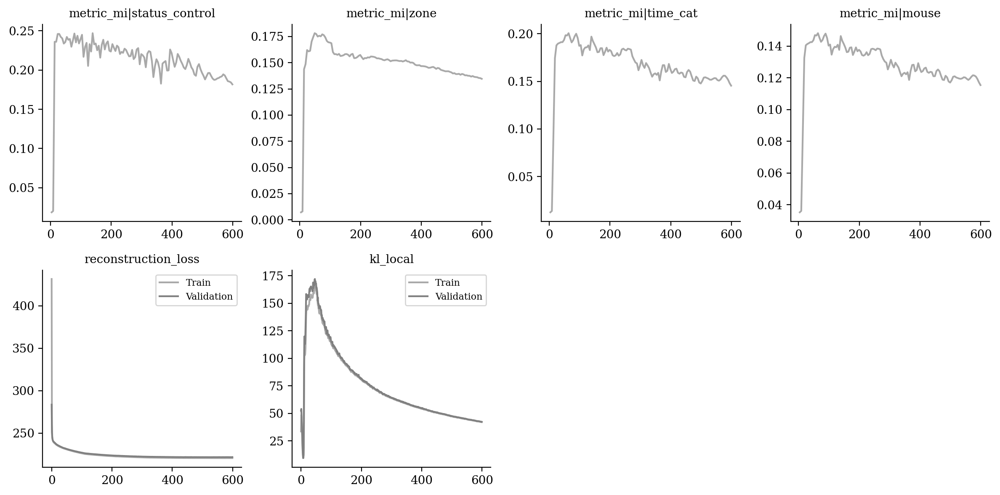

In [15]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [16]:
from tardis._disentanglementmanager import DisentanglementManager as DM

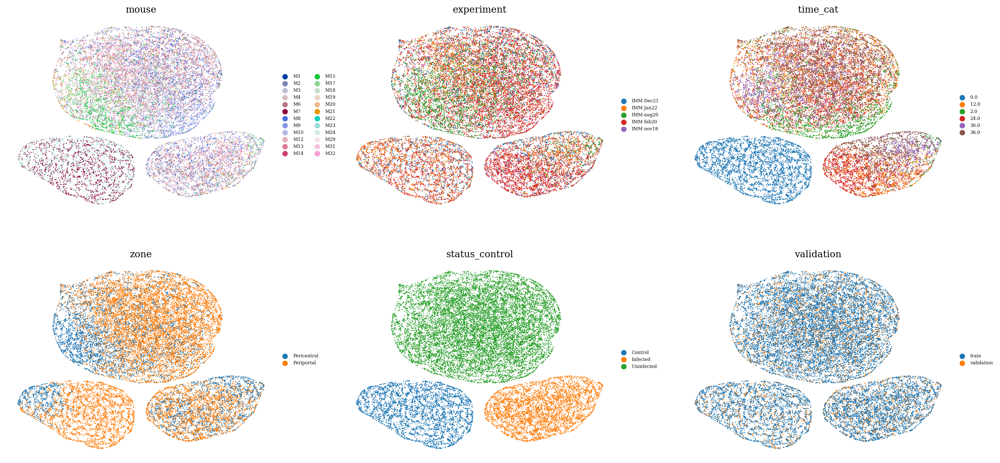

In [17]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

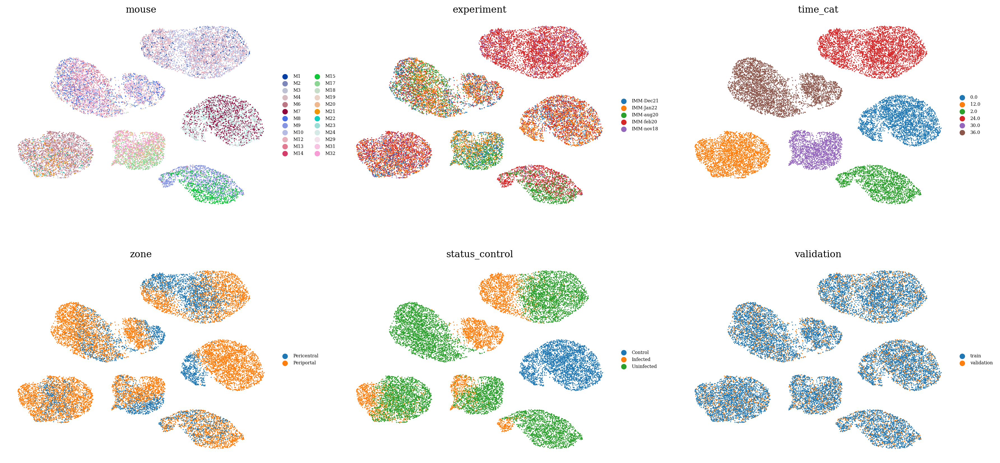

In [18]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

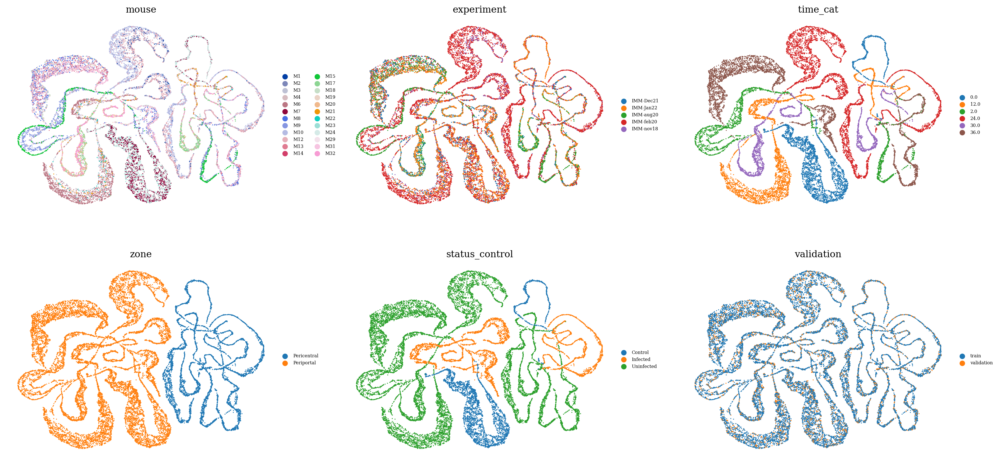

In [19]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

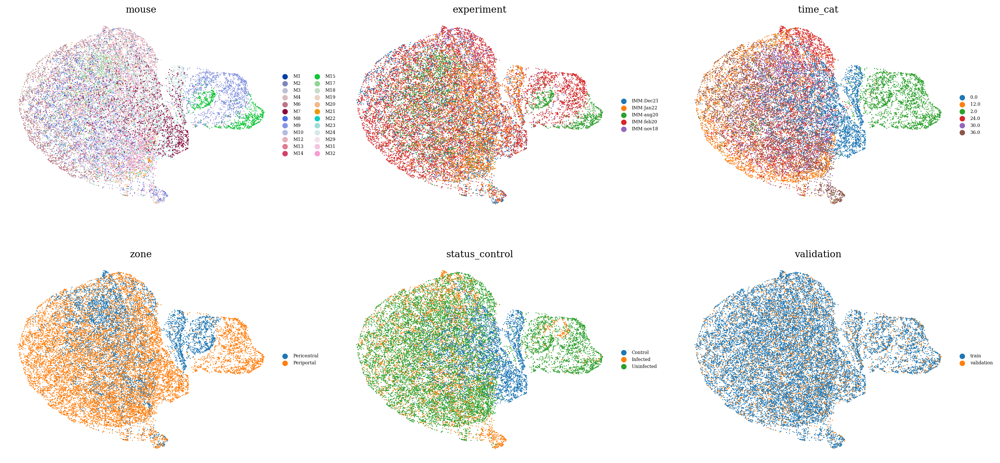

In [20]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

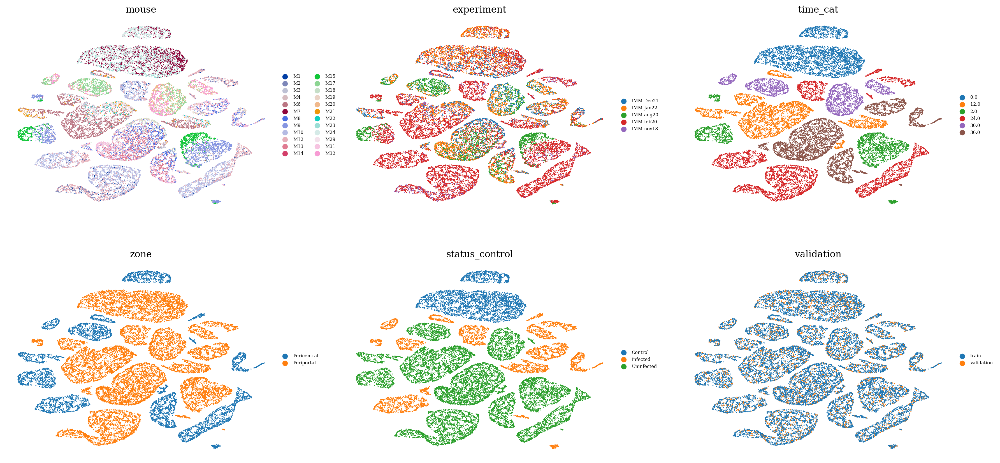

In [21]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [22]:
data = vae.get_latent_representation()

import sklearn
factors_indices = sorted([[indice, config.obs_key] for config in DM.configurations.items for indice in config.reserved_latent_indices])
factors = np.vstack([sklearn.preprocessing.LabelEncoder().fit_transform(
    adata.obs[j].copy().astype(str).values.flatten()
) for i, j in factors_indices]).T

data = data[:, [i for i, j in factors_indices]]

maxMIG = vae.get_MI_precalculated(data=data, factors=factors, variation="maxMIG", discretization_bins=256)
maxMIG_mean = np.mean(maxMIG)
maxMIG_mean

0.7717735640821894

In [23]:
data = vae.get_latent_representation()

import sklearn
factors_indices = sorted([[indice, config.obs_key] for config in DM.configurations.items for indice in config.reserved_latent_indices])
factors = np.vstack([sklearn.preprocessing.LabelEncoder().fit_transform(
    adata.obs[j].copy().astype(str).values.flatten()
) for i, j in factors_indices]).T

data = data[:, [i for i, j in factors_indices]]

maxMIG = vae.get_MI_precalculated(data=data[vae.validation_indices, :], factors=factors[vae.validation_indices, :], variation="maxMIG", discretization_bins=256)
maxMIG_mean = np.mean(maxMIG)
maxMIG_mean

0.7278768846911645

In [24]:
vae.get_MI_normalized_training("zone")

{('validation', 'reserved'): 0.9955842576025941,
 ('validation', 'unreserved'): 0.14028573296435926,
 ('train', 'reserved'): 0.995781946056861,
 ('train', 'unreserved'): 0.09746972844739615}

In [25]:
vae.get_MI_normalized_training("status_control")

{('validation', 'reserved'): 0.9957575931440119,
 ('validation', 'unreserved'): 0.3038143938298442,
 ('train', 'reserved'): 0.9946637297162539,
 ('train', 'unreserved'): 0.25680174757853125}

In [26]:
vae.get_MI_normalized_training("time_cat")

{('validation', 'reserved'): 0.9374295078447503,
 ('validation', 'unreserved'): 0.275218847952417,
 ('train', 'reserved'): 0.933610790742907,
 ('train', 'unreserved'): 0.2047092815711073}